In [1]:
import pandas as pd
import numpy as np
import seaborn
import matplotlib
import statistics
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA
from sklearn.manifold import TSNE
from sklearn.manifold import MDS
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import math
import glob
from itertools import combinations
from matplotlib import pyplot as plt
from Bio import Phylo
import biotite

# Documentation 


We got CNV data from 3 softwares; CNVnator, QDNASeq and WiseCondor for the 279 samples of Simmons diversity project.
    
The 279 files of CNVs from CNVnator were merged with this command: 
```
!awk 'BEGIN{OFS="\t"} {print FILENAME,$0}' * > CNVnator_results.txt ```

in /branchinecta/jbazanwilliamson/CNVnator directory 


Telomeres and centromeres coordinates were extracted in Genome Table Browser

Gene anotation was extracted in Genome Table Browser(GENECODE V39/KnownGene)

In [2]:
anotation = pd.read_csv('/branchinecta/jbazanwilliamson/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=1)
telomeres = pd.read_table('/branchinecta/jbazanwilliamson/telomere_hg38')
centromeres = pd.read_table('/branchinecta/jbazanwilliamson/centromeres_hg38')
hm3_cnv_data = pd.read_table('/branchinecta/jbazanwilliamson/hm3_cnv_submission.txt')
header_list = ['SAMPLE_NAME','TYPE', 'POSITION', 'LENGHT', 'RD', 'T-TEST-EVAL', 'GAUSSIAN-EVAL', 'T-TEST-EVAL(MIDDLE)','GAUSSIAN-EVAL(MIDDLE)', 'FRAQ-READ-QUALITY' ]
cnvnator_data = pd.read_table('/branchinecta/jbazanwilliamson/CNVnator/CNVnator_results.txt', names=header_list)

telomeres['chrom'] = telomeres['chrom'].str.replace('chr', '')


centromeres['chrom'] = centromeres['chrom'].str.replace('chr', '')

#Table browser is 0-based coordinates, changed to 1-based for compability with CNV data
telomeres['chromStart'] = telomeres['chromStart'] + 1

centromeres['chromStart'] = centromeres['chromStart'] + 1

hm3_cnv_data['chr'] = hm3_cnv_data['chr'].astype(str)

black_header = ['chr','start', 'end', 'type']
blacklist = pd.read_table('/branchinecta/jbazanwilliamson/bin_anotation/hg19-blacklist.v2.bed', names=black_header)
blacklist['chr'] = blacklist['chr'].str.replace('chr', '')


genes_anotation = pd.read_table('/branchinecta/jbazanwilliamson/Genes_coordinates.txt')

genes_anotation = genes_anotation[genes_anotation['transcriptClass']=='coding']

cnvnator_data

,SAMPLE_NAME,TYPE,POSITION,LENGHT,RD,T-TEST-EVAL,GAUSSIAN-EVAL,T-TEST-EVAL(MIDDLE),GAUSSIAN-EVAL(MIDDLE),FRAQ-READ-QUALITY
0,LP6005441-DNA_A01,deletion,1:1-10000,10000.0,0.000000,1.593730e-11,0.000000e+00,1.992160e-11,0.000000e+00,-1
1,LP6005441-DNA_A01,duplication,1:11601-18400,6800.0,1.885520,0.000000e+00,2.870330e+09,1.644770e-04,2.870520e+09,1
2,LP6005441-DNA_A01,deletion,1:39901-48200,8300.0,0.491248,1.920150e-11,1.170970e+04,2.529720e-11,2.329250e+05,1
3,LP6005441-DNA_A01,deletion,1:49001-49700,700.0,0.440000,1.171230e+02,1.951650e-05,1.000000e+00,1.000000e+00,1
4,LP6005441-DNA_A01,deletion,1:51201-64200,13000.0,0.269762,1.225940e-11,7.811940e+03,1.448840e-11,5.609900e+04,1
...,...,...,...,...,...,...,...,...,...,...
2652100,SS6004480,duplication,hs37d5:35449101-35452500,3400.0,6.142330,1.571380e-02,8.098350e-02,2.307510e+01,1.300360e+05,1
2652101,SS6004480,duplication,hs37d5:35453501-35458700,5200.0,5.218620,6.135840e-08,1.654080e+09,1.479150e-03,2.411220e-98,1
2652102,SS6004480,deletion,hs37d5:35459001-35460200,1200.0,0.370035,2.871320e-01,3.368600e-05,1.000000e+00,1.000000e+00,1
2652103,SS6004480,deletion,hs37d5:35463501-35464600,1100.0,0.507767,8.729140e-01,4.879000e-04,1.000000e+00,1.000000e+00,1


count    2.652105e+06
mean     2.939306e+08
std      8.295812e+08
min      0.000000e+00
25%      2.880620e-14
50%      4.036780e-05
75%      4.550540e-02
max      2.871000e+09
Name: GAUSSIAN-EVAL, dtype: float64

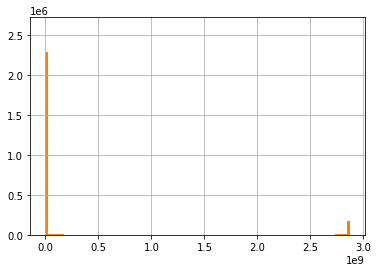

In [20]:
cnvnator_data['RD'].hist(bins=100)
cnvnator_data['GAUSSIAN-EVAL'].hist(bins=100)
cnvnator_data['GAUSSIAN-EVAL'].describe()

## Filtration


In [3]:
#FILTRATION BY SIGNIFICANCE 

cnvnator_data = cnvnator_data[cnvnator_data['T-TEST-EVAL'] <= 0.05]
cnvnator_data = cnvnator_data[cnvnator_data['T-TEST-EVAL(MIDDLE)'] <= 0.05]

cnvnator_data = cnvnator_data[cnvnator_data['LENGHT'] > 1000]
cnvnator_data = cnvnator_data.loc[(cnvnator_data['LENGHT'] < 10000000),:]

#cnvnator_data = cnvnator_data[cnvnator_data['RD'] <= 0.05]

##GAUSIAN DISTRIBUTION
deletion = cnvnator_data[cnvnator_data['GAUSSIAN-EVAL'] < 0.0003]
duplicatons = cnvnator_data[cnvnator_data['GAUSSIAN-EVAL'] > 4.550540e+04]


cnvnator_data = pd.concat([deletion,duplicatons]) #483883
cnvnator_data
#25%      4.423290e-47
#50%      1.778405e-08
#75%      7.521495e+07
#cnvnator_data  #876261 


,SAMPLE_NAME,TYPE,POSITION,LENGHT,RD,T-TEST-EVAL,GAUSSIAN-EVAL,T-TEST-EVAL(MIDDLE),GAUSSIAN-EVAL(MIDDLE),FRAQ-READ-QUALITY
0,LP6005441-DNA_A01,deletion,1:1-10000,10000.0,0.000000,1.593730e-11,0.000000e+00,1.992160e-11,0.000000e+00,-1
15,LP6005441-DNA_A01,deletion,1:176201-227500,51300.0,0.012845,3.106680e-12,2.571640e-94,3.232710e-12,0.000000e+00,1
16,LP6005441-DNA_A01,duplication,1:231001-237900,6900.0,2.089230,0.000000e+00,5.215800e-35,0.000000e+00,2.487640e-22,1
17,LP6005441-DNA_A01,deletion,1:267401-318400,51000.0,0.011302,3.124950e-12,2.030790e-304,3.252500e-12,0.000000e+00,1
66,LP6005441-DNA_A01,deletion,1:2634001-2684300,50300.0,0.002693,3.168440e-12,0.000000e+00,3.299640e-12,0.000000e+00,1
...,...,...,...,...,...,...,...,...,...,...
2652076,SS6004480,duplication,hs37d5:35302501-35308100,5600.0,3.229580,0.000000e+00,1.228800e+09,7.873890e-07,1.663820e+09,1
2652077,SS6004480,duplication,hs37d5:35309701-35321200,11500.0,7.691870,7.760750e-10,2.858280e+09,1.095140e-06,2.860490e+09,1
2652086,SS6004480,duplication,hs37d5:35390501-35396000,5500.0,6.348100,4.936490e-06,2.550340e+09,1.119870e-04,6.388410e-04,1
2652091,SS6004480,duplication,hs37d5:35411501-35418800,7300.0,3.931610,9.809490e-07,2.001450e+09,1.368200e-07,2.209390e+09,1


In [7]:
#SEPARATE COORDINATES
coordinates = cnvnator_data['POSITION'].str.split(':', expand=True)
CHROMOSOME = coordinates[0]

split_position = coordinates[1].str.split('-', expand=True)
START = split_position[0]
STOP = split_position[1]

cnvnator_style= pd.DataFrame()
cnvnator_style['Sample_ID'] = cnvnator_data['SAMPLE_NAME']
cnvnator_style['Chr'] = CHROMOSOME
cnvnator_style['Start'] = START
cnvnator_style['End'] = STOP
cnvnator_style['CNV_value'] = cnvnator_data['TYPE']

cnvnator_style['CNV_value'].replace('deletion', 1, inplace=True)
cnvnator_style['CNV_value'].replace('duplication', 3, inplace=True)
cnvnator_style
cnvnator_style['Start'] = cnvnator_style['Start'].astype(int)
cnvnator_style['End'] = cnvnator_style['End'].astype(int)
cnvnator_style['CNV_value'] = cnvnator_style['CNV_value'].astype(float)

cnvnator_style['Type'] = cnvnator_data['TYPE']

cnvnator_style['RD'] = cnvnator_data['RD']
cnvnator_style['LENGHT'] = cnvnator_data['LENGHT']
cnvnator_style['T-TEST-EVAL'] = cnvnator_data['T-TEST-EVAL']
cnvnator_style['GAUSSIAN-EVAL'] = cnvnator_data['GAUSSIAN-EVAL']
cnvnator_style

# NOTE: 
# This result were used as output for CNVR detection for CNVnator
cnvnator_style.value_counts("Sample_ID")

Sample_ID
LP6005592-DNA_G03    77244
LP6005442-DNA_E04    16816
LP6005443-DNA_E10    13319
LP6005443-DNA_F10     6243
LP6005442-DNA_B04     3715
                     ...  
LP6005441-DNA_H06     2256
LP6005442-DNA_H09     2248
LP6005441-DNA_H10     2244
LP6005442-DNA_B01     2230
LP6005441-DNA_B12     2217
Length: 279, dtype: int64

In [8]:
#REMOVE SAMPLES WITH ABERRATIONS
samples_with_aberrations = ['LP6005441-DNA_B03', ' LP6005443-DNA_G01', 'LP6005441-DNA_G09', 'LP6005441-DNA_D04'] 

cnvnator_style = cnvnator_style[~cnvnator_style.Sample_ID.isin(samples_with_aberrations)]

cnvnator_style = cnvnator_style
cnvnator_style.value_counts("Sample_ID")

Sample_ID
LP6005592-DNA_G03    77244
LP6005442-DNA_E04    16816
LP6005443-DNA_E10    13319
LP6005443-DNA_F10     6243
LP6005442-DNA_B04     3715
                     ...  
LP6005441-DNA_H06     2256
LP6005442-DNA_H09     2248
LP6005441-DNA_H10     2244
LP6005442-DNA_B01     2230
LP6005441-DNA_B12     2217
Length: 276, dtype: int64

In [9]:
## Filter by chromosomes
cnvnator_data_df_x = cnvnator_style[cnvnator_style.Chr == 'X']
cnvnator_data_df_no_sex_chr = cnvnator_style[cnvnator_style.Chr != 'Y']
cnvnator_data_df_no_sex_chr = cnvnator_style[cnvnator_style.Chr != 'X']

cnvnator_data_df_x


,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
5612,LP6005441-DNA_A01,X,1,60000,1.0,deletion,0.000000,60000.0,2.656210e-12,0.000000e+00
5614,LP6005441-DNA_A01,X,65501,144900,1.0,deletion,0.050844,79400.0,2.007210e-12,3.474740e-28
5619,LP6005441-DNA_A01,X,231401,281400,1.0,deletion,0.000000,50000.0,3.187450e-12,0.000000e+00
5622,LP6005441-DNA_A01,X,290301,300100,3.0,duplication,1.734790,9800.0,0.000000e+00,1.569560e-14
5625,LP6005441-DNA_A01,X,306901,375000,3.0,duplication,1.944110,68100.0,0.000000e+00,2.568300e-29
...,...,...,...,...,...,...,...,...,...,...
2650081,SS6004480,X,149082001,149085600,3.0,duplication,2.111190,3600.0,1.514040e-08,1.388880e+05
2650091,SS6004480,X,152245401,152347900,1.0,deletion,0.256747,102500.0,1.554850e-12,1.667090e+09
2650102,SS6004480,X,153474401,153496200,3.0,duplication,1.734000,21800.0,0.000000e+00,2.123580e+09
2650103,SS6004480,X,153498901,153518500,3.0,duplication,1.886020,19600.0,0.000000e+00,2.117350e+07


In [15]:
# Filter inviduals that have less than 100 CNVs
cnvnator_style.groupby('Sample_ID').filter(lambda x : (x['Sample_ID'].count()<=3000).any())

,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
15,LP6005441-DNA_A01,1,176201,227500,1.0,deletion,0.012845,51300.0,3.106680e-12,2.571640e-94
16,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
17,LP6005441-DNA_A01,1,267401,318400,1.0,deletion,0.011302,51000.0,3.124950e-12,2.030790e-304
66,LP6005441-DNA_A01,1,2634001,2684300,1.0,deletion,0.002693,50300.0,3.168440e-12,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...
2652076,SS6004480,hs37d5,35302501,35308100,3.0,duplication,3.229580,5600.0,0.000000e+00,1.228800e+09
2652077,SS6004480,hs37d5,35309701,35321200,3.0,duplication,7.691870,11500.0,7.760750e-10,2.858280e+09
2652086,SS6004480,hs37d5,35390501,35396000,3.0,duplication,6.348100,5500.0,4.936490e-06,2.550340e+09
2652091,SS6004480,hs37d5,35411501,35418800,3.0,duplication,3.931610,7300.0,9.809490e-07,2.001450e+09


In [17]:
cnvnator_style.to_numpy()

array([['LP6005441-DNA_A01', '1', 1, ..., 10000.0, 1.59373e-11, 0.0],
       ['LP6005441-DNA_A01', '1', 176201, ..., 51300.0, 3.10668e-12,
        2.571639999999999e-94],
       ['LP6005441-DNA_A01', '1', 231001, ..., 6900.0, 0.0, 5.2158e-35],
       ...,
       ['SS6004480', 'hs37d5', 35390501, ..., 5500.0, 4.93649e-06,
        2550340000.0],
       ['SS6004480', 'hs37d5', 35411501, ..., 7300.0,
        9.809489999999999e-07, 2001450000.0],
       ['SS6004480', 'hs37d5', 35453501, ..., 5200.0, 6.13584e-08,
        1654080000.0]], dtype=object)

<h2> Removing blacklist regions 

In [42]:
cnvnator_style_np = cnvnator_style.to_numpy()
wobl_1= []

for black in blacklist.to_numpy():
    for cnv in cnvnator_style_np:
    
        if cnv[1] == black[0]: #Chromosome
            if cnv[2] <= black[1]+1 <= cnv[3] or cnv[2] <= black[1]+1 <= cnv[3]:
            #if black[1] <= cnv[2] <= black[2] or black[1] <= cnv[3] <= black[2]:
                wobl_1.append(cnv)
                
         #   if black[1] <= cnv[3] <= black[2]:
         #       wobl_1.append(cnv)
         

In [53]:
cnvnator_style

,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
15,LP6005441-DNA_A01,1,176201,227500,1.0,deletion,0.012845,51300.0,3.106680e-12,2.571640e-94
16,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
17,LP6005441-DNA_A01,1,267401,318400,1.0,deletion,0.011302,51000.0,3.124950e-12,2.030790e-304
66,LP6005441-DNA_A01,1,2634001,2684300,1.0,deletion,0.002693,50300.0,3.168440e-12,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...
2652076,SS6004480,hs37d5,35302501,35308100,3.0,duplication,3.229580,5600.0,0.000000e+00,1.228800e+09
2652077,SS6004480,hs37d5,35309701,35321200,3.0,duplication,7.691870,11500.0,7.760750e-10,2.858280e+09
2652086,SS6004480,hs37d5,35390501,35396000,3.0,duplication,6.348100,5500.0,4.936490e-06,2.550340e+09
2652091,SS6004480,hs37d5,35411501,35418800,3.0,duplication,3.931610,7300.0,9.809490e-07,2.001450e+09


In [54]:
blacklist_data = pd.DataFrame(wobl_1)
result = blacklist_data

result.columns =['Sample_ID','Chr','Start','End','CNV_value','Type','RD','LENGHT','T-TEST-EVAL','GAUSSIAN-EVAL']
result = result.drop_duplicates()
#result


df = pd.concat([result, cnvnator_style])
df = df.drop_duplicates(keep=False)
df
#chromosomes= ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','X','Y']

#df = df[df.Chr.isin(chromosomes)]

#df['Start'] = df['Start'].astype(int)
#df['End'] = df['End'].astype(int)
#df['CNV_value'] = df['CNV_value'].astype(float)

#df.to_csv("cnvator_data_no_telo_no_centro.csv",  index= False)
#cnvnator_df = df
#cnvnator_df

,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
15,LP6005441-DNA_A01,1,176201,227500,1.0,deletion,0.012845,51300.0,3.106680e-12,2.571640e-94
16,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
17,LP6005441-DNA_A01,1,267401,318400,1.0,deletion,0.011302,51000.0,3.124950e-12,2.030790e-304
66,LP6005441-DNA_A01,1,2634001,2684300,1.0,deletion,0.002693,50300.0,3.168440e-12,0.000000e+00
72,LP6005441-DNA_A01,1,3845301,3995300,1.0,deletion,0.000018,150000.0,1.062480e-12,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...
2652076,SS6004480,hs37d5,35302501,35308100,3.0,duplication,3.229580,5600.0,0.000000e+00,1.228800e+09
2652077,SS6004480,hs37d5,35309701,35321200,3.0,duplication,7.691870,11500.0,7.760750e-10,2.858280e+09
2652086,SS6004480,hs37d5,35390501,35396000,3.0,duplication,6.348100,5500.0,4.936490e-06,2.550340e+09
2652091,SS6004480,hs37d5,35411501,35418800,3.0,duplication,3.931610,7300.0,9.809490e-07,2.001450e+09


count    6.691400e+05
mean     9.256026e+08
std      1.268447e+09
min      0.000000e+00
25%      9.159067e-65
50%      2.502185e-16
75%      2.736720e+09
max      2.871000e+09
Name: GAUSSIAN-EVAL, dtype: float64

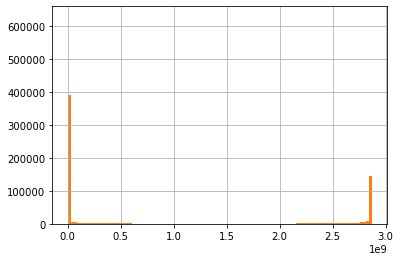

In [55]:
df['RD'].hist(bins=100)
df['GAUSSIAN-EVAL'].hist(bins=100)
df['GAUSSIAN-EVAL'].describe()

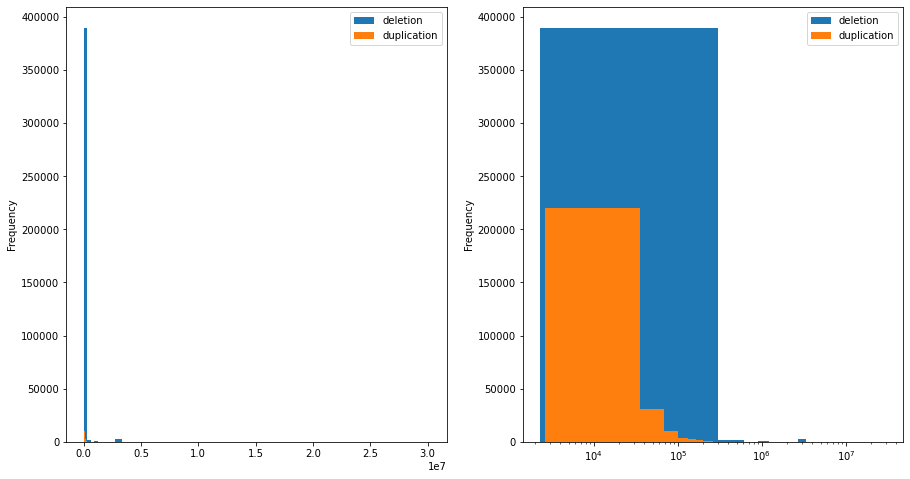

In [56]:
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

df_plot= df.groupby(['Type'])['LENGHT']

df_plot.plot(kind='hist',stacked=True, bins=100, legend=True, ax=axs[0]) # alpha for transparency

plt.xscale('log')
#plt.show()

df_plot = df.groupby(['Type'])['LENGHT']

df_plot.plot(kind='hist',stacked=True, bins=100, legend=True, ax=axs[1]) # alpha for transparency

plt.show()

In [57]:
cnvnator_df
samples = cnvnator_df.loc[cnvnator_df['Sample_ID'] == "LP6005442-DNA_B01"]
samples.loc[samples['Chr']== '4']

,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
749740,LP6005442-DNA_B01,4,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
749750,LP6005442-DNA_B01,4,1423101,1478600,1.0,deletion,0.000094,55500.0,2.871580e-12,0.000000e+00
749763,LP6005442-DNA_B01,4,3572901,3576500,3.0,duplication,1.923240,3600.0,0.000000e+00,8.474580e-63
749766,LP6005442-DNA_B01,4,4014901,4021200,3.0,duplication,1.545250,6300.0,0.000000e+00,4.223270e-23
749768,LP6005442-DNA_B01,4,4121901,4153000,1.0,deletion,0.522236,31100.0,5.124520e-12,8.619520e-46
749782,LP6005442-DNA_B01,4,8799201,8818200,1.0,deletion,0.000000,19000.0,8.388030e-12,0.000000e+00
749786,LP6005442-DNA_B01,4,9274401,9324700,1.0,deletion,0.002836,50300.0,3.168440e-12,0.000000e+00
749792,LP6005442-DNA_B01,4,9457201,9481800,1.0,deletion,0.480540,24600.0,6.478560e-12,5.547340e-136
749794,LP6005442-DNA_B01,4,10211301,10234500,1.0,deletion,0.000570,23200.0,6.869500e-12,0.000000e+00
749814,LP6005442-DNA_B01,4,31820601,31837400,1.0,deletion,0.007100,16800.0,9.486460e-12,0.000000e+00


In [58]:
df

,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
15,LP6005441-DNA_A01,1,176201,227500,1.0,deletion,0.012845,51300.0,3.106680e-12,2.571640e-94
16,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
17,LP6005441-DNA_A01,1,267401,318400,1.0,deletion,0.011302,51000.0,3.124950e-12,2.030790e-304
66,LP6005441-DNA_A01,1,2634001,2684300,1.0,deletion,0.002693,50300.0,3.168440e-12,0.000000e+00
72,LP6005441-DNA_A01,1,3845301,3995300,1.0,deletion,0.000018,150000.0,1.062480e-12,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...
2652076,SS6004480,hs37d5,35302501,35308100,3.0,duplication,3.229580,5600.0,0.000000e+00,1.228800e+09
2652077,SS6004480,hs37d5,35309701,35321200,3.0,duplication,7.691870,11500.0,7.760750e-10,2.858280e+09
2652086,SS6004480,hs37d5,35390501,35396000,3.0,duplication,6.348100,5500.0,4.936490e-06,2.550340e+09
2652091,SS6004480,hs37d5,35411501,35418800,3.0,duplication,3.931610,7300.0,9.809490e-07,2.001450e+09


In [59]:
df = pd.DataFrame(df)
samples = df.loc[df['Sample_ID'] == "LP6005442-DNA_B01"]
samples.loc[samples['Chr']== '4']

,Sample_ID,Chr,Start,End,CNV_value,Type,RD,LENGHT,T-TEST-EVAL,GAUSSIAN-EVAL
749750,LP6005442-DNA_B01,4,1423101,1478600,1.0,deletion,0.000094,55500.0,2.871580e-12,0.000000e+00
749763,LP6005442-DNA_B01,4,3572901,3576500,3.0,duplication,1.923240,3600.0,0.000000e+00,8.474580e-63
749766,LP6005442-DNA_B01,4,4014901,4021200,3.0,duplication,1.545250,6300.0,0.000000e+00,4.223270e-23
749768,LP6005442-DNA_B01,4,4121901,4153000,1.0,deletion,0.522236,31100.0,5.124520e-12,8.619520e-46
749782,LP6005442-DNA_B01,4,8799201,8818200,1.0,deletion,0.000000,19000.0,8.388030e-12,0.000000e+00
749786,LP6005442-DNA_B01,4,9274401,9324700,1.0,deletion,0.002836,50300.0,3.168440e-12,0.000000e+00
749792,LP6005442-DNA_B01,4,9457201,9481800,1.0,deletion,0.480540,24600.0,6.478560e-12,5.547340e-136
749794,LP6005442-DNA_B01,4,10211301,10234500,1.0,deletion,0.000570,23200.0,6.869500e-12,0.000000e+00
749814,LP6005442-DNA_B01,4,31820601,31837400,1.0,deletion,0.007100,16800.0,9.486460e-12,0.000000e+00
749825,LP6005442-DNA_B01,4,42762701,42769600,1.0,deletion,0.504160,6900.0,2.309750e-11,3.562550e-58


In [64]:

archaic_data = pd.read_csv('/branchinecta/jbazanwilliamson/NIHMS1057227-CNVs.csv')
archaic_data = archaic_data.drop(columns=['name'])

header= ['Sample', 'Region', 'Country', 'Sample_ID', 'Sex']
archaic_anotation = pd.read_csv('/branchinecta/jbazanwilliamson/archaic_anotation.csv', names=header, index_col=0)


archaic_data['chr'] = archaic_data['chr'].str.replace('chr', '')
archaic_data#['MEL_Papuan_HGDP00554_F']

archaic_data

,chr,start,end,AFR_BantuSEHerero_HGDP01028_M,AFR_BantuSEHerero_HGDP01035_M,AFR_BantuKenya_HGDP01414_F,AFR_BantuKenya_HGDP01417_M,AFR_BantuSETswana_HGDP01030_M,AFR_BantuSETswana_HGDP01034_M,AFR_Biaka_HGDP00457_M,...,Pongo_abelii.SB550_Sibu,Pongo_pygmaeus.A939_Nonja,Pongo_pygmaeus.A942_Gusti,Pongo_pygmaeus.A943_Tilda,Pongo_pygmaeus.A944_Napoleon,Pongo_pygmaeus.KB4204_Dinah,Pongo_pygmaeus.KB5404_Billy,Pongo_pygmaeus.KB5405_Louis,Pongo_pygmaeus.KB5406_Doris,Pongo_pygmaeus.KB5543_Baldy
0,1,21910306,21913877,1.888806,1.792320,1.914535,2.089811,1.773701,1.746616,1.946396,...,2.000214,2.443515,2.342780,2.323487,2.213793,2.196508,2.306531,2.156038,1.680592,2.146711
1,1,101212616,101214920,1.796677,2.283776,1.795342,1.929797,2.115548,1.775132,2.063522,...,2.125240,1.723738,1.865385,1.910535,1.739420,1.818683,1.882743,1.582187,1.614118,1.628128
2,1,147384646,147386567,1.815552,1.870647,1.780691,1.993303,2.060792,2.126456,2.004728,...,1.547788,1.777191,1.931089,1.938627,1.918911,2.380795,1.918974,2.031718,1.510299,1.920623
3,1,195013533,195020996,1.677605,1.972878,2.028743,1.868154,1.910763,1.932322,1.807702,...,1.605034,2.003421,1.765287,1.646856,1.669670,1.545689,1.617531,1.531787,1.664852,1.806494
4,1,228416,267160,25.356205,26.947875,21.402028,25.119371,33.538046,26.208535,27.854900,...,1.755784,1.789332,1.999602,1.819331,1.627895,1.772766,1.798521,1.943588,1.570548,1.682988
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5130,22,31678952,31682546,1.728496,2.211134,1.946489,1.892800,1.983127,1.947727,2.001814,...,2.288572,2.236208,2.583496,2.533460,2.778797,2.498968,2.355698,2.602885,2.052812,1.945058
5131,22,32112132,32113222,1.638116,2.036404,1.913307,2.125891,1.714546,1.962775,1.937903,...,1.790572,2.044620,2.087895,2.177283,2.348400,2.603020,1.916319,2.244717,1.929597,1.455610
5132,22,50252755,50261847,1.867128,2.234173,1.825974,1.964285,2.130801,2.021100,1.976070,...,2.001574,1.497870,1.326665,1.406389,1.608969,1.668828,1.414709,1.687667,1.245450,1.592275
5133,22,33050377,33056621,1.843294,1.838120,2.072788,1.971976,2.059547,1.816654,1.847665,...,1.574902,1.709750,2.229617,2.230750,2.269903,2.075718,1.832046,2.069073,1.910527,1.896251


In [65]:
counts = archaic_data.iloc[:,3:254]
#counts = counts.fillna(2)

counts

,AFR_BantuSEHerero_HGDP01028_M,AFR_BantuSEHerero_HGDP01035_M,AFR_BantuKenya_HGDP01414_F,AFR_BantuKenya_HGDP01417_M,AFR_BantuSETswana_HGDP01030_M,AFR_BantuSETswana_HGDP01034_M,AFR_Biaka_HGDP00457_M,AFR_Biaka_HGDP00461_M,AFR_Dinka_DNK7_M,AFR_Dinka_DNK11_M,...,ME_Jordanian_Jordan214_M,ME_Jordanian_Jordan445_F,ME_Jordanian_Jordan603_M,ME_Palestinian_HGDP00722_M,ME_Palestinian_HGDP00737_F,ME_Samaritan_Sam02_M,ME_YemeniteJew_4695_F,ME_YemeniteJew_5433_M,ARC_AltaiNeandertal,ARC_Denisova
0,1.888806,1.792320,1.914535,2.089811,1.773701,1.746616,1.946396,2.052415,2.125007,1.936244,...,1.783471,2.055726,1.764768,1.891779,1.852649,2.235914,1.765495,2.054844,1.898251,1.879303
1,1.796677,2.283776,1.795342,1.929797,2.115548,1.775132,2.063522,1.936851,1.673960,1.857434,...,2.484634,1.999585,2.148161,1.897159,1.841631,2.041985,1.921466,1.996447,1.949460,1.900762
2,1.815552,1.870647,1.780691,1.993303,2.060792,2.126456,2.004728,1.874035,1.792091,1.806431,...,1.823813,2.496582,2.039197,1.669957,1.817291,2.080176,1.954745,1.989904,1.041231,1.802359
3,1.677605,1.972878,2.028743,1.868154,1.910763,1.932322,1.807702,1.822615,2.040079,2.038170,...,2.046464,2.094302,1.979191,1.990923,1.762702,2.253618,1.978010,1.883789,1.912082,1.959634
4,25.356205,26.947875,21.402028,25.119371,33.538046,26.208535,27.854900,20.248009,29.113531,26.689260,...,27.728590,27.870620,25.013847,24.793868,21.417776,28.251426,23.172566,22.739744,29.332632,52.848948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5130,1.728496,2.211134,1.946489,1.892800,1.983127,1.947727,2.001814,1.811331,2.067421,2.177455,...,2.000861,2.118519,2.067270,1.946719,2.271578,2.516509,2.093259,1.861491,2.011801,1.879288
5131,1.638116,2.036404,1.913307,2.125891,1.714546,1.962775,1.937903,1.835296,2.114696,1.986543,...,2.079154,2.917065,1.708887,1.718597,1.835675,2.157292,1.877633,1.952949,1.896953,2.024583
5132,1.867128,2.234173,1.825974,1.964285,2.130801,2.021100,1.976070,1.832343,2.122988,2.215878,...,2.198863,3.423526,1.995588,1.941614,2.017628,2.294175,1.974706,2.127663,2.159226,1.868865
5133,1.843294,1.838120,2.072788,1.971976,2.059547,1.816654,1.847665,1.882356,2.047133,1.774844,...,2.086597,2.534381,1.873786,1.948459,2.013586,2.391009,1.766654,1.934066,1.948799,2.156337


In [68]:
count = counts.T
features = archaic_anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["Region", "Country"]]
features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,Region,Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
AFR_BantuKenya_HGDP01414_F,AFR,BantuKenya,-7.498339,1.461283,2.962851,5.024290,-13.757184,-9.015733,-4.910009,-1.563761,-4.102365,-6.405438
AFR_BantuKenya_HGDP01417_M,AFR,BantuKenya,-0.928159,-1.722289,2.057461,11.875747,-13.720305,-12.449084,-2.974944,0.469065,-2.446309,-4.025363
AFR_BantuSEHerero_HGDP01028_M,AFR,BantuSEHerero,-1.087009,0.077948,1.286471,7.859760,-7.998839,-21.027931,-7.229835,-12.271618,3.499658,-5.819508
AFR_BantuSEHerero_HGDP01035_M,AFR,BantuSEHerero,-8.472419,7.292167,-8.520303,9.996607,-14.567285,-15.715792,-2.040125,0.964020,-5.164002,-3.302237
AFR_BantuSETswana_HGDP01030_M,AFR,BantuSETswana,-12.681397,-0.228323,4.816776,10.404220,-28.369853,-26.558945,-5.501644,9.547214,-1.092137,-14.242576
...,...,...,...,...,...,...,...,...,...,...,...,...
SIB_Tubalar_Tuba9_F,SIB,Tubalar,130.525718,-34.697526,-21.323424,3.776933,-2.214866,8.269253,-0.535184,-11.945472,-2.186634,-7.410548
SIB_Ulchi_Ul31_F,SIB,Ulchi,-14.035371,1.338825,-0.019279,-2.751898,-6.329342,7.320582,-1.715313,-4.735087,-3.203966,1.480538
SIB_Ulchi_Ul5_F,SIB,Ulchi,-12.160394,3.446651,-4.884561,-1.650814,-8.070222,8.671211,-0.152892,-5.601698,0.065537,-5.612771
SIB_Yakut_HGDP00951_M,SIB,Yakut,-0.058880,9.586717,23.013902,79.909192,7.195724,-5.000876,104.808078,-14.425781,-8.928358,-2.234728


              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    -7.498339     1.461283     2.962851     5.024290   
AFR        BantuKenya    -0.928159    -1.722289     2.057461    11.875747   
AFR     BantuSEHerero    -1.087009     0.077948     1.286471     7.859760   
AFR     BantuSEHerero    -8.472419     7.292167    -8.520303     9.996607   
AFR     BantuSETswana   -12.681397    -0.228323     4.816776    10.404220   
...               ...          ...          ...          ...          ...   
SIB           Tubalar   130.525718   -34.697526   -21.323424     3.776933   
SIB             Ulchi   -14.035371     1.338825    -0.019279    -2.751898   
SIB             Ulchi   -12.160394     3.446651    -4.884561    -1.650814   
SIB             Yakut    -0.058880     9.586717    23.013902    79.909192   
SIB             Yakut    -5.145984    10.275043    31.025197   133.893335   

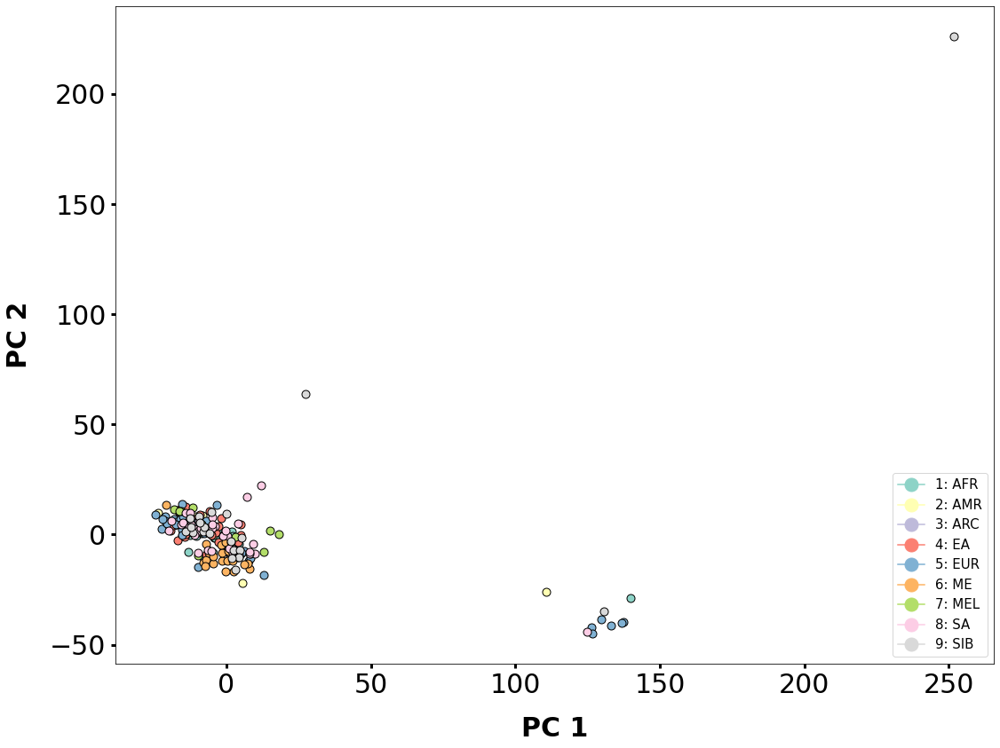

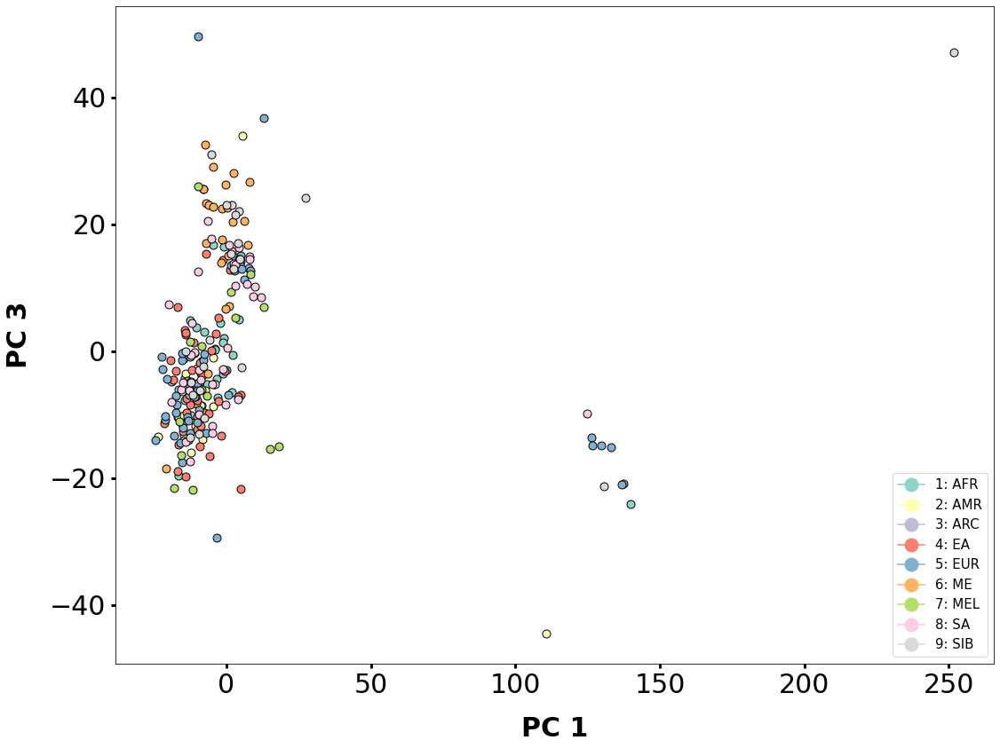

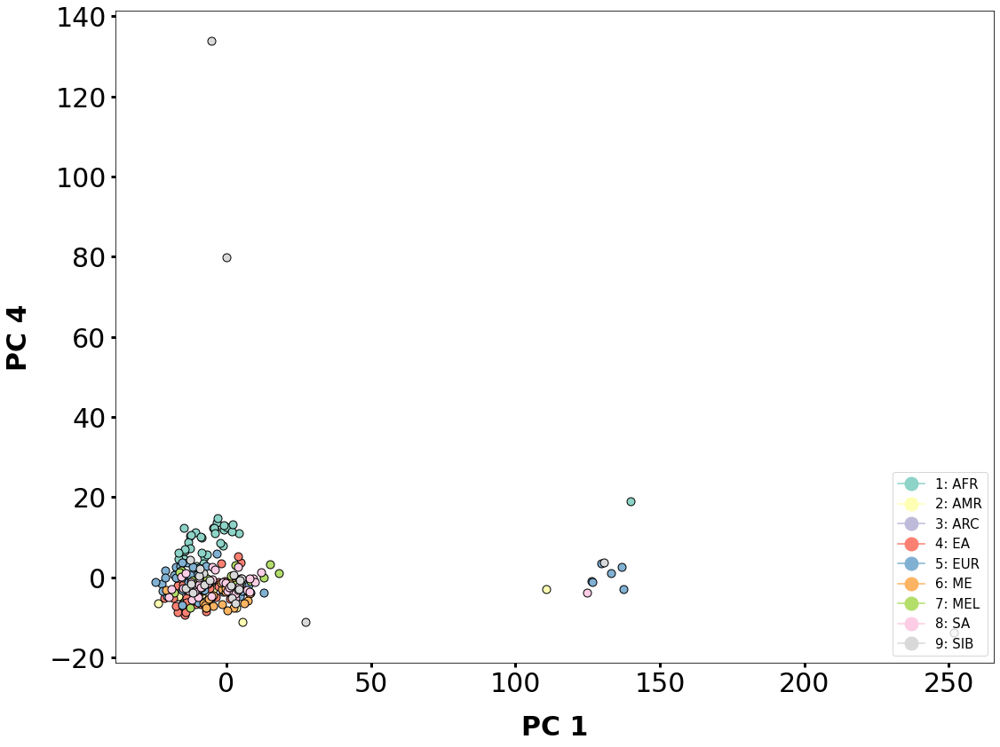

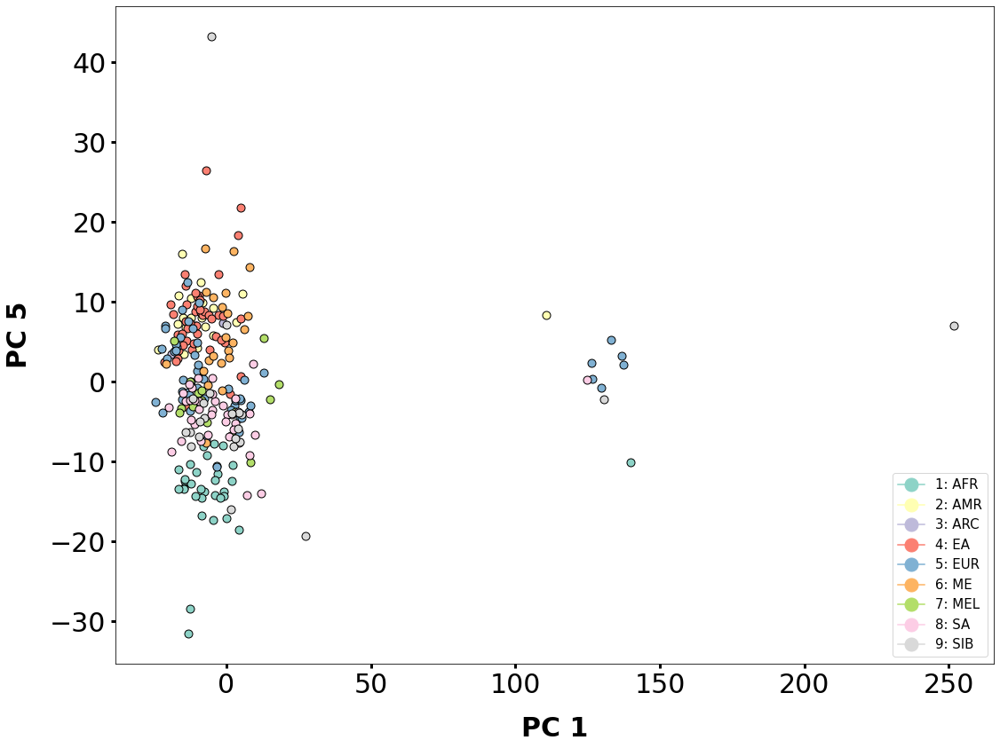

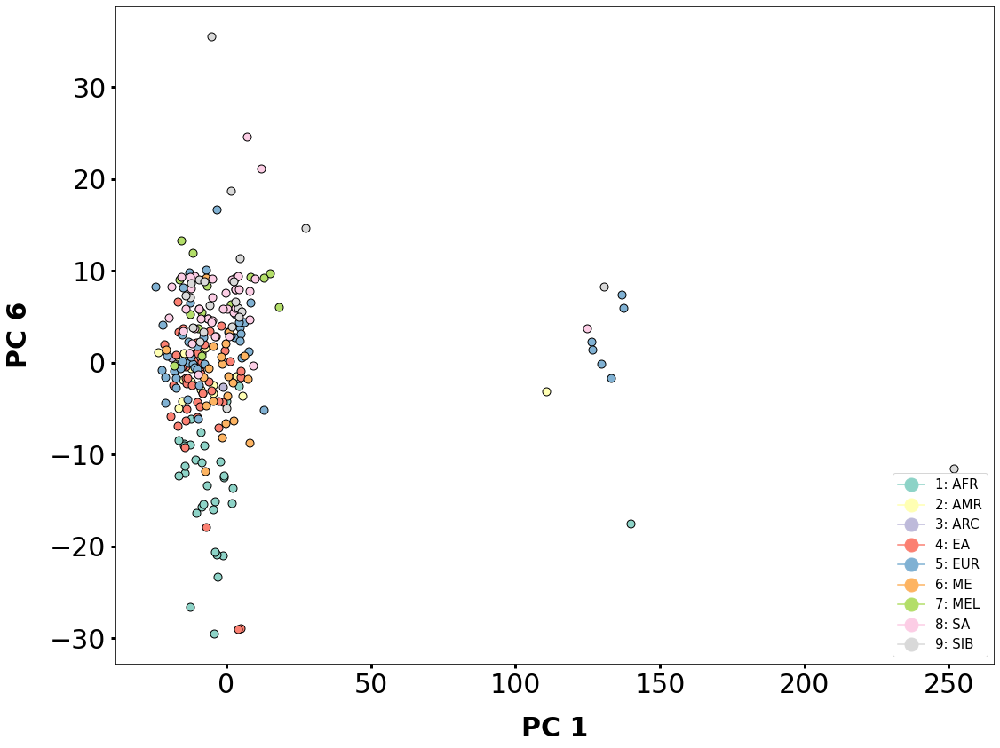

...

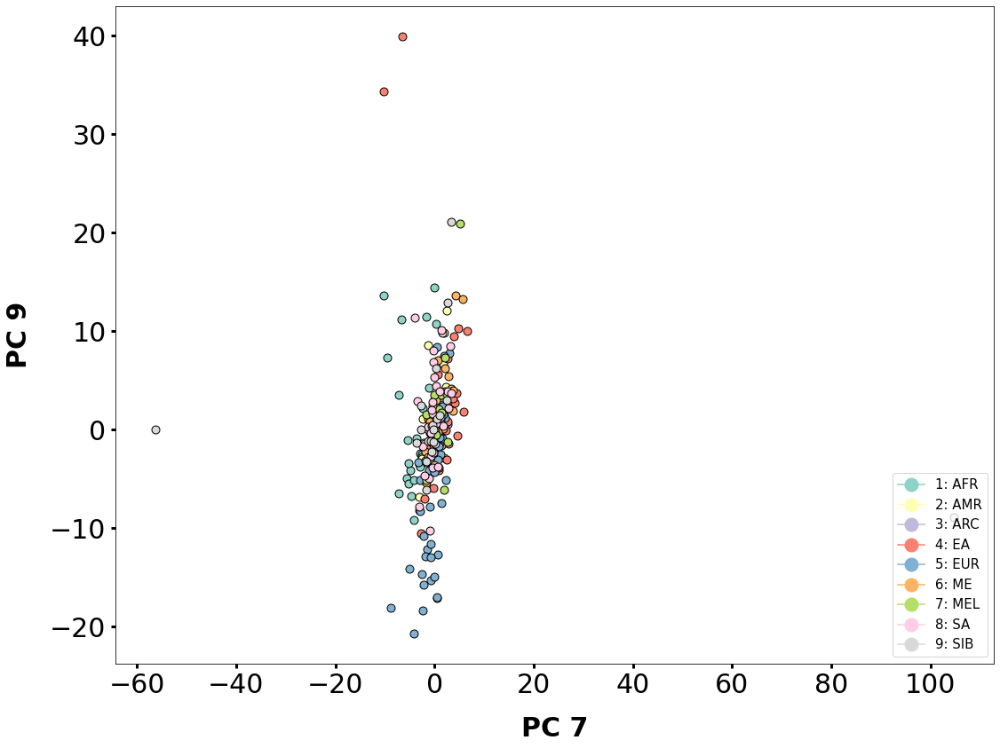

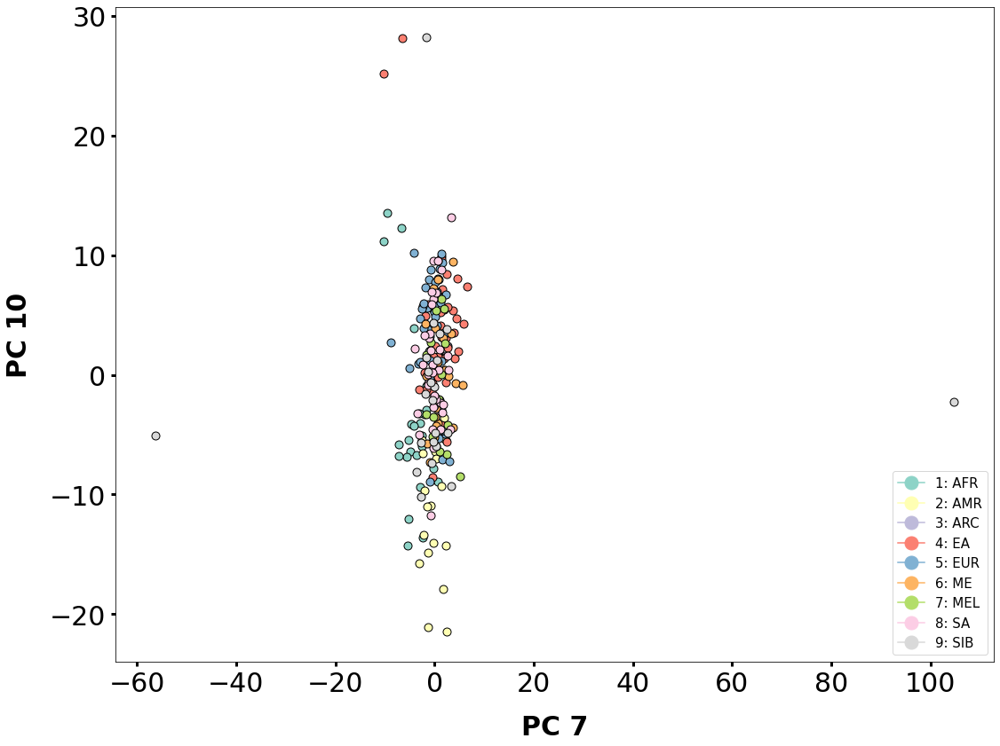

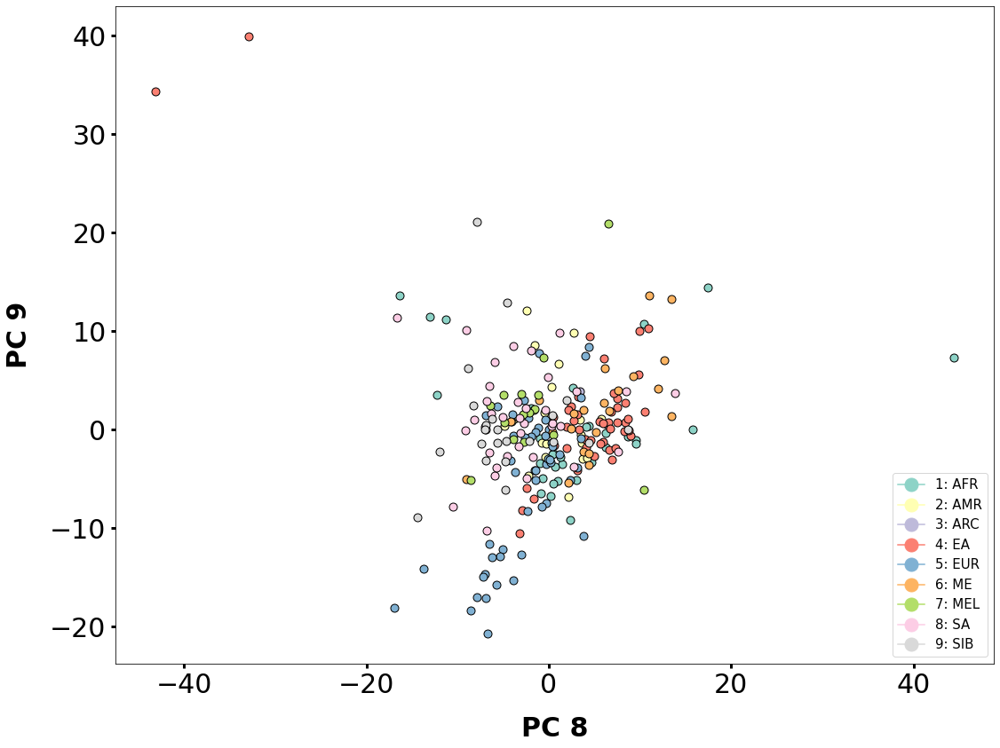

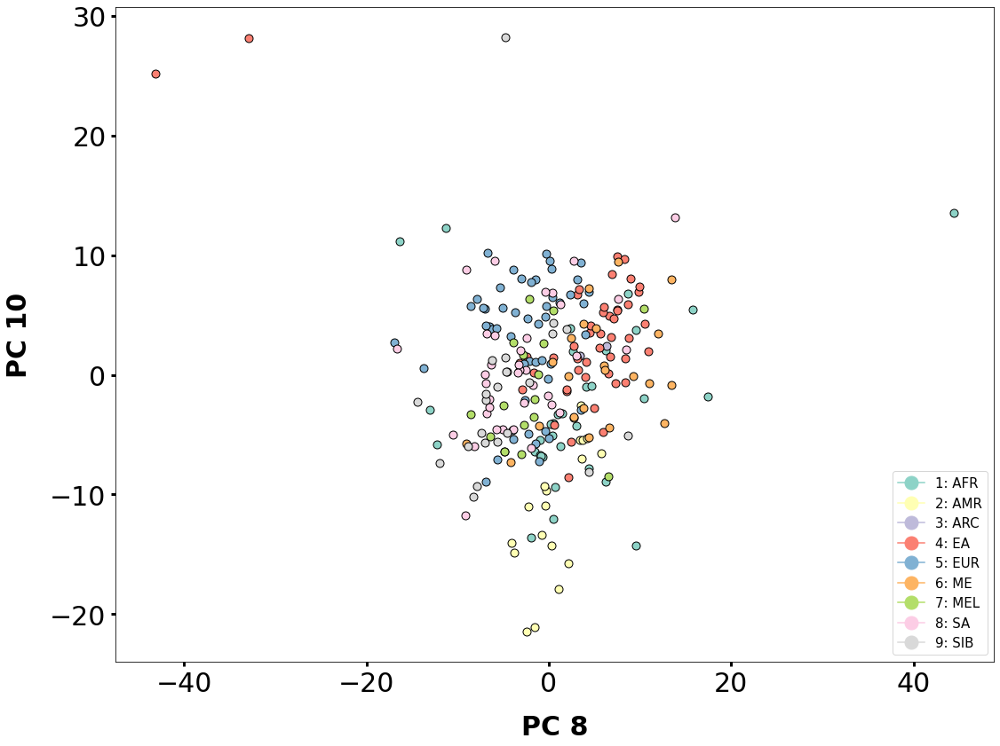

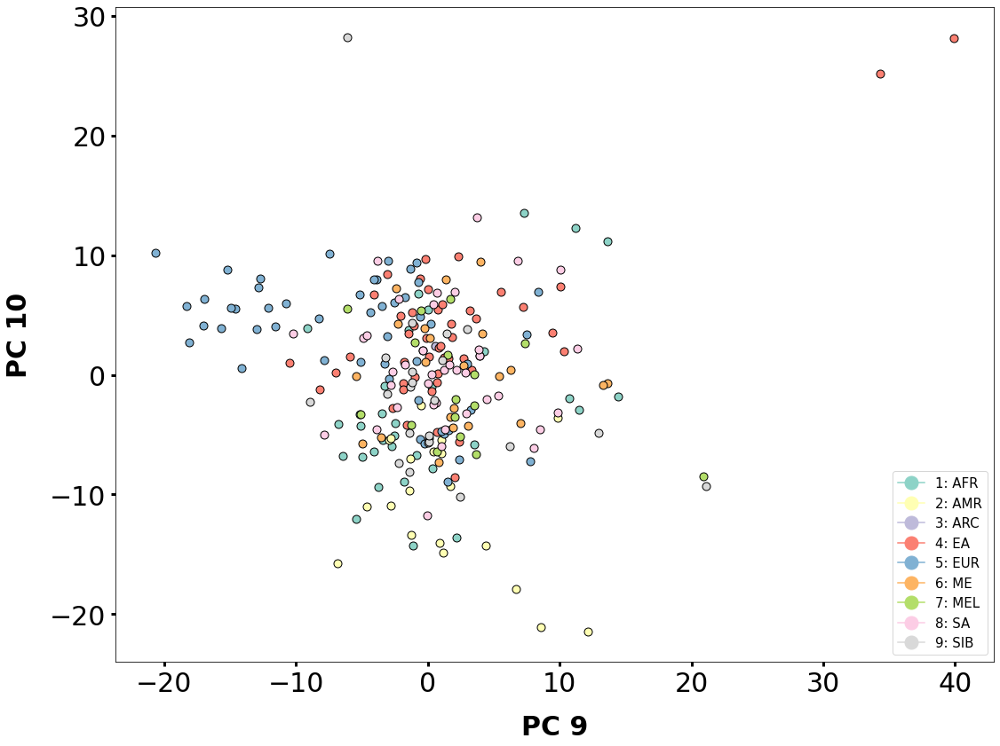

In [69]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [94]:
cnvnator_df.to_numpy()

array([['LP6005441-DNA_A01', '1', 1, ..., 10000.0, 1.59373e-11, 0.0],
       ['LP6005441-DNA_A01', '1', 176201, ..., 51300.0, 3.10668e-12,
        2.571639999999999e-94],
       ['LP6005441-DNA_A01', '1', 231001, ..., 6900.0, 0.0, 5.2158e-35],
       ...,
       ['SS6004480', 'hs37d5', 35390501, ..., 5500.0, 4.93649e-06,
        2550340000.0],
       ['SS6004480', 'hs37d5', 35411501, ..., 7300.0,
        9.809489999999999e-07, 2001450000.0],
       ['SS6004480', 'hs37d5', 35453501, ..., 5200.0, 6.13584e-08,
        1654080000.0]], dtype=object)

In [95]:
overlapped = []

cnvnator_df_np = cnvnator_df.to_numpy()
archaic_data_np = archaic_data.to_numpy()

for cnv_q in cnvnator_df_np:
    for cnv_c in archaic_data_np:
    
        if cnv_q[1] == cnv_c[0]: #Chromosome
            # QDNASEQ CNVS in SUDMANT DATA(SUDMANT bigger than  QDNASEQ)
            if (cnv_c[1] <= cnv_q[2] <= cnv_c[2]) or (cnv_c[1] <= cnv_q[3] <= cnv_c[2]):
                #leng_dqna = (cnv_q[3]-cnv_q[2])
                #leng_cnvnator = (cnv_c[2]-cnv_c[1])
                #if (leng_dqna/leng_cnvnator)>0.6:
                overlapped.append([cnv_q[0], cnv_c[0], cnv_c[1], cnv_c[2], cnv_q[4], cnv_q[5], cnv_q[6], cnv_q[7]])
                    #overlapped.append(cnv_q)
            # SUDMANT DATA CNVS in QDNASEQ CNVs(QDNASEQ bigger than SUDMANT DATA)
            
            if (cnv_q[2] <= cnv_c[1] <= cnv_q[3]) or (cnv_q[2] <= cnv_c[2] <= cnv_q[3]):
                #leng_dqna = (cnv_q[3]-cnv_q[2])
                #leng_cnvnator = (cnv_c[2]-cnv_c[1])
                #if (leng_cnvnator/leng_dqna)>0.6:
                overlapped.append([cnv_q[0], cnv_c[0], cnv_c[1], cnv_c[2], cnv_q[4], cnv_q[5], cnv_q[6], cnv_q[7]])
                    #overlapped.append([cnv_q, cnv_c])
                    #overlapped.append(cnv_q)

In [78]:
overlapped = []

cnvnator_df_np = cnvnator_df.to_numpy()
archaic_data_np = archaic_data.to_numpy()

for cnv_q in cnvnator_df_np:
    for cnv_c in archaic_data_np:
    
        if cnv_q[1] == cnv_c[0]: #Chromosome
            # QDNASEQ CNVS in SUDMANT DATA(SUDMANT bigger than  QDNASEQ)
            if (cnv_c[1] <= cnv_q[2] <= cnv_c[2]) or (cnv_c[1] <= cnv_q[3] <= cnv_c[2]):
                #leng_dqna = (cnv_q[3]-cnv_q[2])
                #leng_cnvnator = (cnv_c[2]-cnv_c[1])
                #if (leng_dqna/leng_cnvnator)>0.6:
                overlapped.append([cnv_q[0], cnv_q[1], cnv_q[2], cnv_q[3], cnv_q[4], cnv_q[5], cnv_q[6], cnv_q[7]])
                    #overlapped.append(cnv_q)
            # SUDMANT DATA CNVS in QDNASEQ CNVs(QDNASEQ bigger than SUDMANT DATA)
            
            if (cnv_q[2] <= cnv_c[1] <= cnv_q[3]) or (cnv_q[2] <= cnv_c[2] <= cnv_q[3]):
                #leng_dqna = (cnv_q[3]-cnv_q[2])
                #leng_cnvnator = (cnv_c[2]-cnv_c[1])
                #if (leng_cnvnator/leng_dqna)>0.6:
                overlapped.append([cnv_q[0], cnv_q[1], cnv_q[2], cnv_q[3], cnv_q[4], cnv_q[5], cnv_q[6], cnv_q[7]])
                    #overlapped.append([cnv_q, cnv_c])
                    #overlapped.append(cnv_q)

In [80]:
qdnaseq_df = pd.DataFrame(overlapped)

qdnaseq_df.columns =['Sample_ID', 'Chr', 'Start', 'End', 'SIZE','SCORE', 'RD', 'LENGHT']
qdnaseq_df = qdnaseq_df.drop_duplicates()
qdnaseq_df.to_csv("cnvator_data_paper_overlapped.csv",  index= False)

qdnaseq_df.loc[qdnaseq_df['Sample_ID'] == "LP6005442-DNA_B01"]

,Sample_ID,Chr,Start,End,SIZE,SCORE,RD,LENGHT
40019,LP6005442-DNA_B01,1,4124101,4127900,1.0,deletion,0.486292,3800.0
40020,LP6005442-DNA_B01,1,16151901,16155600,1.0,deletion,0.566493,3700.0
40021,LP6005442-DNA_B01,1,16909901,16984700,3.0,duplication,2.407550,74800.0
40028,LP6005442-DNA_B01,1,24256701,24363000,1.0,deletion,0.423780,106300.0
40031,LP6005442-DNA_B01,1,25591601,25650400,1.0,deletion,0.550144,58800.0
...,...,...,...,...,...,...,...,...
181444,LP6005442-DNA_B01,22,21522801,21534400,3.0,duplication,1.686810,11600.0
181446,LP6005442-DNA_B01,22,21557801,21565500,1.0,deletion,0.730380,7700.0
181448,LP6005442-DNA_B01,22,21572301,21594700,3.0,duplication,1.490030,22400.0
181450,LP6005442-DNA_B01,22,21597401,21621100,3.0,duplication,1.761220,23700.0


In [96]:
#RUN THIS
qdnaseq_df = pd.DataFrame(overlapped)

qdnaseq_df.columns =['Sample_ID', 'Chr', 'Start', 'End', 'SIZE','SCORE', 'RD', 'LENGHT']
qdnaseq_df = qdnaseq_df.drop_duplicates()
qdnaseq_df.to_csv("cnvator_data_paper_overlapped.csv",  index= False)

qdnaseq_df.loc[qdnaseq_df['Sample_ID'] == "LP6005442-DNA_B01"]

,Sample_ID,Chr,Start,End,SIZE,SCORE,RD,LENGHT
40019,LP6005442-DNA_B01,1,4120597,4131559,1.0,deletion,0.486292,3800.0
40020,LP6005442-DNA_B01,1,16148564,16158477,1.0,deletion,0.566493,3700.0
40021,LP6005442-DNA_B01,1,16890214,17007784,3.0,duplication,2.407550,74800.0
40022,LP6005442-DNA_B01,1,16894819,16971661,3.0,duplication,2.407550,74800.0
40024,LP6005442-DNA_B01,1,16875428,16971661,3.0,duplication,2.407550,74800.0
...,...,...,...,...,...,...,...,...
181448,LP6005442-DNA_B01,22,21461146,21797656,3.0,duplication,1.490030,22400.0
181449,LP6005442-DNA_B01,22,21461146,21711330,3.0,duplication,1.490030,22400.0
181450,LP6005442-DNA_B01,22,21461146,21797656,3.0,duplication,1.761220,23700.0
181451,LP6005442-DNA_B01,22,21461146,21711330,3.0,duplication,1.761220,23700.0


In [97]:


samples = qdnaseq_df.loc[qdnaseq_df['Sample_ID'] == "LP6005442-DNA_B01"]

samples.loc[samples['Chr']== '4']

,Sample_ID,Chr,Start,End,SIZE,SCORE,RD,LENGHT
40107,LP6005442-DNA_B01,4,9172039,9274560,1.0,deletion,0.002836,50300.0
40109,LP6005442-DNA_B01,4,9324760,9461522,1.0,deletion,0.480540,24600.0
40111,LP6005442-DNA_B01,4,10211223,10236068,1.0,deletion,0.000570,23200.0
40112,LP6005442-DNA_B01,4,42756980,42778724,1.0,deletion,0.504160,6900.0
40113,LP6005442-DNA_B01,4,49247661,49337407,3.0,duplication,2.300000,6600.0
40115,LP6005442-DNA_B01,4,49083397,49337407,3.0,duplication,2.300000,6600.0
40117,LP6005442-DNA_B01,4,64693684,64718121,1.0,deletion,0.449926,21200.0
40118,LP6005442-DNA_B01,4,115172502,115185798,1.0,deletion,0.005581,8700.0
40119,LP6005442-DNA_B01,4,172374295,172379672,1.0,deletion,0.523879,5000.0
40120,LP6005442-DNA_B01,4,172987856,172994747,1.0,deletion,0.432497,4300.0


In [86]:
### HIGH FREQ CNVS 

freq = final_cnv.iloc[:,3:284]
freq_input = freq.rename(columns=new_anotation['Region'])
df = freq_input.T
#df = df.reset_index()

#df.groupby('SAMPLE').count().div(df.groupby('SAMPLE').size(),0)


df = df.notnull().groupby(level=0).mean()

df = df.T

africa = df[df['AFR'] > 0.65]
#america = df[df['AMR'] < 0.1]
#siberia = df[df['SIB'] < 0.1]
#eastasia = df[df['EA'] < 0.1]
#oceania = df[df['ME'] < 0.1]
#southasia = df[df['SA'] < 0.1]
#mel = df[df['MEL'] < 0.1]
#euro = df[df['EUR'] < 0.1]

list_high_freq_index = pd.concat([africa])#, america, siberia, eastasia,oceania, southasia,euro,mel])


ind_list = list(list_high_freq_index.index)
final_cnv.iloc[ind_list]



NameError: name 'final_cnv' is not defined

In [84]:
### HIGH FREQ CNVS 

new_anotation['Region'].value_counts()

NameError: name 'new_anotation' is not defined

In [108]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = qdnaseq_df[qdnaseq_df['RD'] < 0.01] 
duplications= qdnaseq_df[qdnaseq_df['RD'] > 2] 


In [109]:
#change to df when using telomeres and centromeres filtration
final_cnv = deletions.pivot_table(index=["Chr", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()

final_cnv


#Sample_ID	Chr	Start	End	CNV_value	Type	RD	LENGHT	T-TEST-EVAL	GAUSSIAN-EVAL


Sample_ID,Chr,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,1,228416,267160,NaN,0.006781,NaN,NaN,NaN,0.005873,NaN,...,NaN,NaN,NaN,0.005432,NaN,NaN,NaN,NaN,NaN,NaN
1,1,521526,568203,NaN,NaN,NaN,NaN,NaN,0.001990,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,4120597,4131559,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,8360210,8365874,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,13103107,13106780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.005519,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
491,9,133829883,133834665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
492,9,133831661,133834665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
493,9,134258814,134268927,NaN,NaN,0.005694,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.009683,NaN,NaN,NaN,NaN
494,9,138213952,138218839,NaN,NaN,0.000000,NaN,NaN,0.000000,NaN,...,0.0,NaN,0.0,NaN,0.000709,0.000000,NaN,NaN,0.0,NaN


In [110]:
final = final_cnv.dropna(thresh=2)

final 

Sample_ID,Chr,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,1,228416,267160,NaN,0.006781,NaN,NaN,NaN,0.005873,NaN,...,NaN,NaN,NaN,0.005432,NaN,NaN,NaN,NaN,NaN,NaN
1,1,521526,568203,NaN,NaN,NaN,NaN,NaN,0.001990,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,4120597,4131559,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,8360210,8365874,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,13103107,13106780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.005519,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
491,9,133829883,133834665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
492,9,133831661,133834665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
493,9,134258814,134268927,NaN,NaN,0.005694,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.009683,NaN,NaN,NaN,NaN
494,9,138213952,138218839,NaN,NaN,0.000000,NaN,NaN,0.000000,NaN,...,0.0,NaN,0.0,NaN,0.000709,0.000000,NaN,NaN,0.0,NaN


In [111]:
#final = final_cnv.iloc[ind_list]
counts = final.iloc[:,3:284]
#counts = counts.fillna(2)
#counts = np.log2(counts)
counts

Sample_ID,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,LP6005441-DNA_A10,LP6005441-DNA_A11,LP6005441-DNA_A12,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,NaN,0.006781,NaN,NaN,NaN,0.005873,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.005432,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,0.001990,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.005417,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.005519,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
491,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
492,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
493,NaN,NaN,0.005694,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.009683,NaN,NaN,NaN,NaN
494,NaN,NaN,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,...,0.0,NaN,0.0,NaN,0.000709,0.000000,NaN,NaN,0.0,NaN


In [112]:
#track features for pca & tsne
count = counts.T
features = anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country",]]
features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005443-DNA_B06,F,WestEurasia,Iceland,0.400939,-2.215411,0.607651,0.716172,1.451700,1.050491,-0.116619,-1.637609,-1.239488,-0.362529
LP6005442-DNA_D08,F,WestEurasia,Iceland,0.125218,-0.416609,-1.582013,-0.774307,0.546173,-1.438128,1.684479,-0.913684,1.026594,0.405019
LP6005441-DNA_D07,F,SouthAsia,Pakistan,-0.500151,0.748682,-0.338797,0.538003,1.056339,-1.138444,0.956532,1.836201,1.114038,-0.880348
LP6005441-DNA_C07,M,SouthAsia,Pakistan,0.006640,1.557383,-0.262447,0.222239,-0.742904,0.657959,-0.291968,-0.045460,-0.077883,-0.683558
LP6005442-DNA_G11,M,Africa,SierraLeone,-0.260687,-0.121734,0.256922,-0.070579,-0.427401,0.495189,0.612342,-0.183516,-0.316763,-0.609811
...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005441-DNA_H10,F,WestEurasia,Russia,-0.140627,3.113050,1.288665,3.818797,-5.899754,-0.883876,-1.751010,2.317826,-4.003167,4.963390
LP6005519-DNA_A06,M,EastAsia,Myanmar,0.070204,-1.759086,0.787866,1.078997,-0.191923,1.657247,3.007091,1.800066,1.093073,0.182036
LP6005519-DNA_B06,M,EastAsia,Myanmar,0.478792,2.104741,0.398457,7.550770,-2.856418,-0.204832,8.981812,3.729273,-0.722588,-1.506769
LP6005441-DNA_B08,F,Africa,Congo,-0.737982,3.058169,1.257416,-3.637552,2.364910,-1.256057,-2.348367,3.622562,1.510495,-4.620040


In [113]:
pca.explained_variance_ratio_

array([0.02109449, 0.01716608, 0.01596969, 0.0136769 , 0.01353277,
       0.01316557, 0.01282202, 0.01272462, 0.01230297, 0.01178807])

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland     0.400939    -2.215411     0.607651   
WestEurasia        F      Iceland     0.125218    -0.416609    -1.582013   
SouthAsia          F     Pakistan    -0.500151     0.748682    -0.338797   
SouthAsia          M     Pakistan     0.006640     1.557383    -0.262447   
Africa             M  SierraLeone    -0.260687    -0.121734     0.256922   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.140627     3.113050     1.288665   
EastAsia           M      Myanmar     0.070204    -1.759086     0.787866   
EastAsia           M      Myanmar     0.478792     2.104741     0.398457   
Africa             F        Congo    -0.737982     3.058169     1.257416   
WestEurasia        M        Yemen    -0.392731     2.759159    -1.476653   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland     0.400939    -2.215411     0.607651   
WestEurasia        F      Iceland     0.125218    -0.416609    -1.582013   
SouthAsia          F     Pakistan    -0.500151     0.748682    -0.338797   
SouthAsia          M     Pakistan     0.006640     1.557383    -0.262447   
Africa             M  SierraLeone    -0.260687    -0.121734     0.256922   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.140627     3.113050     1.288665   
EastAsia           M      Myanmar     0.070204    -1.759086     0.787866   
EastAsia           M      Myanmar     0.478792     2.104741     0.398457   
Africa             F        Congo    -0.737982     3.058169     1.257416   
WestEurasia        M        Yemen    -0.392731     2.759159    -1.476653   

           

Count of groups by factor: 7
            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland     0.400939    -2.215411     0.607651   
WestEurasia        F      Iceland     0.125218    -0.416609    -1.582013   
SouthAsia          F     Pakistan    -0.500151     0.748682    -0.338797   
SouthAsia          M     Pakistan     0.006640     1.557383    -0.262447   
Africa             M  SierraLeone    -0.260687    -0.121734     0.256922   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.140627     3.113050     1.288665   
EastAsia           M      Myanmar     0.070204    -1.759086     0.787866   
EastAsia           M      Myanmar     0.478792     2.104741     0.398457   
Africa             F        Congo    -0.737982     3.058169     1.257416   
WestEurasia        M        Yemen    -0.392731     2.759159

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland     0.400939    -2.215411     0.607651   
WestEurasia        F      Iceland     0.125218    -0.416609    -1.582013   
SouthAsia          F     Pakistan    -0.500151     0.748682    -0.338797   
SouthAsia          M     Pakistan     0.006640     1.557383    -0.262447   
Africa             M  SierraLeone    -0.260687    -0.121734     0.256922   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.140627     3.113050     1.288665   
EastAsia           M      Myanmar     0.070204    -1.759086     0.787866   
EastAsia           M      Myanmar     0.478792     2.104741     0.398457   
Africa             F        Congo    -0.737982     3.058169     1.257416   
WestEurasia        M        Yemen    -0.392731     2.759159    -1.476653   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland     0.400939    -2.215411     0.607651   
WestEurasia        F      Iceland     0.125218    -0.416609    -1.582013   
SouthAsia          F     Pakistan    -0.500151     0.748682    -0.338797   
SouthAsia          M     Pakistan     0.006640     1.557383    -0.262447   
Africa             M  SierraLeone    -0.260687    -0.121734     0.256922   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.140627     3.113050     1.288665   
EastAsia           M      Myanmar     0.070204    -1.759086     0.787866   
EastAsia           M      Myanmar     0.478792     2.104741     0.398457   
Africa             F        Congo    -0.737982     3.058169     1.257416   
WestEurasia        M        Yemen    -0.392731     2.759159    -1.476653   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland     0.400939    -2.215411     0.607651   
WestEurasia        F      Iceland     0.125218    -0.416609    -1.582013   
SouthAsia          F     Pakistan    -0.500151     0.748682    -0.338797   
SouthAsia          M     Pakistan     0.006640     1.557383    -0.262447   
Africa             M  SierraLeone    -0.260687    -0.121734     0.256922   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.140627     3.113050     1.288665   
EastAsia           M      Myanmar     0.070204    -1.759086     0.787866   
EastAsia           M      Myanmar     0.478792     2.104741     0.398457   
Africa             F        Congo    -0.737982     3.058169     1.257416   
WestEurasia        M        Yemen    -0.392731     2.759159    -1.476653   

           

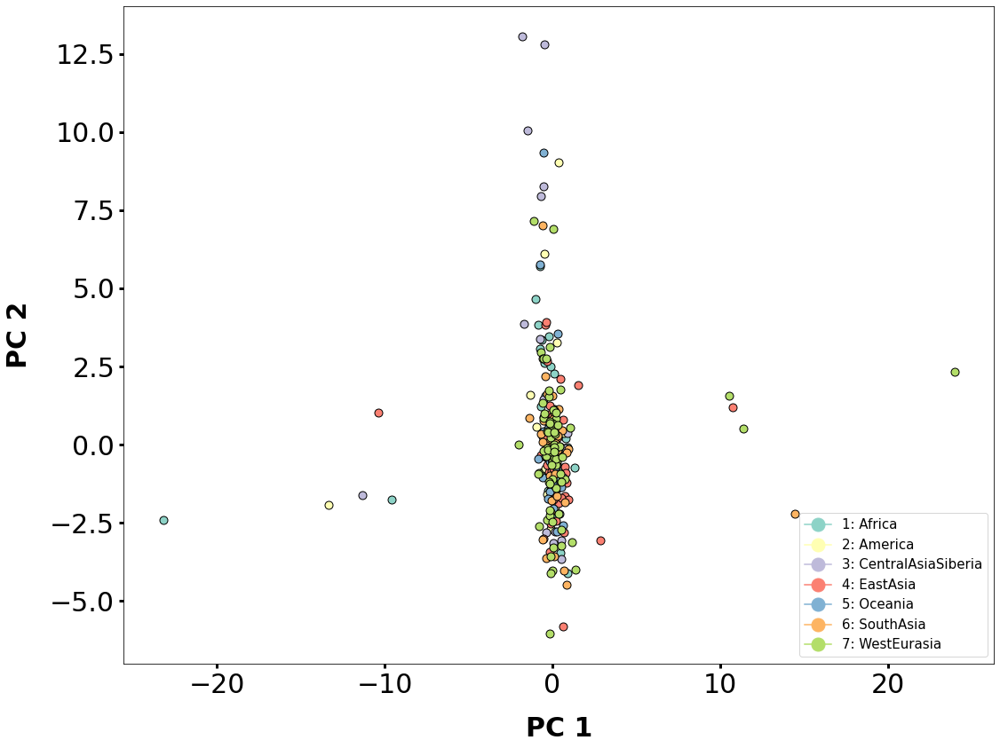

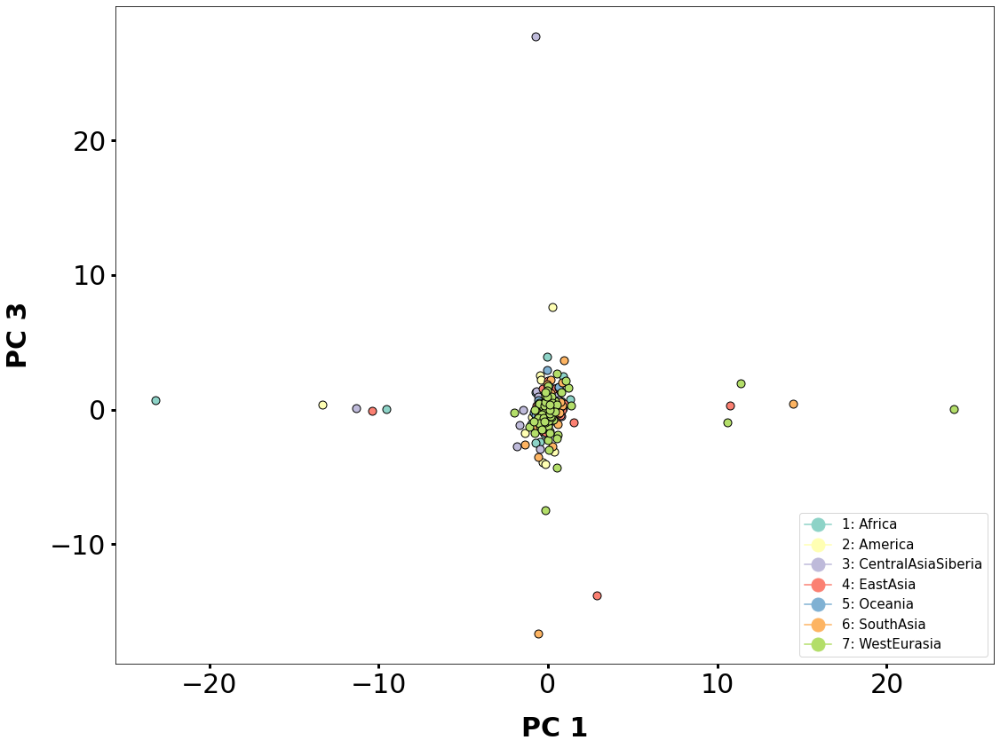

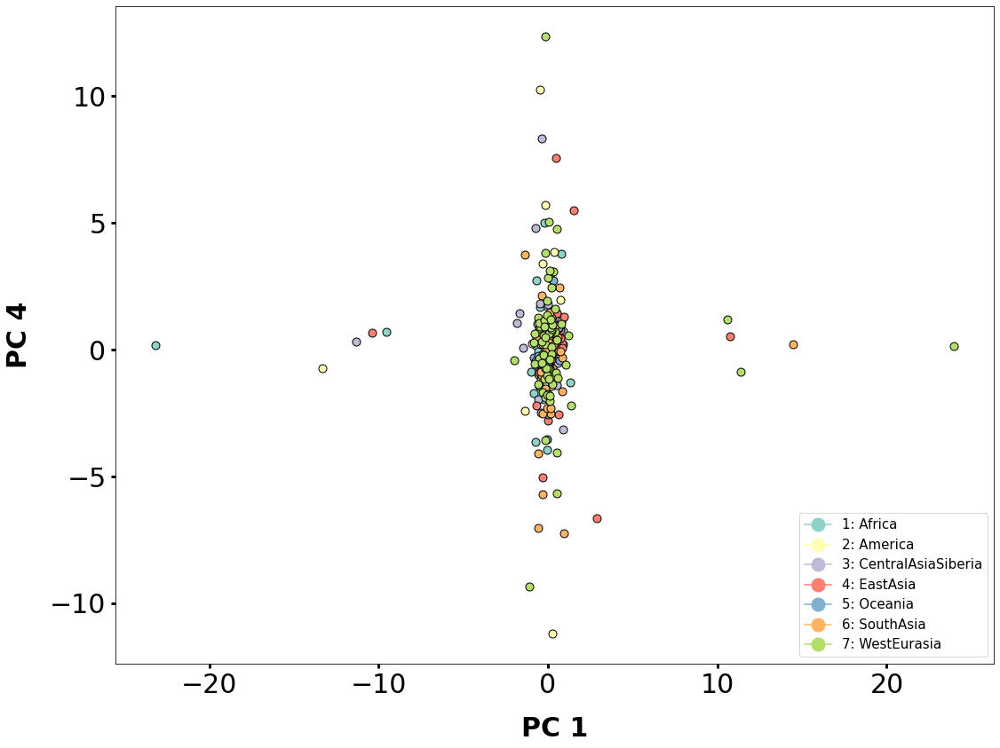

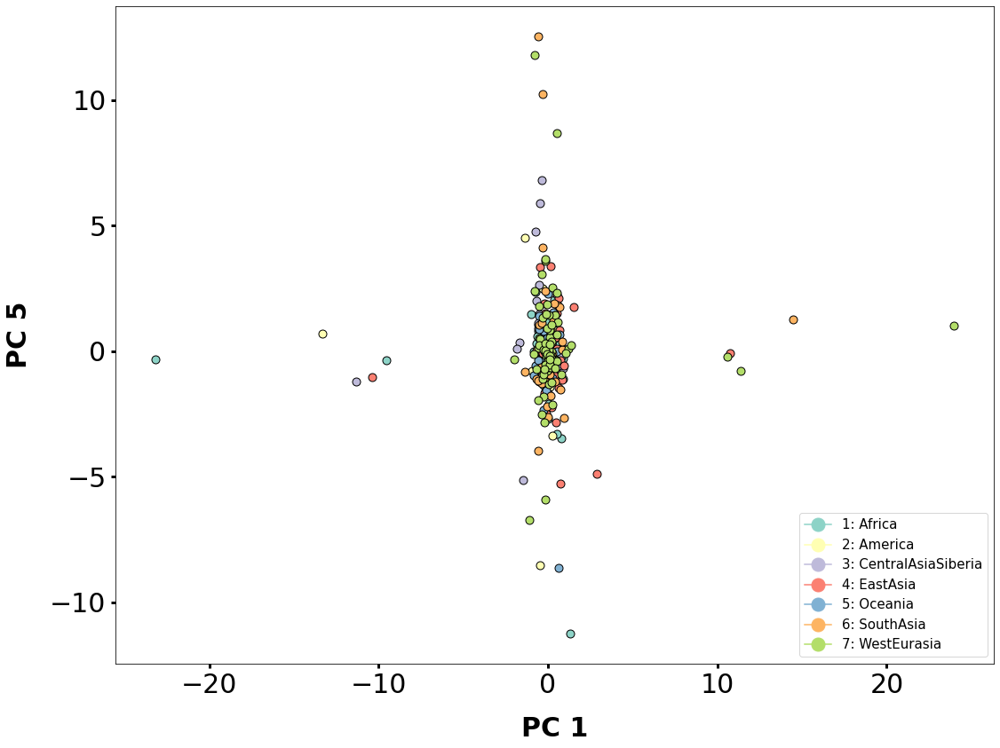

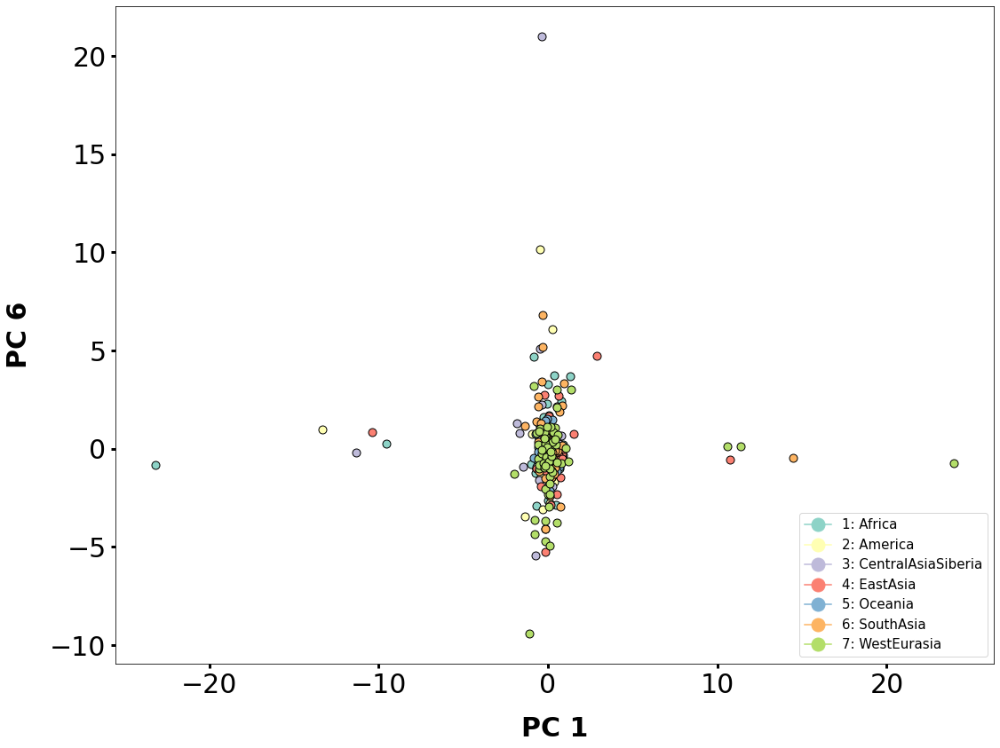

...

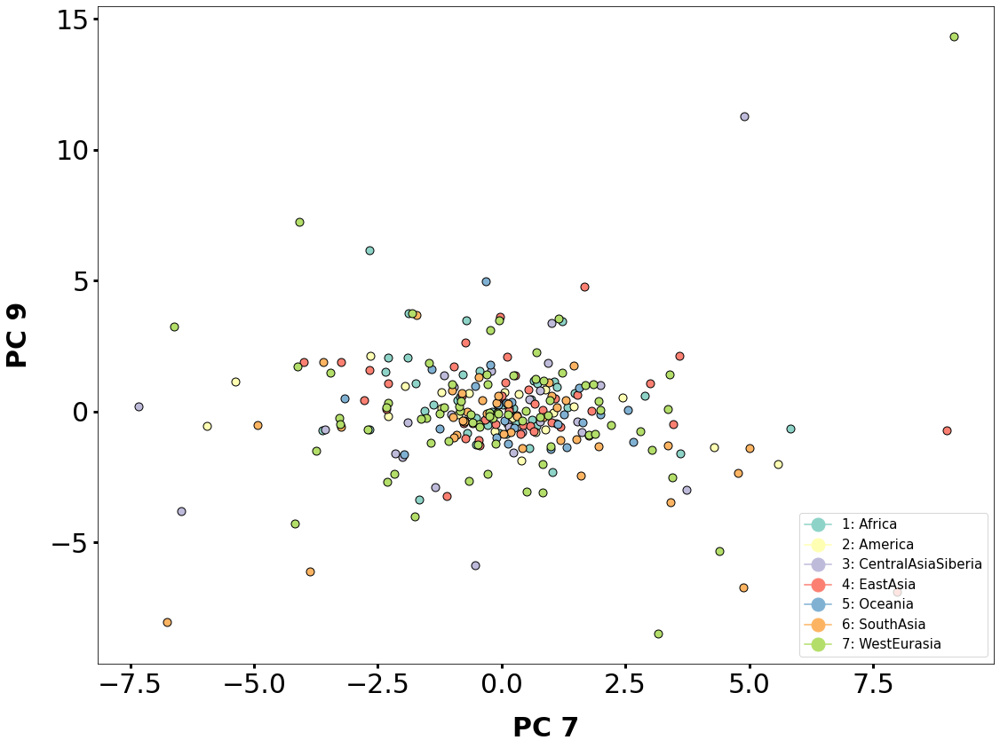

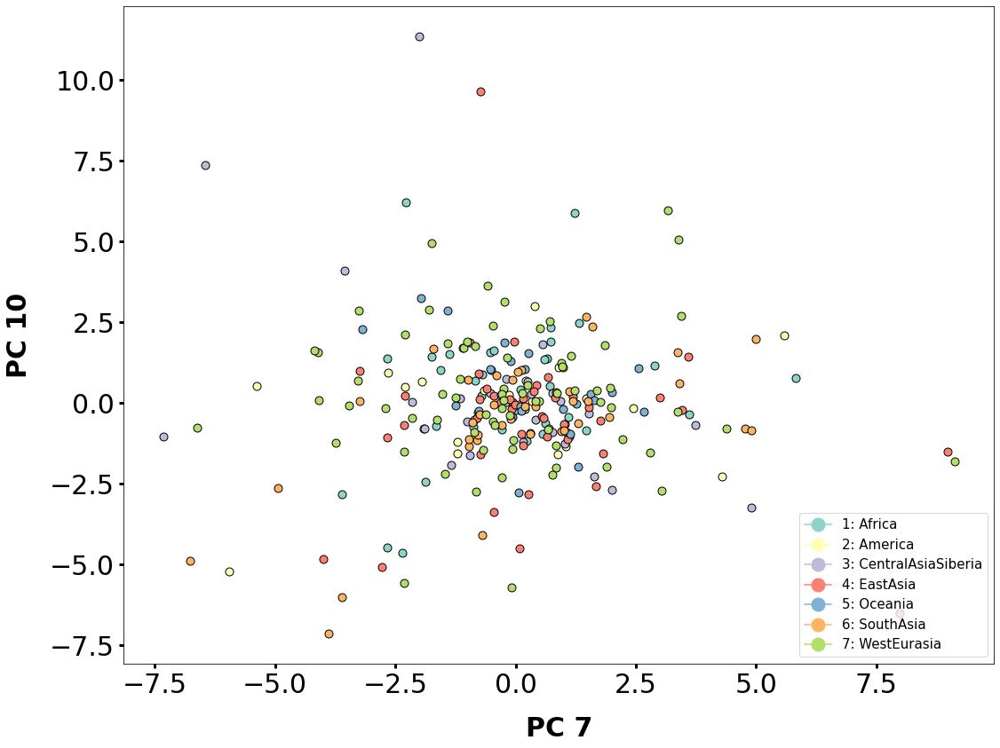

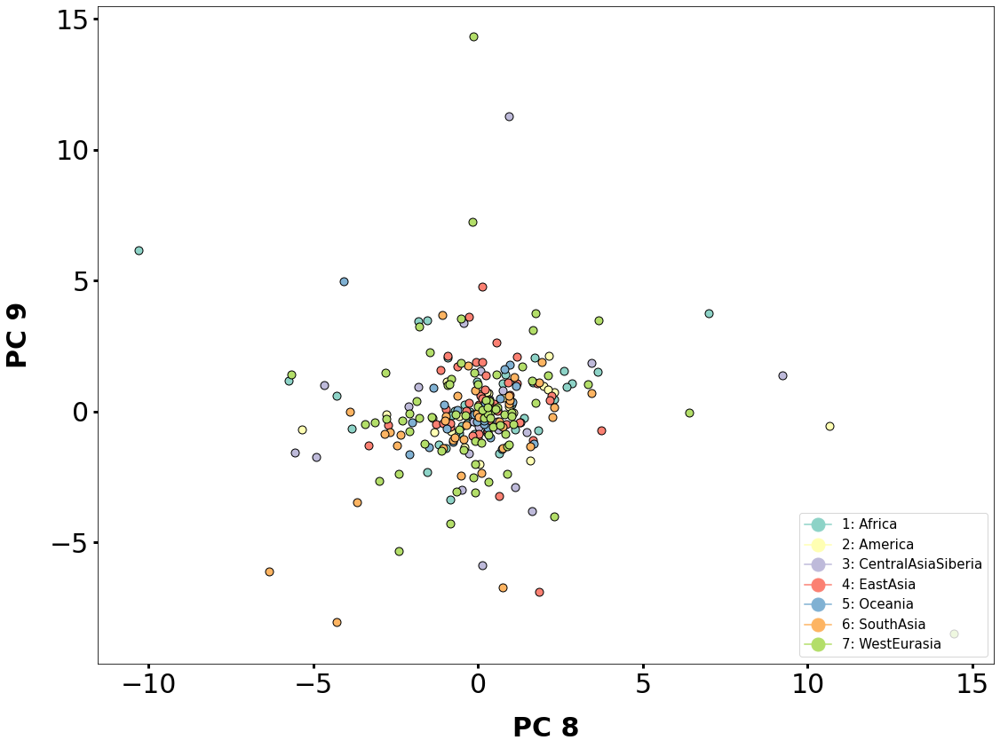

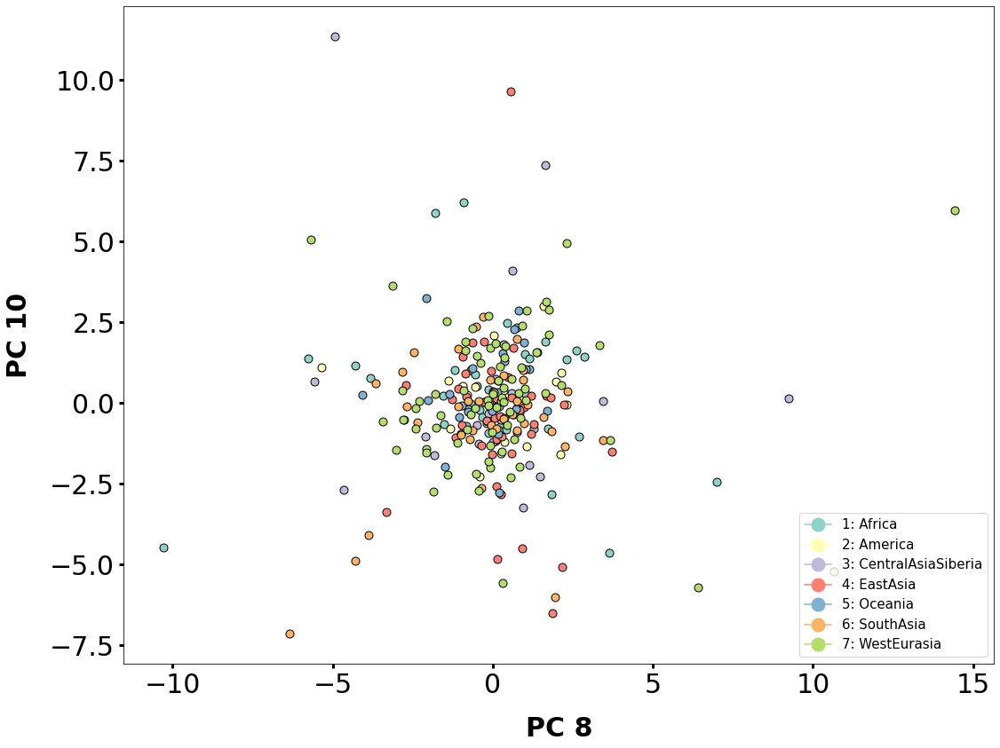

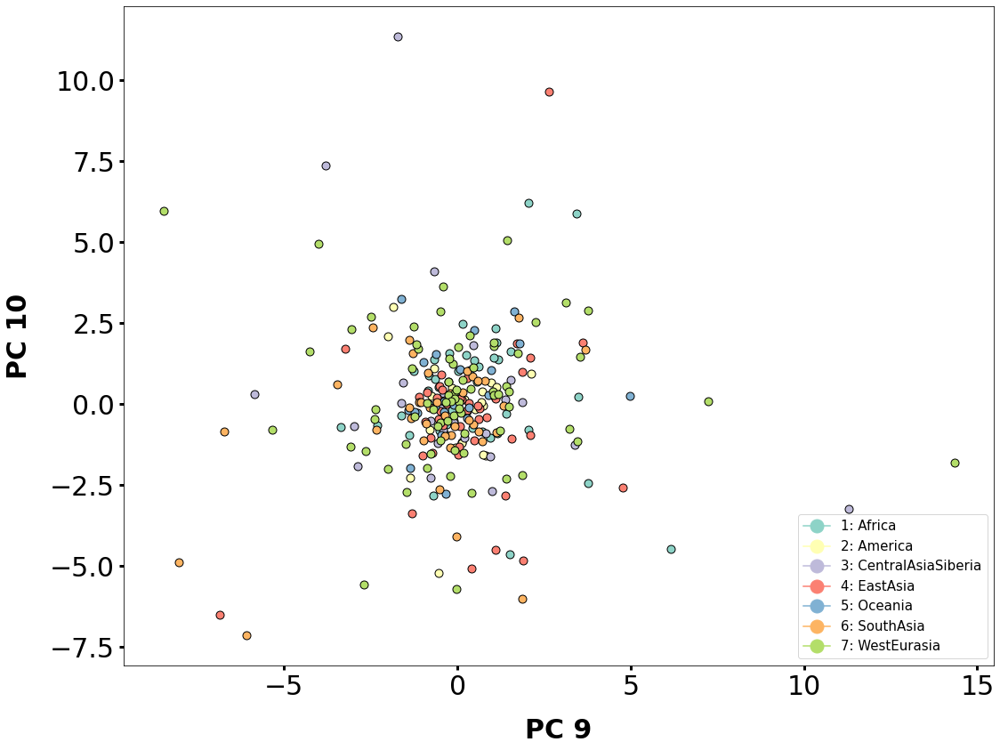

In [114]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> CNVR 

In [492]:
individual_cnv_cnvr = pd.read_table("/branchinecta/jbazanwilliamson/OVERLAPED_CNVNATOR/cnvr_cnvnator/individual_cnv_cnvr.txt")

individual_cnv_cnvr['Chr'] = individual_cnv_cnvr['Chr'].astype(str)

individual_cnv_cnvr 

#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions_cnvr = individual_cnv_cnvr[individual_cnv_cnvr['CNV_Value'] < 0.1] 
duplications_cnvr= individual_cnv_cnvr[individual_cnv_cnvr['CNV_Value'] > 2] 
deletions_cnvr

,Chr,Start,End,CNVR_ID,Sample_ID,CNV_Start,CNV_End,CNV_Value,Length
0,1,12840201,13437200,CNVR_17,LP6005441-DNA_A01,13052901,13132400.0,0.096294,79500.0
1,1,12840201,13437200,CNVR_17,LP6005441-DNA_A01,13052901,13132400.0,0.096294,79500.0
2,1,12840201,13437200,CNVR_17,LP6005441-DNA_A01,13052901,13132400.0,0.096294,79500.0
3,1,12840201,13437200,CNVR_17,LP6005441-DNA_A01,13052901,13132400.0,0.096294,79500.0
7,1,116138701,116348800,CNVR_104,LP6005441-DNA_A01,116229501,116232800.0,0.000000,3300.0
...,...,...,...,...,...,...,...,...,...
191603,1,146021701,146304500,CNVR_115,SS6004480,146249501,146304000.0,0.054771,54500.0
191646,4,9614301,9633300,CNVR_528,SS6004480,9619301,9633100.0,0.044695,13800.0
191647,4,9614301,9633300,CNVR_528,SS6004480,9619301,9633100.0,0.044695,13800.0
191654,4,69372701,69534300,CNVR_571,SS6004480,69373401,69491100.0,0.035543,117700.0


In [493]:
individual_cnv_cnvr = deletions_cnvr.pivot_table(index=["CNVR_ID", "Chr", "Start", "End"], 
                    columns='Sample_ID', 
                    values='CNV_Value').reset_index()

np_cnvr = individual_cnv_cnvr.to_numpy()
individual_cnv_cnvr

Sample_ID,CNVR_ID,Chr,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,CNVR_1,1,177101,355800,NaN,0.006781,0.011097,NaN,NaN,0.005873,...,NaN,NaN,NaN,0.005432,NaN,NaN,0.023807,NaN,NaN,NaN
1,CNVR_100,1,112689901,112706500,NaN,NaN,NaN,0.098461,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,CNVR_1002,7,109436301,109455600,NaN,NaN,0.003451,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.005484,NaN
3,CNVR_1003,7,110181901,110188500,NaN,NaN,NaN,NaN,0.000220,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,CNVR_1010,7,118831201,118854100,0.013294,NaN,NaN,NaN,NaN,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,CNVR_985,7,91030501,91056700,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
561,CNVR_989,7,93327101,93332400,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
562,CNVR_990,7,96541701,96548000,NaN,NaN,NaN,NaN,0.000853,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
563,CNVR_991,7,97395101,97402900,NaN,0.005051,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [494]:
counts = individual_cnv_cnvr.iloc[:,4:283]
#counts = counts.fillna(2)

counts


Sample_ID,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,LP6005441-DNA_A10,LP6005441-DNA_A11,LP6005441-DNA_A12,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,NaN,0.006781,0.011097,NaN,NaN,0.005873,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.005432,NaN,NaN,0.023807,NaN,NaN,NaN
1,NaN,NaN,NaN,0.098461,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,0.003451,NaN,NaN,NaN,0.058213,NaN,NaN,0.002715,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.005484,NaN
3,NaN,NaN,NaN,NaN,0.000220,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.013294,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
561,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
562,NaN,NaN,NaN,NaN,0.000853,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
563,NaN,0.005051,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [495]:
#track features for pca & tsne
count = counts.T
features = anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country"]]
features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005443-DNA_B06,F,WestEurasia,Iceland,-0.092324,-0.685877,-0.272329,-0.972348,0.243138,0.590214,-0.325776,0.471507,-1.111701,0.492420
LP6005442-DNA_D08,F,WestEurasia,Iceland,-0.340130,0.036862,-1.991504,0.648560,-0.801505,-0.372514,0.197910,-0.958821,2.052022,2.568963
LP6005441-DNA_D07,F,SouthAsia,Pakistan,0.655433,-0.628409,-0.249005,0.732961,-0.874708,-0.396526,-0.637635,1.345338,0.054353,0.282670
LP6005441-DNA_C07,M,SouthAsia,Pakistan,0.103681,-3.181070,1.455829,1.416473,-0.575407,-0.299959,-0.674687,-0.806731,-0.924480,-0.757088
LP6005442-DNA_G11,M,Africa,SierraLeone,-0.313245,-0.411898,0.326477,-0.078546,0.018050,0.191986,0.011814,0.387002,0.291221,-0.895043
...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005441-DNA_H10,F,WestEurasia,Russia,-1.089865,4.938796,3.912193,-0.499227,0.023134,3.029338,-0.331294,-2.836758,-0.097707,-8.646636
LP6005519-DNA_A06,M,EastAsia,Myanmar,-0.048272,-4.753333,-4.497997,-3.073396,2.918115,2.473194,1.184891,-4.246198,-2.487292,-3.990319
LP6005519-DNA_B06,M,EastAsia,Myanmar,-0.428100,-2.550562,-1.935284,-2.937843,2.111561,0.250128,-1.313258,-0.481792,-0.048103,-1.074907
LP6005441-DNA_B08,F,Africa,Congo,-0.559310,-0.707963,2.956675,0.456109,-0.987271,1.494933,1.338347,-0.796024,2.264358,-6.667405


            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.092324    -0.685877    -0.272329   
WestEurasia        F      Iceland    -0.340130     0.036862    -1.991504   
SouthAsia          F     Pakistan     0.655433    -0.628409    -0.249005   
SouthAsia          M     Pakistan     0.103681    -3.181070     1.455829   
Africa             M  SierraLeone    -0.313245    -0.411898     0.326477   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -1.089865     4.938796     3.912193   
EastAsia           M      Myanmar    -0.048272    -4.753333    -4.497997   
EastAsia           M      Myanmar    -0.428100    -2.550562    -1.935284   
Africa             F        Congo    -0.559310    -0.707963     2.956675   
WestEurasia        M        Yemen     0.970346    -0.033394     0.671259   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.092324    -0.685877    -0.272329   
WestEurasia        F      Iceland    -0.340130     0.036862    -1.991504   
SouthAsia          F     Pakistan     0.655433    -0.628409    -0.249005   
SouthAsia          M     Pakistan     0.103681    -3.181070     1.455829   
Africa             M  SierraLeone    -0.313245    -0.411898     0.326477   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -1.089865     4.938796     3.912193   
EastAsia           M      Myanmar    -0.048272    -4.753333    -4.497997   
EastAsia           M      Myanmar    -0.428100    -2.550562    -1.935284   
Africa             F        Congo    -0.559310    -0.707963     2.956675   
WestEurasia        M        Yemen     0.970346    -0.033394     0.671259   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.092324    -0.685877    -0.272329   
WestEurasia        F      Iceland    -0.340130     0.036862    -1.991504   
SouthAsia          F     Pakistan     0.655433    -0.628409    -0.249005   
SouthAsia          M     Pakistan     0.103681    -3.181070     1.455829   
Africa             M  SierraLeone    -0.313245    -0.411898     0.326477   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -1.089865     4.938796     3.912193   
EastAsia           M      Myanmar    -0.048272    -4.753333    -4.497997   
EastAsia           M      Myanmar    -0.428100    -2.550562    -1.935284   
Africa             F        Congo    -0.559310    -0.707963     2.956675   
WestEurasia        M        Yemen     0.970346    -0.033394     0.671259   

           

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.092324    -0.685877    -0.272329   
WestEurasia        F      Iceland    -0.340130     0.036862    -1.991504   
SouthAsia          F     Pakistan     0.655433    -0.628409    -0.249005   
SouthAsia          M     Pakistan     0.103681    -3.181070     1.455829   
Africa             M  SierraLeone    -0.313245    -0.411898     0.326477   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -1.089865     4.938796     3.912193   
EastAsia           M      Myanmar    -0.048272    -4.753333    -4.497997   
EastAsia           M      Myanmar    -0.428100    -2.550562    -1.935284   
Africa             F        Congo    -0.559310    -0.707963     2.956675   
WestEurasia        M        Yemen     0.970346    -0.033394     0.671259   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.092324    -0.685877    -0.272329   
WestEurasia        F      Iceland    -0.340130     0.036862    -1.991504   
SouthAsia          F     Pakistan     0.655433    -0.628409    -0.249005   
SouthAsia          M     Pakistan     0.103681    -3.181070     1.455829   
Africa             M  SierraLeone    -0.313245    -0.411898     0.326477   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -1.089865     4.938796     3.912193   
EastAsia           M      Myanmar    -0.048272    -4.753333    -4.497997   
EastAsia           M      Myanmar    -0.428100    -2.550562    -1.935284   
Africa             F        Congo    -0.559310    -0.707963     2.956675   
WestEurasia        M        Yemen     0.970346    -0.033394     0.671259   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.092324    -0.685877    -0.272329   
WestEurasia        F      Iceland    -0.340130     0.036862    -1.991504   
SouthAsia          F     Pakistan     0.655433    -0.628409    -0.249005   
SouthAsia          M     Pakistan     0.103681    -3.181070     1.455829   
Africa             M  SierraLeone    -0.313245    -0.411898     0.326477   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -1.089865     4.938796     3.912193   
EastAsia           M      Myanmar    -0.048272    -4.753333    -4.497997   
EastAsia           M      Myanmar    -0.428100    -2.550562    -1.935284   
Africa             F        Congo    -0.559310    -0.707963     2.956675   
WestEurasia        M        Yemen     0.970346    -0.033394     0.671259   

           

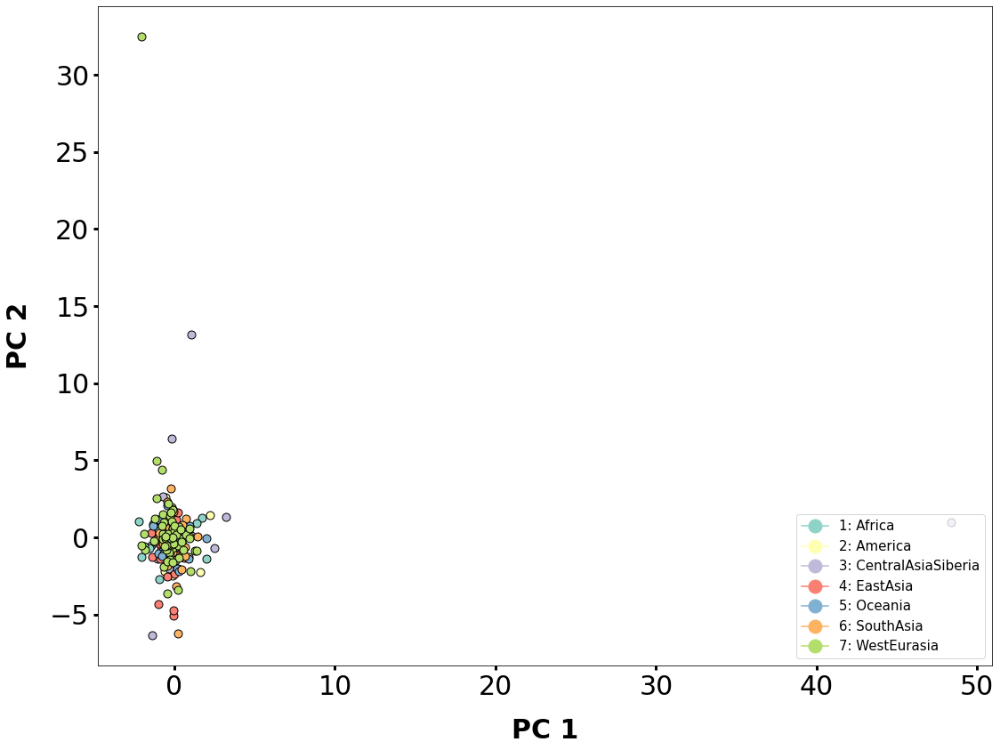

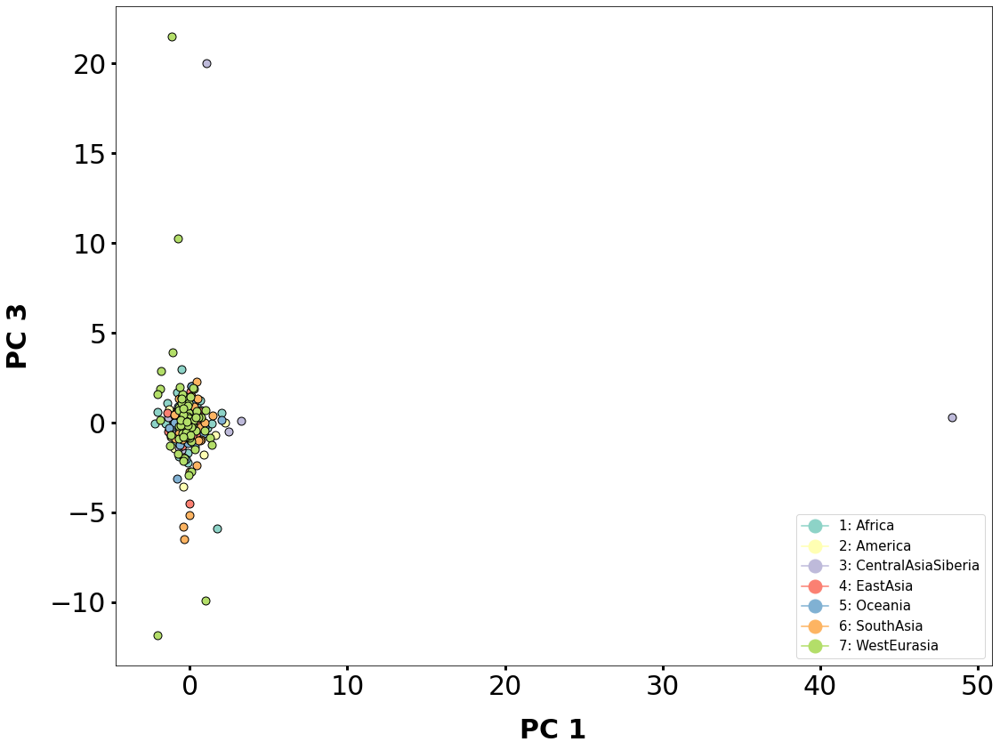

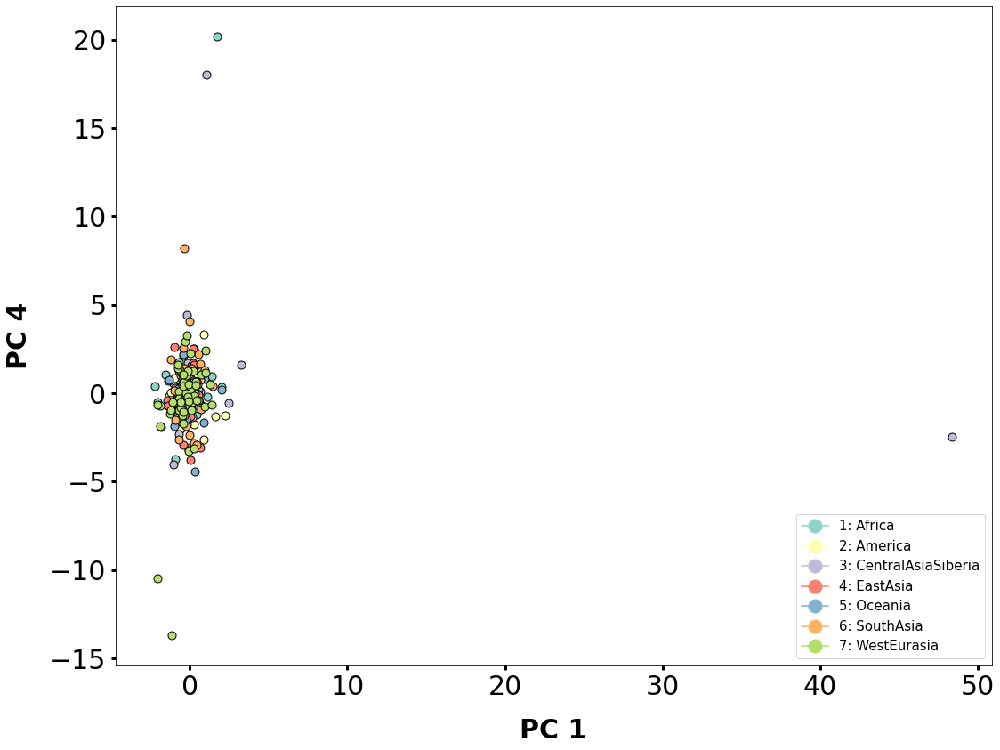

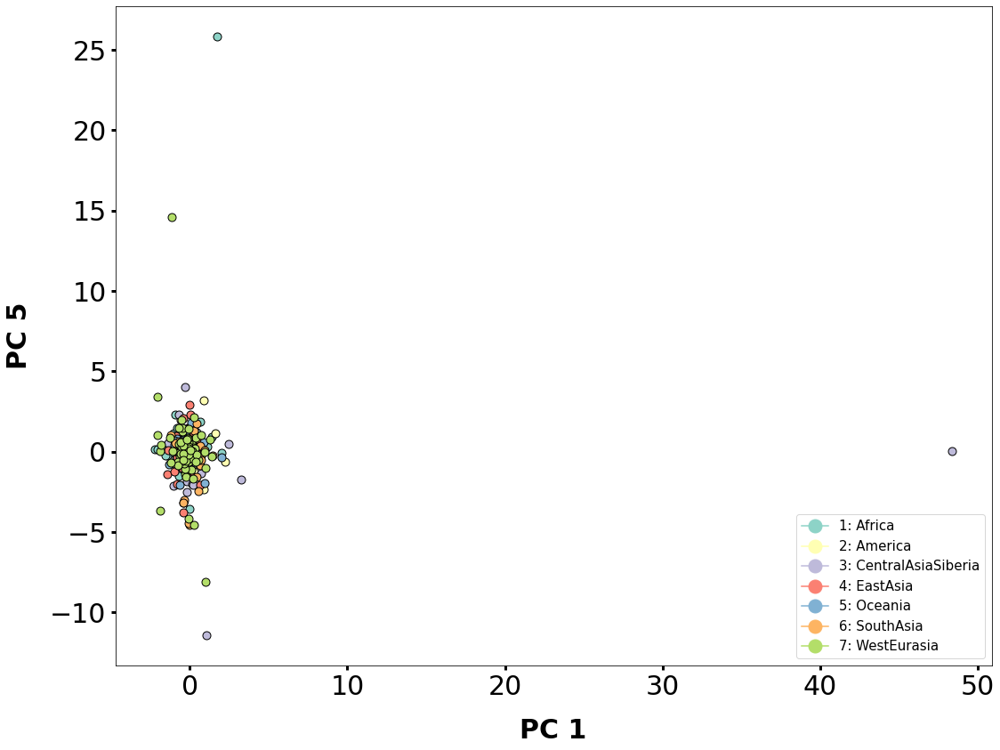

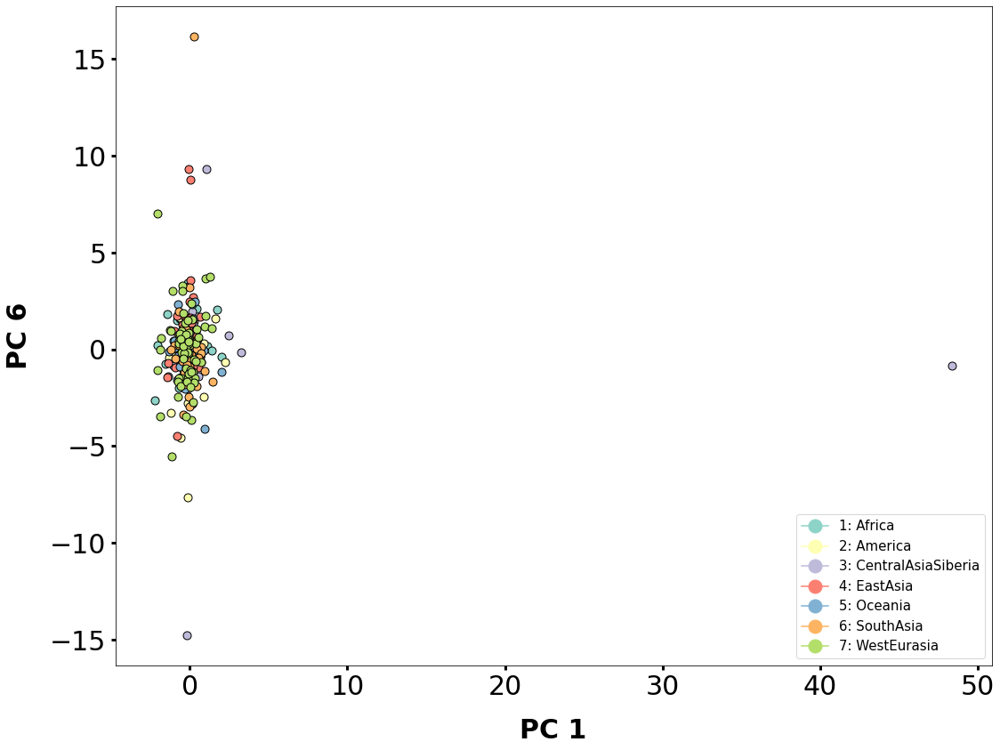

...

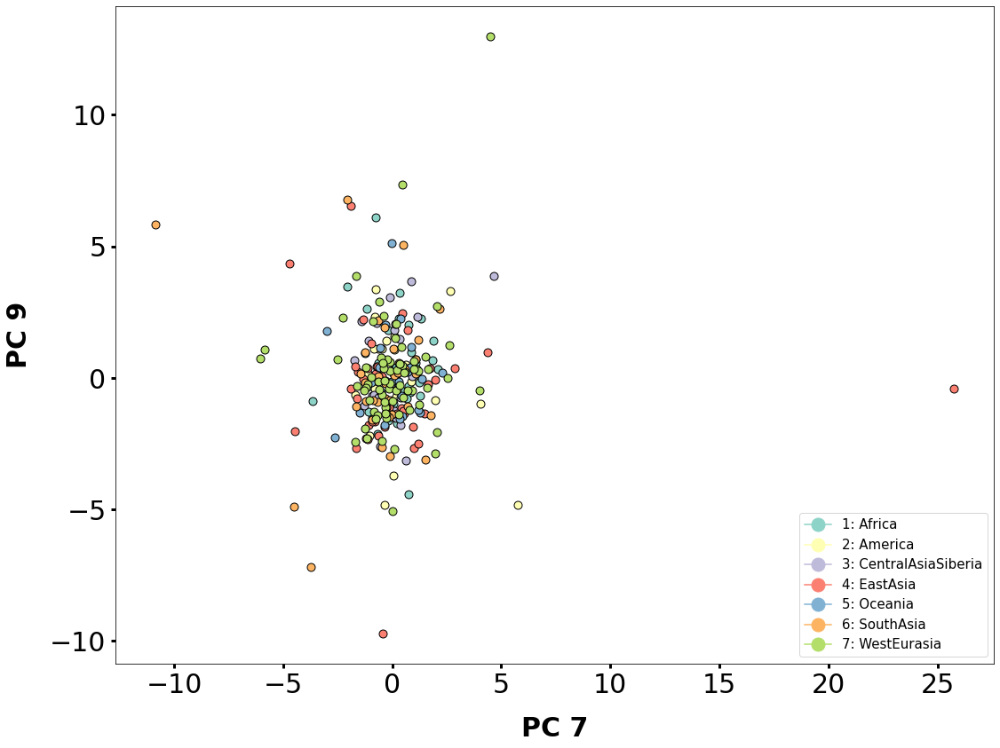

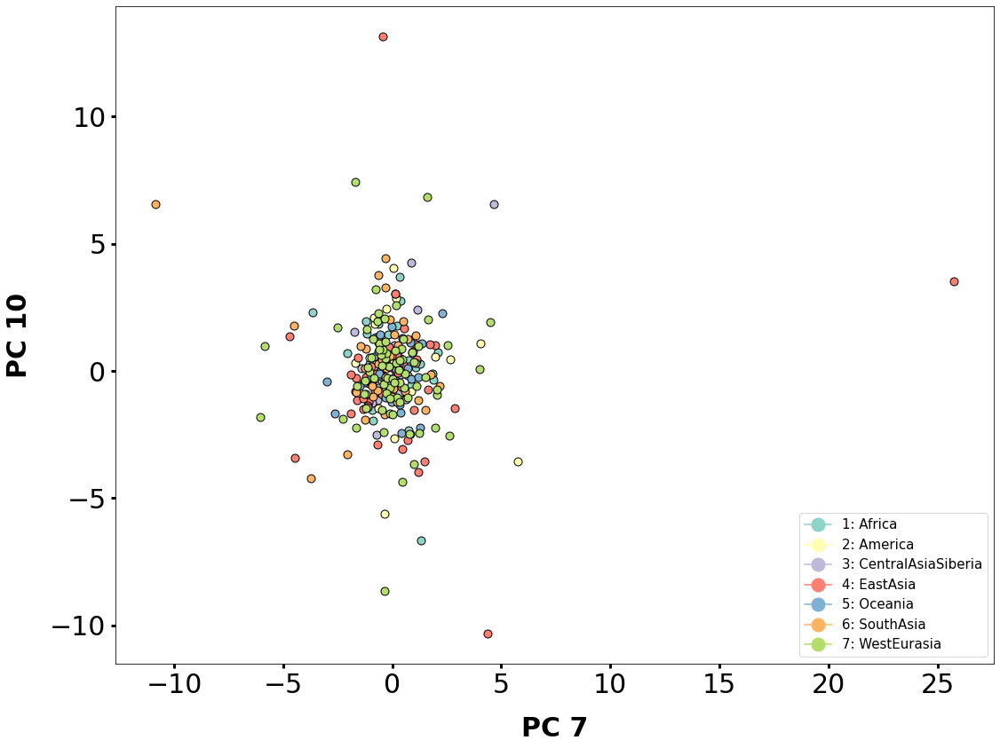

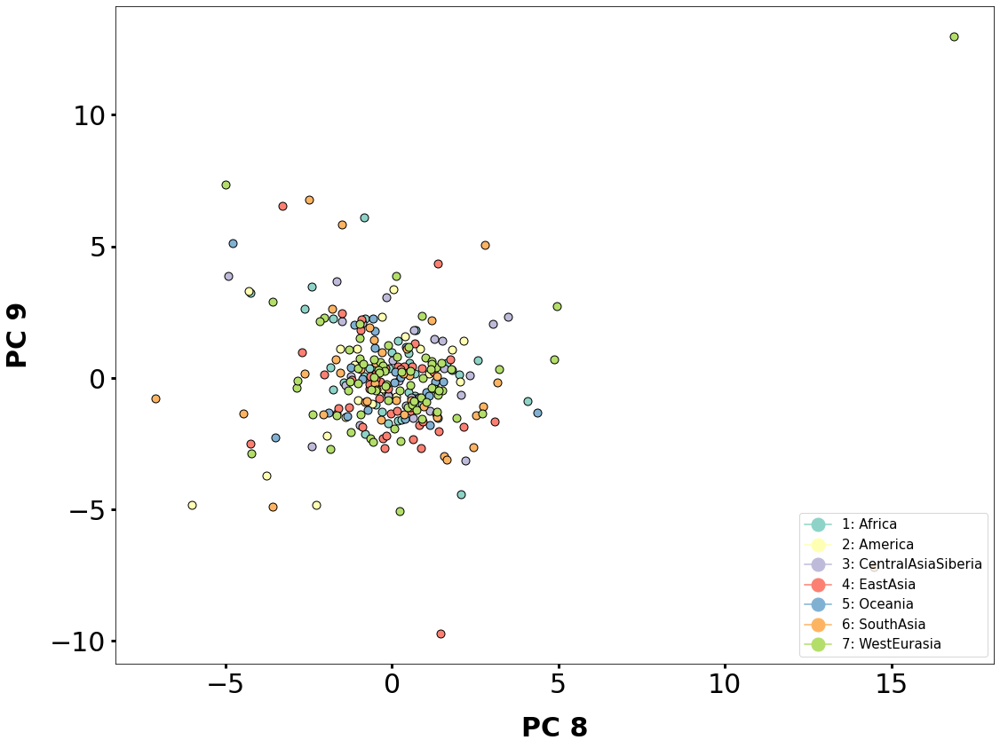

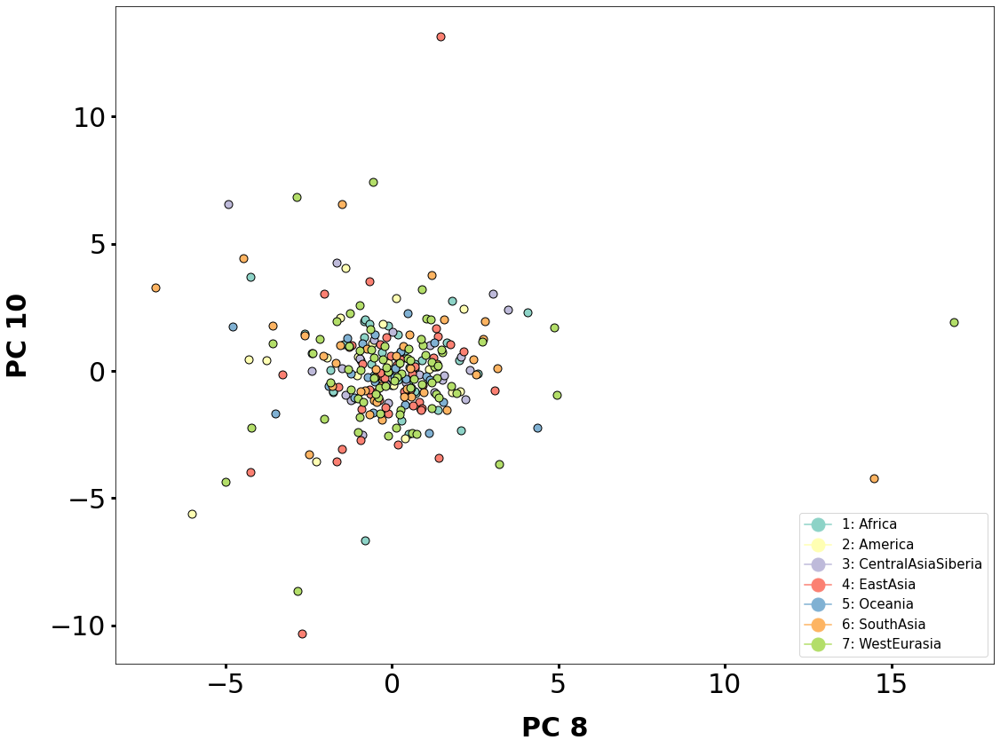

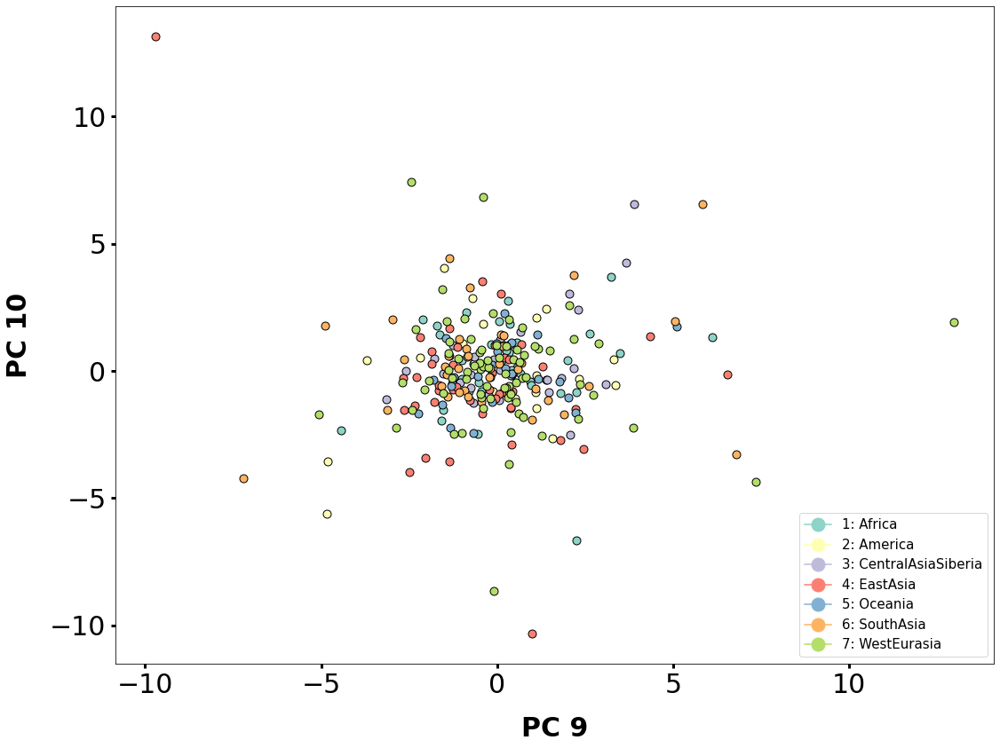

In [496]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [497]:
pca.explained_variance_ratio_

array([0.01979579, 0.01398172, 0.01295497, 0.01237908, 0.0117388 ,
       0.0112361 , 0.01071288, 0.0103939 , 0.00996456, 0.0097934 ])

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.279557     0.296226    -0.064655   
WestEurasia        F      Iceland    -0.403457    -0.152480    -0.596964   
SouthAsia          F     Pakistan    -0.101901    -0.231137    -0.202262   
SouthAsia          M     Pakistan    -0.405009    -0.021008    -0.201716   
Africa             M  SierraLeone    -0.397449    -0.919664    -0.602883   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.431163     0.056278    -1.327110   
EastAsia           M      Myanmar    -1.950752    -0.095054    -1.019168   
EastAsia           M      Myanmar    -1.069724    -0.166300    -1.270773   
Africa             F        Congo    -1.324047    -0.679873    -0.235565   
WestEurasia        M        Yemen    -1.706240     0.067165    -1.149484   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.279557     0.296226    -0.064655   
WestEurasia        F      Iceland    -0.403457    -0.152480    -0.596964   
SouthAsia          F     Pakistan    -0.101901    -0.231137    -0.202262   
SouthAsia          M     Pakistan    -0.405009    -0.021008    -0.201716   
Africa             M  SierraLeone    -0.397449    -0.919664    -0.602883   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.431163     0.056278    -1.327110   
EastAsia           M      Myanmar    -1.950752    -0.095054    -1.019168   
EastAsia           M      Myanmar    -1.069724    -0.166300    -1.270773   
Africa             F        Congo    -1.324047    -0.679873    -0.235565   
WestEurasia        M        Yemen    -1.706240     0.067165    -1.149484   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.279557     0.296226    -0.064655   
WestEurasia        F      Iceland    -0.403457    -0.152480    -0.596964   
SouthAsia          F     Pakistan    -0.101901    -0.231137    -0.202262   
SouthAsia          M     Pakistan    -0.405009    -0.021008    -0.201716   
Africa             M  SierraLeone    -0.397449    -0.919664    -0.602883   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.431163     0.056278    -1.327110   
EastAsia           M      Myanmar    -1.950752    -0.095054    -1.019168   
EastAsia           M      Myanmar    -1.069724    -0.166300    -1.270773   
Africa             F        Congo    -1.324047    -0.679873    -0.235565   
WestEurasia        M        Yemen    -1.706240     0.067165    -1.149484   

           

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.279557     0.296226    -0.064655   
WestEurasia        F      Iceland    -0.403457    -0.152480    -0.596964   
SouthAsia          F     Pakistan    -0.101901    -0.231137    -0.202262   
SouthAsia          M     Pakistan    -0.405009    -0.021008    -0.201716   
Africa             M  SierraLeone    -0.397449    -0.919664    -0.602883   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.431163     0.056278    -1.327110   
EastAsia           M      Myanmar    -1.950752    -0.095054    -1.019168   
EastAsia           M      Myanmar    -1.069724    -0.166300    -1.270773   
Africa             F        Congo    -1.324047    -0.679873    -0.235565   
WestEurasia        M        Yemen    -1.706240     0.067165    -1.149484   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.279557     0.296226    -0.064655   
WestEurasia        F      Iceland    -0.403457    -0.152480    -0.596964   
SouthAsia          F     Pakistan    -0.101901    -0.231137    -0.202262   
SouthAsia          M     Pakistan    -0.405009    -0.021008    -0.201716   
Africa             M  SierraLeone    -0.397449    -0.919664    -0.602883   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.431163     0.056278    -1.327110   
EastAsia           M      Myanmar    -1.950752    -0.095054    -1.019168   
EastAsia           M      Myanmar    -1.069724    -0.166300    -1.270773   
Africa             F        Congo    -1.324047    -0.679873    -0.235565   
WestEurasia        M        Yemen    -1.706240     0.067165    -1.149484   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.279557     0.296226    -0.064655   
WestEurasia        F      Iceland    -0.403457    -0.152480    -0.596964   
SouthAsia          F     Pakistan    -0.101901    -0.231137    -0.202262   
SouthAsia          M     Pakistan    -0.405009    -0.021008    -0.201716   
Africa             M  SierraLeone    -0.397449    -0.919664    -0.602883   
...              ...          ...          ...          ...          ...   
WestEurasia        F       Russia    -0.431163     0.056278    -1.327110   
EastAsia           M      Myanmar    -1.950752    -0.095054    -1.019168   
EastAsia           M      Myanmar    -1.069724    -0.166300    -1.270773   
Africa             F        Congo    -1.324047    -0.679873    -0.235565   
WestEurasia        M        Yemen    -1.706240     0.067165    -1.149484   

           

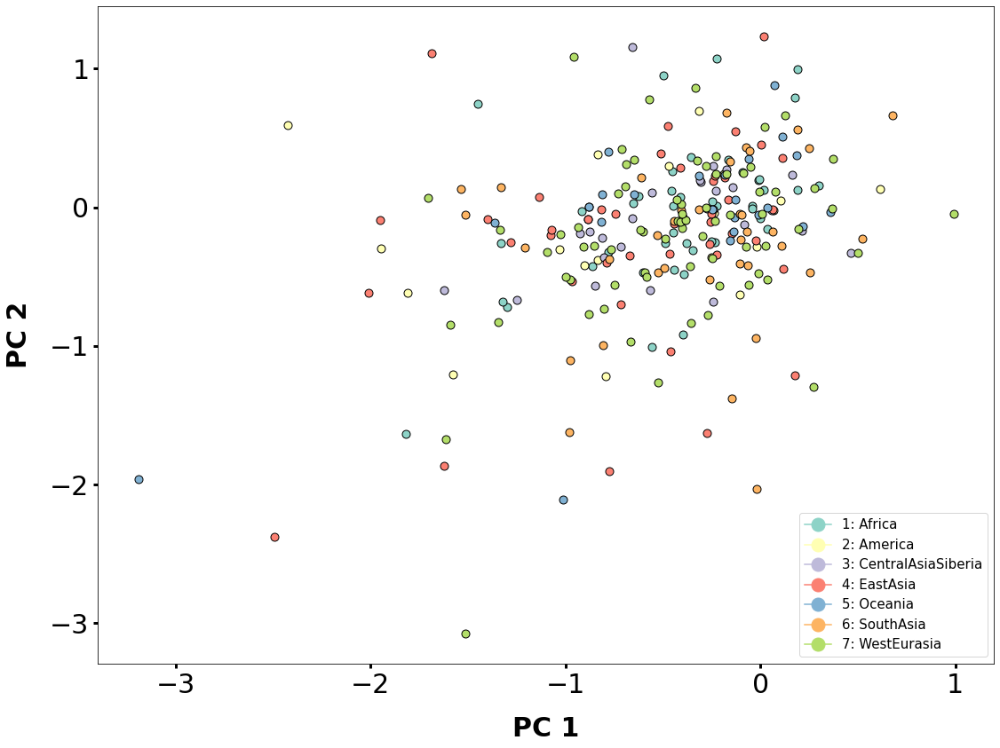

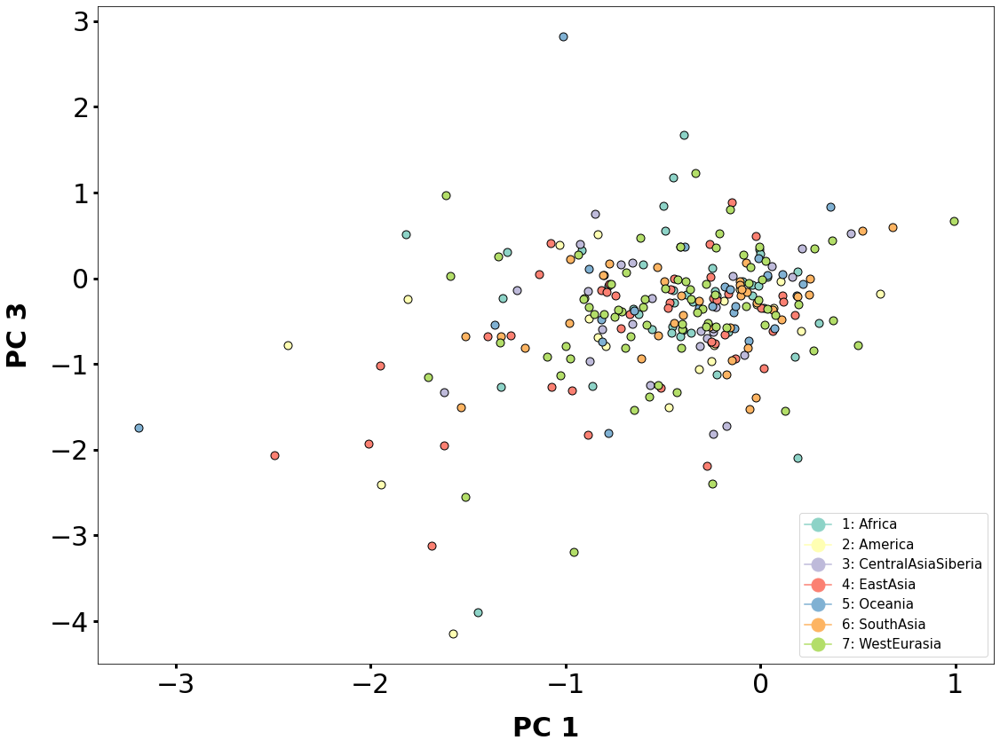

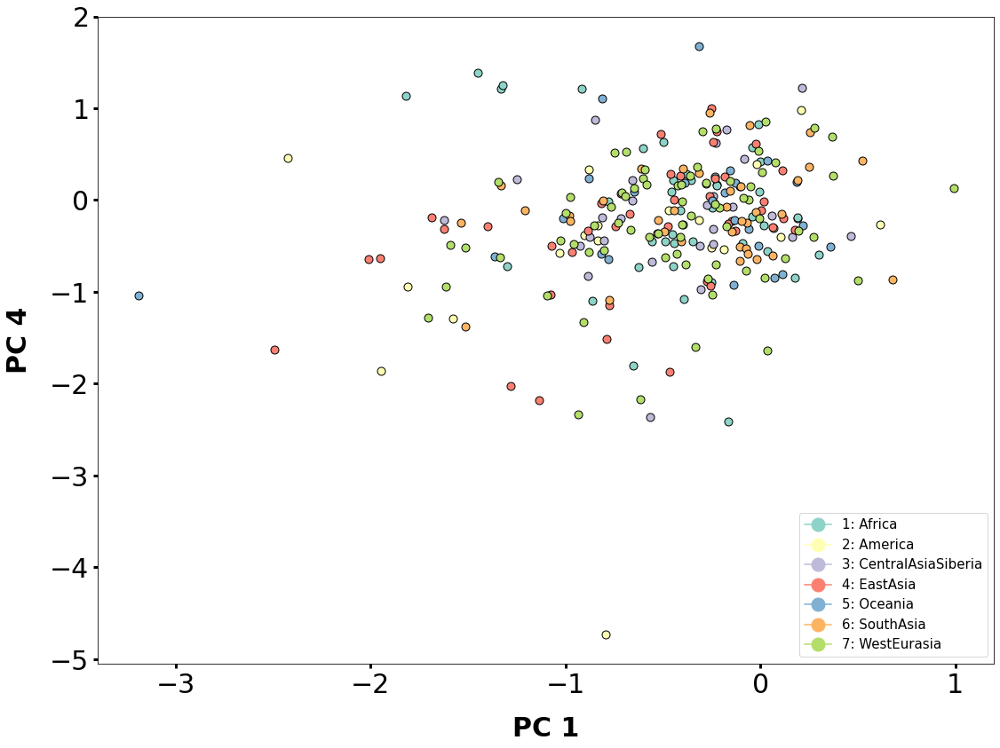

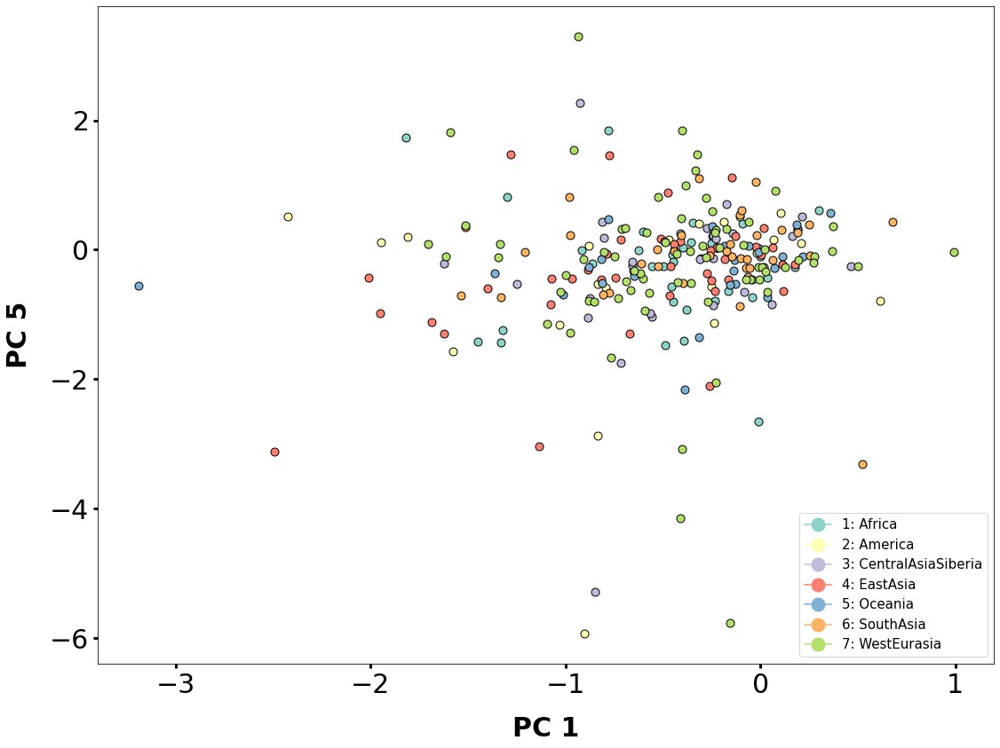

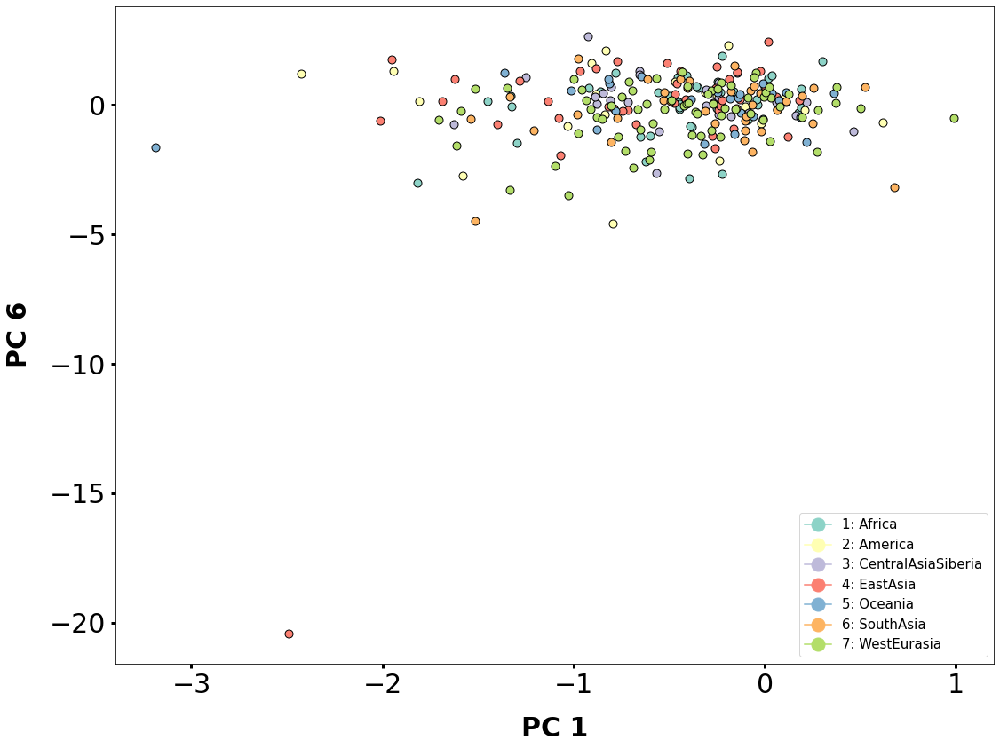

...

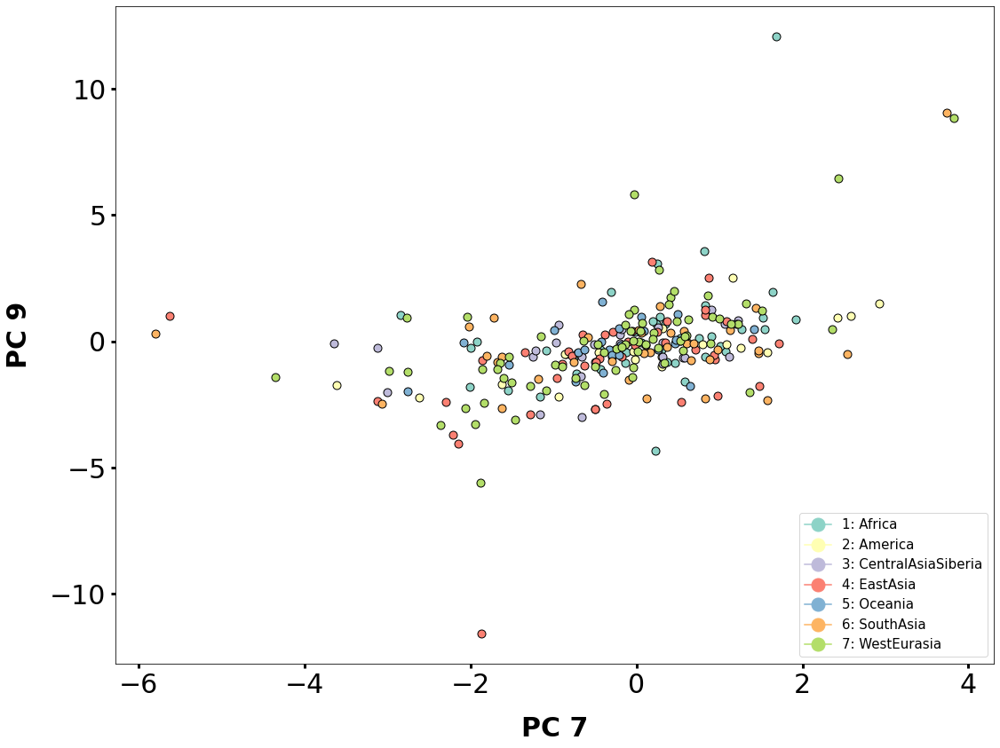

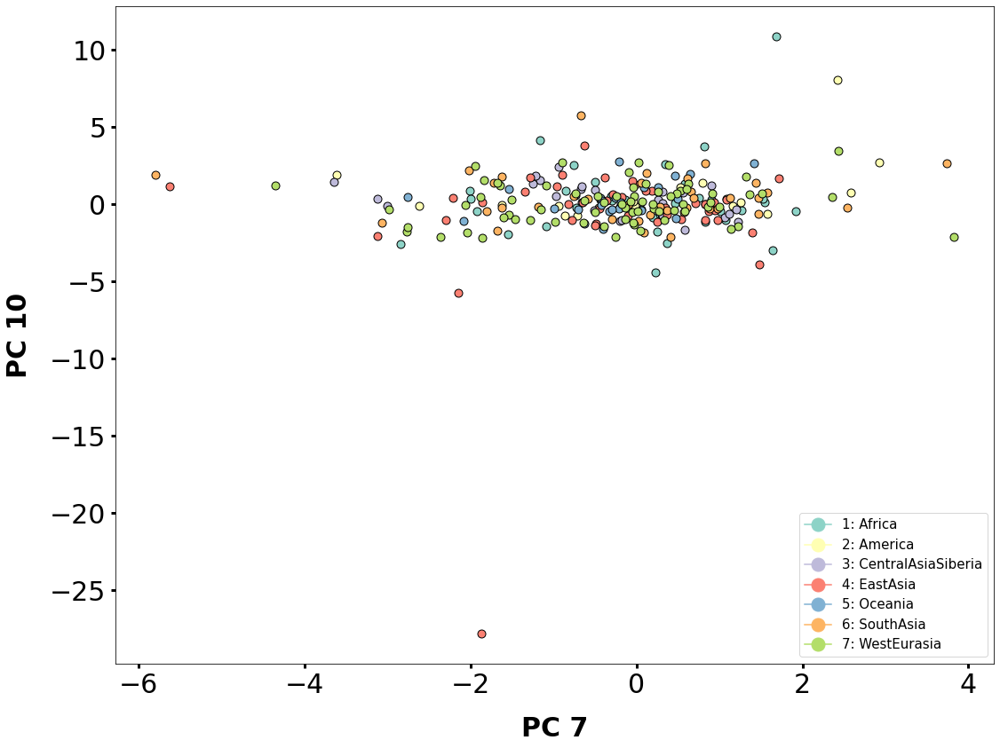

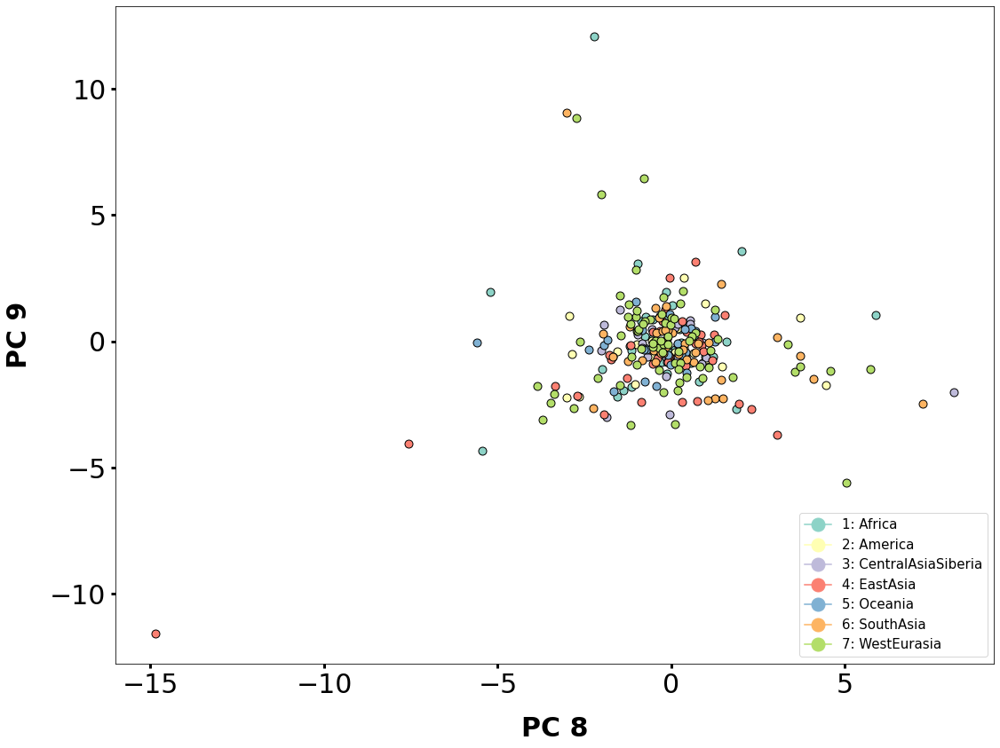

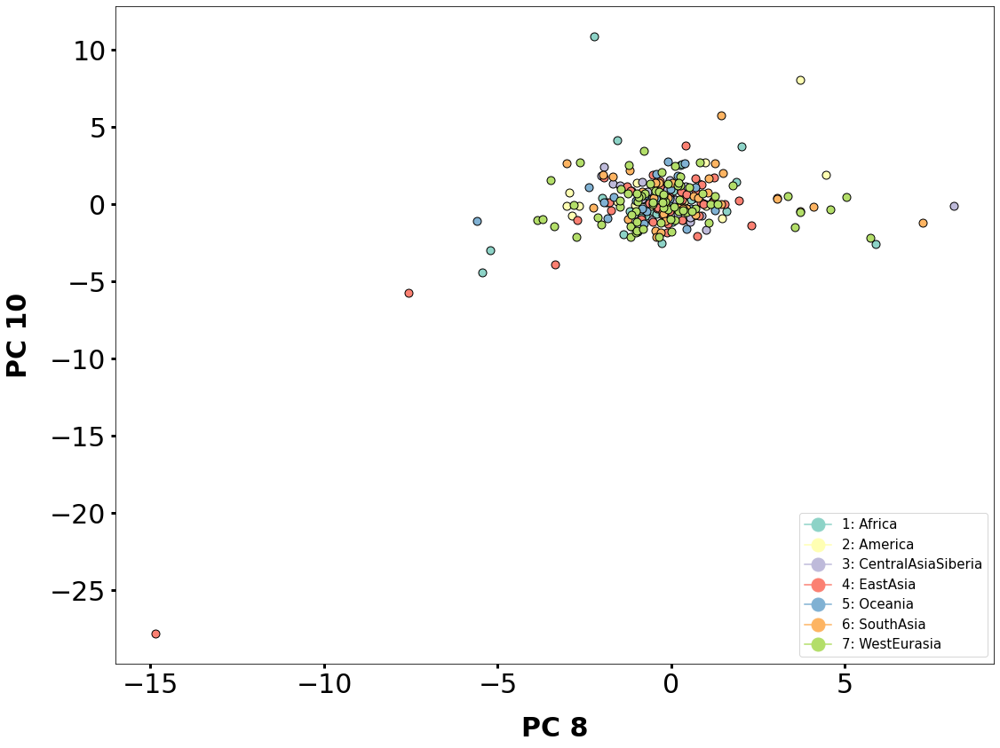

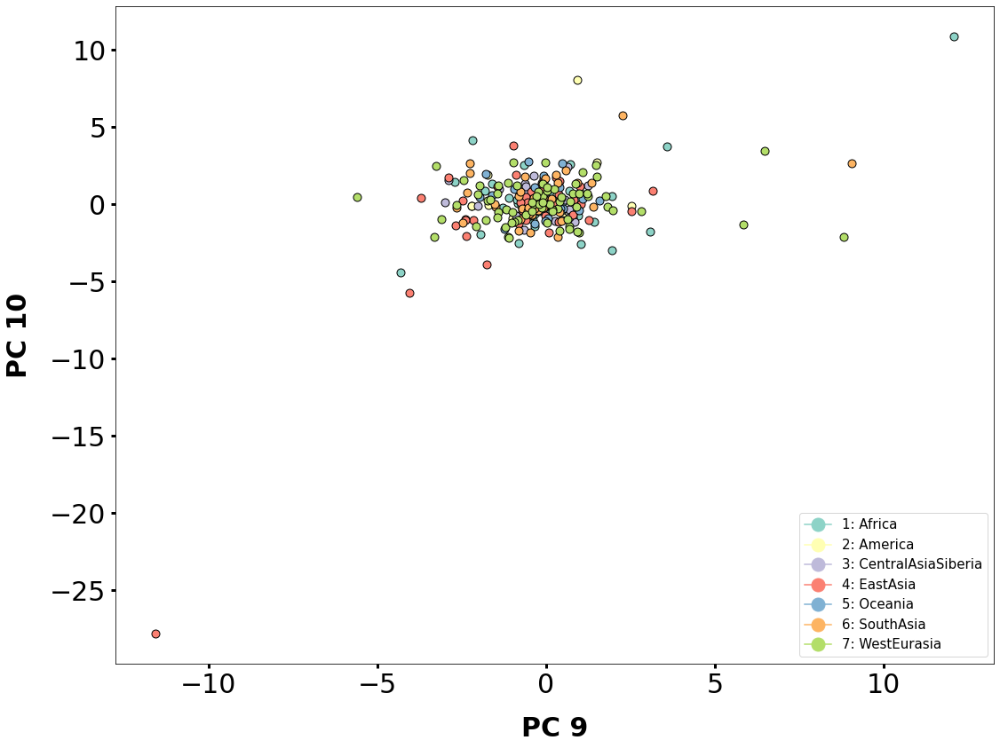

In [438]:
df_pca_outlier = df_pca[df_pca['component_1'] < 30]
#df_pca_outlier = df_pca_outlier[df_pca_outlier['component_1'] > -1.5=]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_2'] < 30]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_3'] < 30]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_4'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_5'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_6'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_7'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_8'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_9'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_10'] < 20]


outliers = pd.concat([df_pca,df_pca_outlier]).drop_duplicates(keep=False)

outlier_samples = list(outliers.index)
outlier_samples

components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca_outlier, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> Studmant Data

In [73]:
header= ['Sample', 'Region', 'Country', 'Sample_ID', 'Sex']
studmant_anotation = pd.read_csv('/branchinecta/jbazanwilliamson/Studmant_anotation.csv', names=header, index_col=0)#Studmant data

studmant_data = pd.read_csv('/branchinecta/jbazanwilliamson/Studmant_cnvs.csv')
studmant_data= studmant_data.drop(columns=['bi-allelic'])

studmant_data['contig'] = studmant_data['contig'].str.replace('chr', '')
studmant_data#['MEL_Papuan_HGDP00554_F']

deletions = studmant_data[studmant_data['type'] == "DEL"] 
duplications= studmant_data[studmant_data['type'] == "DUP"] 
#deletions

counts = deletions.iloc[:,5:283]
#counts = counts.fillna(2)

deletions

,contig,start,end,size,type,EA_Uygur_HGDP01306_F,EA_Dai_HGDP01315_F,SIB_Chukchi_Sir19_M,AFR_Somali_Ayodo81S_F,AFR_MendeMSL_HG03078_M,...,WEA_Palestinian_HGDP00737_F,AMR_Karitiana_HGDP01018_F,EA_Uygur_HGDP01297_M,AMR_Pima_HGDP01044_F,AFR_Yoruba_HGDP00928_F,OCN_Papuan_HGDP00543_M,OCN_Papuan_HGDP00551_M,WEA_Armenian_armenia293_M,WEA_Tuscan_HGDP01163_M,SA_BengaliBEB_HG03006_M
2,1,53897994,53905803,7809,DEL,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
3,1,114813682,114821317,7635,DEL,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
6,1,53999167,54002886,3719,DEL,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
7,1,204380861,204383316,2455,DEL,2,2,2,2,1,...,2,2,1,0,2,2,2,2,2,1
13,1,204570059,204572901,2842,DEL,2,2,2,2,2,...,2,2,2,2,2,2,2,1,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15006,X,135993241,136002890,9649,DEL,2,2,1,2,1,...,2,2,1,2,2,1,1,1,1,1
15007,X,29599756,29609177,9421,DEL,2,2,1,2,1,...,2,2,1,2,2,1,1,1,1,1
15008,X,136184011,136198455,14444,DEL,2,2,1,2,1,...,2,2,1,2,2,1,1,1,1,1
15010,X,138508379,138510401,2022,DEL,2,2,1,2,1,...,2,2,1,2,2,1,1,1,1,1


In [74]:
count = counts.T
features = studmant_anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["Region", "Country"]]
features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,Region,Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
AFR_BantuKenya_HGDP01414_F,AFR,BantuKenya,14.595114,-11.445085,-2.391587,-0.720872,-7.880501,-0.882692,-0.580051,-0.574101,0.637630,-0.345739
AFR_BantuKenya_HGDP01417_M,AFR,BantuKenya,16.680617,-12.192469,-3.217218,-0.605835,-10.362895,2.214097,-0.479794,1.398802,2.287006,-3.173749
AFR_BantuSEHerero_HGDP01028_M,AFR,BantuSEHerero,-11.535939,3.744601,-2.676162,-11.890164,16.727306,6.434033,5.570693,-1.640466,-0.424107,0.080168
AFR_BantuSEHerero_HGDP01035_M,AFR,BantuSEHerero,15.868892,-10.746413,-0.882393,11.906232,22.612703,2.378228,-0.410010,0.288158,-3.309669,1.773938
AFR_BantuSETswana_HGDP01030_M,AFR,BantuSETswana,-16.471524,12.513387,6.925134,27.311855,8.774248,-18.651220,-26.175047,2.221421,-11.376135,-5.571522
...,...,...,...,...,...,...,...,...,...,...,...,...
WEA_SpainIBS_HG01504_F,WEA,SpainIBS,-12.375332,7.584896,-0.080111,-6.651283,-9.824228,-3.716933,-2.174904,2.896727,-2.484949,-0.283151
WEA_Tuscan_HGDP01163_M,WEA,Tuscan,-12.550505,6.672497,-0.541579,-7.712622,-8.644858,-2.953906,-2.701460,2.553022,-1.217612,-0.045625
WEA_Tuscan_HGDP01168_F,WEA,Tuscan,-12.241005,4.730872,-0.245463,-8.433900,15.658929,4.922966,3.227209,-0.483917,-1.398293,0.847684
WEA_YemeniteJew_4695_F,WEA,YemeniteJew,-12.582660,5.495858,-0.559485,-5.327399,-3.704316,-2.137511,0.255235,-0.059482,-2.250522,0.354380


              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    14.595114   -11.445085    -2.391587    -0.720872   
AFR        BantuKenya    16.680617   -12.192469    -3.217218    -0.605835   
AFR     BantuSEHerero   -11.535939     3.744601    -2.676162   -11.890164   
AFR     BantuSEHerero    15.868892   -10.746413    -0.882393    11.906232   
AFR     BantuSETswana   -16.471524    12.513387     6.925134    27.311855   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS   -12.375332     7.584896    -0.080111    -6.651283   
WEA            Tuscan   -12.550505     6.672497    -0.541579    -7.712622   
WEA            Tuscan   -12.241005     4.730872    -0.245463    -8.433900   
WEA       YemeniteJew   -12.582660     5.495858    -0.559485    -5.327399   
WEA       YemeniteJew   -12.805850     6.519421     0.401393    -6.540770   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    14.595114   -11.445085    -2.391587    -0.720872   
AFR        BantuKenya    16.680617   -12.192469    -3.217218    -0.605835   
AFR     BantuSEHerero   -11.535939     3.744601    -2.676162   -11.890164   
AFR     BantuSEHerero    15.868892   -10.746413    -0.882393    11.906232   
AFR     BantuSETswana   -16.471524    12.513387     6.925134    27.311855   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS   -12.375332     7.584896    -0.080111    -6.651283   
WEA            Tuscan   -12.550505     6.672497    -0.541579    -7.712622   
WEA            Tuscan   -12.241005     4.730872    -0.245463    -8.433900   
WEA       YemeniteJew   -12.582660     5.495858    -0.559485    -5.327399   
WEA       YemeniteJew   -12.805850     6.519421     0.401393    -6.540770   

Count of groups by factor: 8
              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    14.595114   -11.445085    -2.391587    -0.720872   
AFR        BantuKenya    16.680617   -12.192469    -3.217218    -0.605835   
AFR     BantuSEHerero   -11.535939     3.744601    -2.676162   -11.890164   
AFR     BantuSEHerero    15.868892   -10.746413    -0.882393    11.906232   
AFR     BantuSETswana   -16.471524    12.513387     6.925134    27.311855   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS   -12.375332     7.584896    -0.080111    -6.651283   
WEA            Tuscan   -12.550505     6.672497    -0.541579    -7.712622   
WEA            Tuscan   -12.241005     4.730872    -0.245463    -8.433900   
WEA       YemeniteJew   -12.582660     5.495858    -0.559485    -5.327399   
WEA       YemeniteJew   -12.805850     6.519421

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    14.595114   -11.445085    -2.391587    -0.720872   
AFR        BantuKenya    16.680617   -12.192469    -3.217218    -0.605835   
AFR     BantuSEHerero   -11.535939     3.744601    -2.676162   -11.890164   
AFR     BantuSEHerero    15.868892   -10.746413    -0.882393    11.906232   
AFR     BantuSETswana   -16.471524    12.513387     6.925134    27.311855   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS   -12.375332     7.584896    -0.080111    -6.651283   
WEA            Tuscan   -12.550505     6.672497    -0.541579    -7.712622   
WEA            Tuscan   -12.241005     4.730872    -0.245463    -8.433900   
WEA       YemeniteJew   -12.582660     5.495858    -0.559485    -5.327399   
WEA       YemeniteJew   -12.805850     6.519421     0.401393    -6.540770   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    14.595114   -11.445085    -2.391587    -0.720872   
AFR        BantuKenya    16.680617   -12.192469    -3.217218    -0.605835   
AFR     BantuSEHerero   -11.535939     3.744601    -2.676162   -11.890164   
AFR     BantuSEHerero    15.868892   -10.746413    -0.882393    11.906232   
AFR     BantuSETswana   -16.471524    12.513387     6.925134    27.311855   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS   -12.375332     7.584896    -0.080111    -6.651283   
WEA            Tuscan   -12.550505     6.672497    -0.541579    -7.712622   
WEA            Tuscan   -12.241005     4.730872    -0.245463    -8.433900   
WEA       YemeniteJew   -12.582660     5.495858    -0.559485    -5.327399   
WEA       YemeniteJew   -12.805850     6.519421     0.401393    -6.540770   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya    14.595114   -11.445085    -2.391587    -0.720872   
AFR        BantuKenya    16.680617   -12.192469    -3.217218    -0.605835   
AFR     BantuSEHerero   -11.535939     3.744601    -2.676162   -11.890164   
AFR     BantuSEHerero    15.868892   -10.746413    -0.882393    11.906232   
AFR     BantuSETswana   -16.471524    12.513387     6.925134    27.311855   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS   -12.375332     7.584896    -0.080111    -6.651283   
WEA            Tuscan   -12.550505     6.672497    -0.541579    -7.712622   
WEA            Tuscan   -12.241005     4.730872    -0.245463    -8.433900   
WEA       YemeniteJew   -12.582660     5.495858    -0.559485    -5.327399   
WEA       YemeniteJew   -12.805850     6.519421     0.401393    -6.540770   

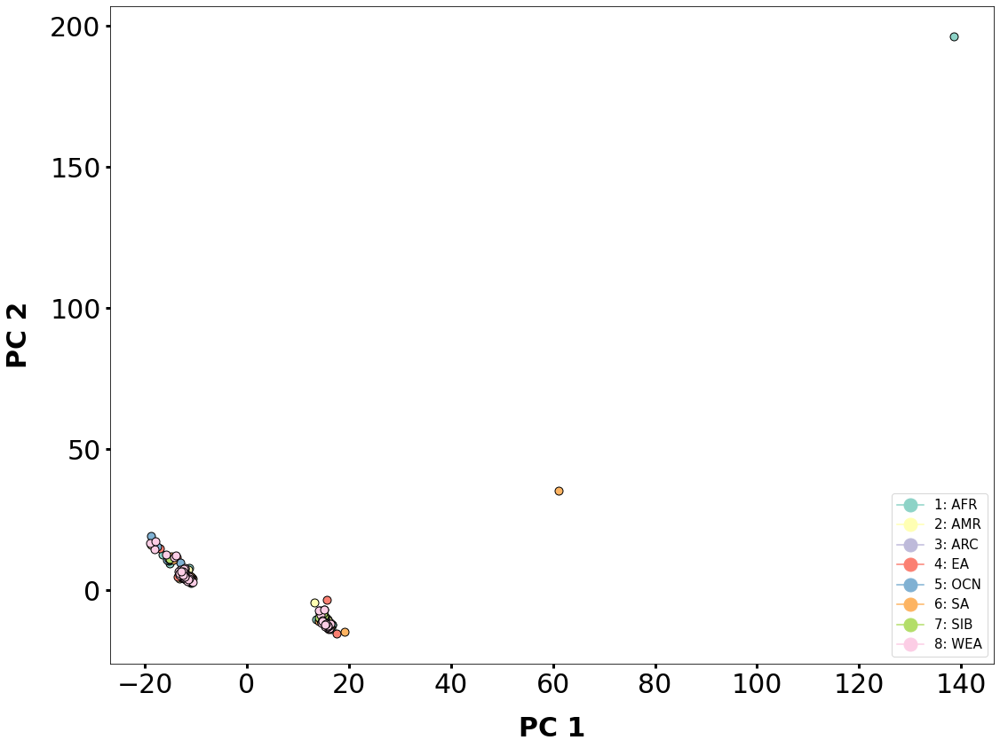

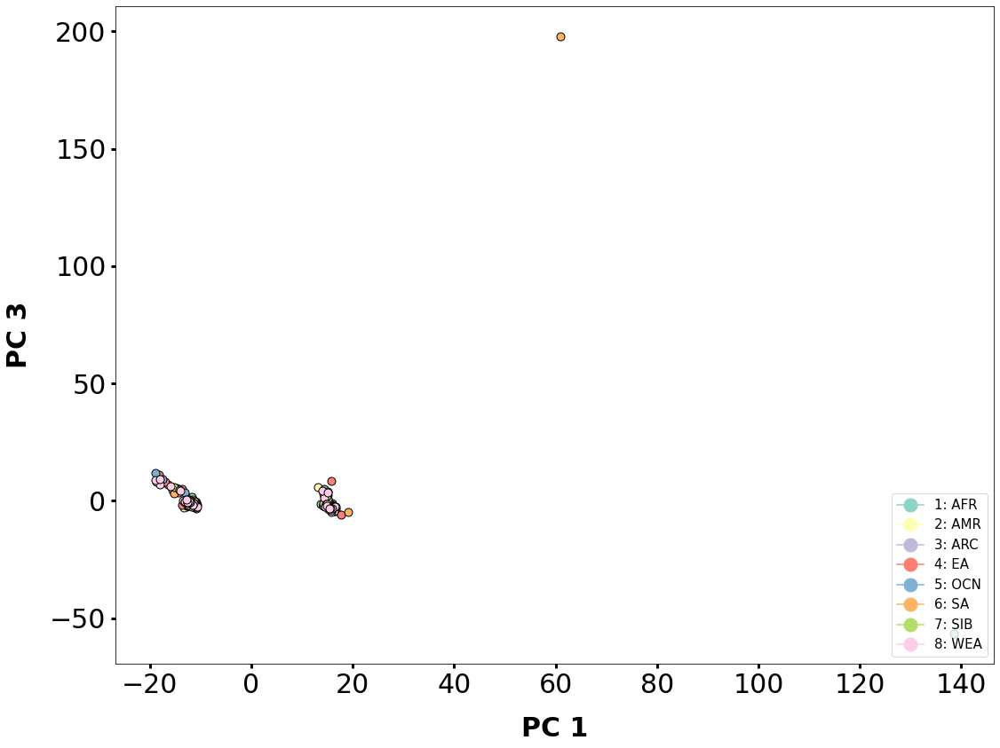

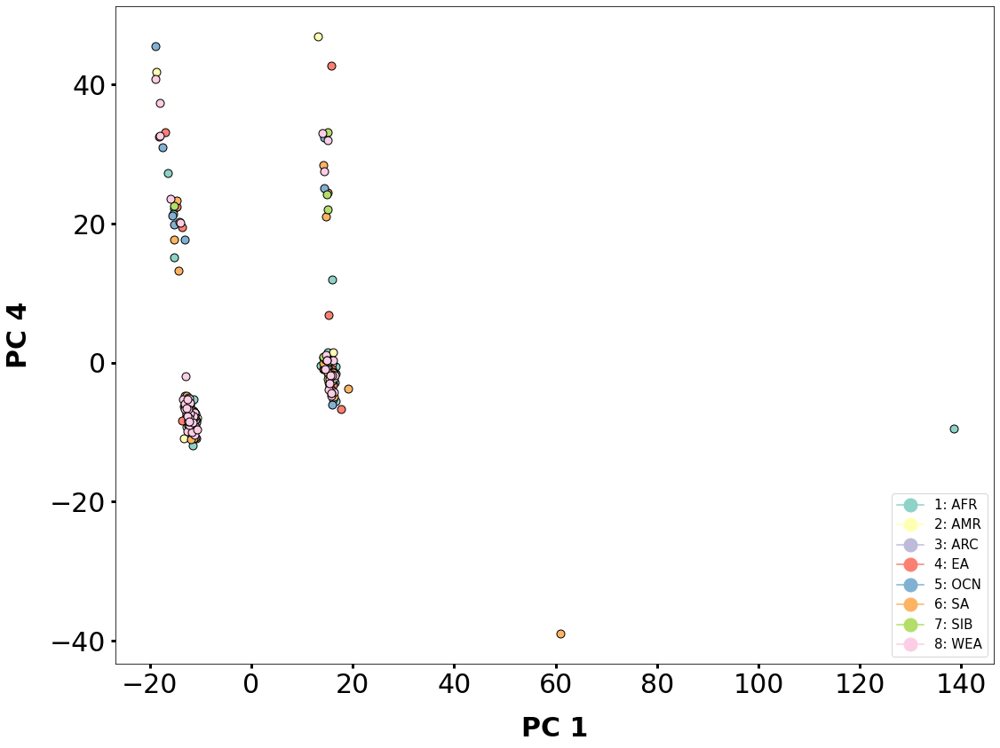

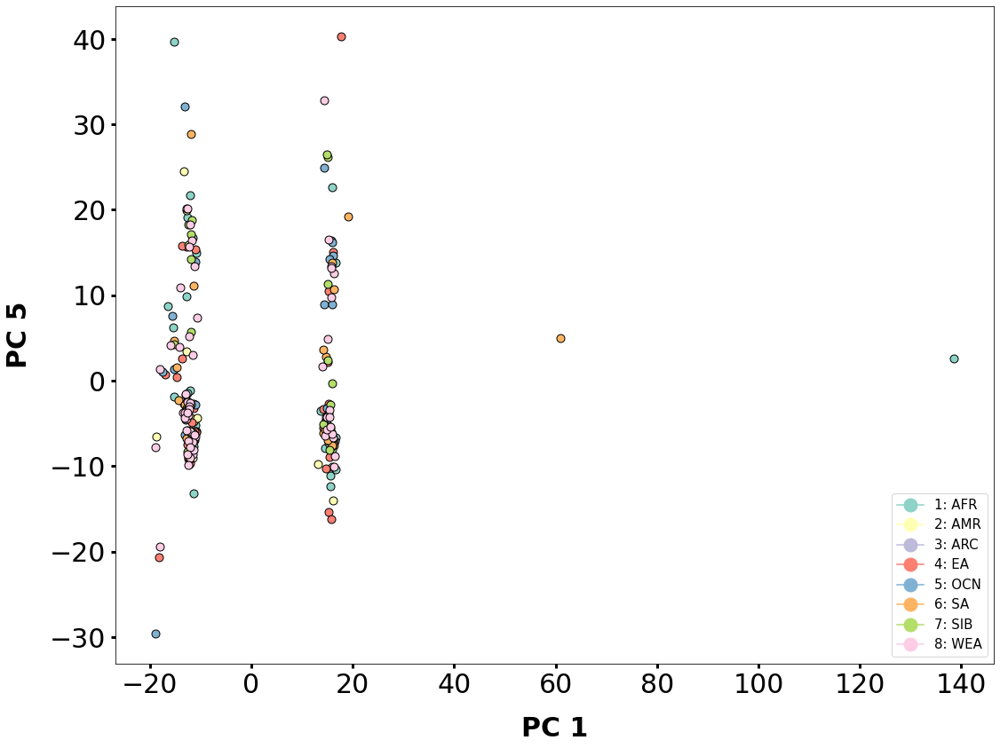

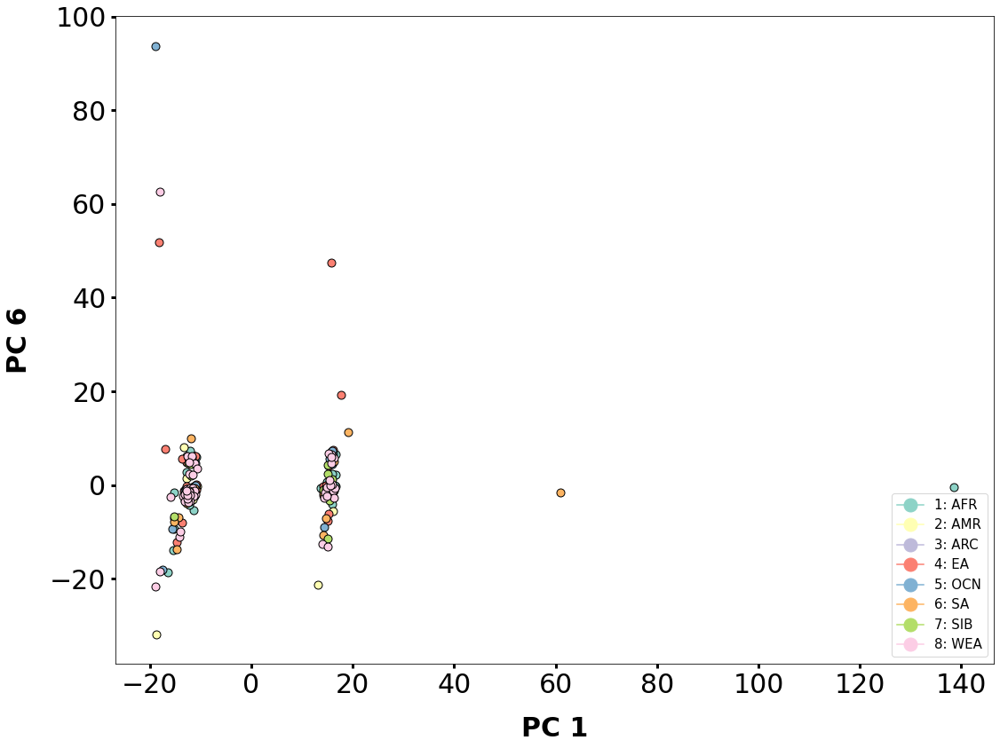

...

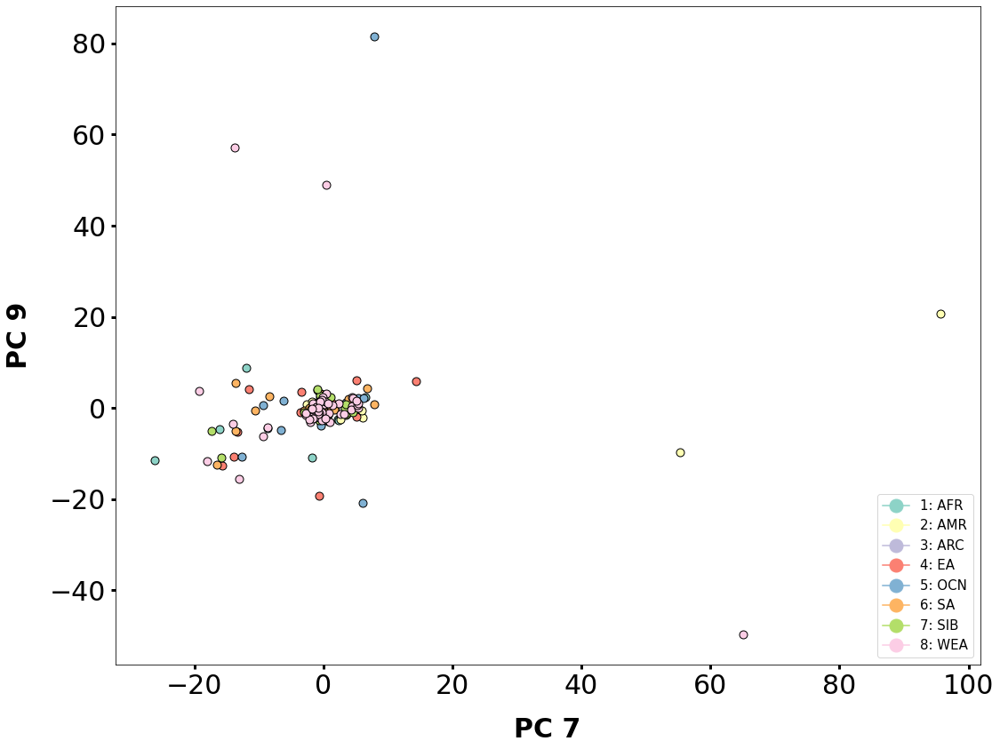

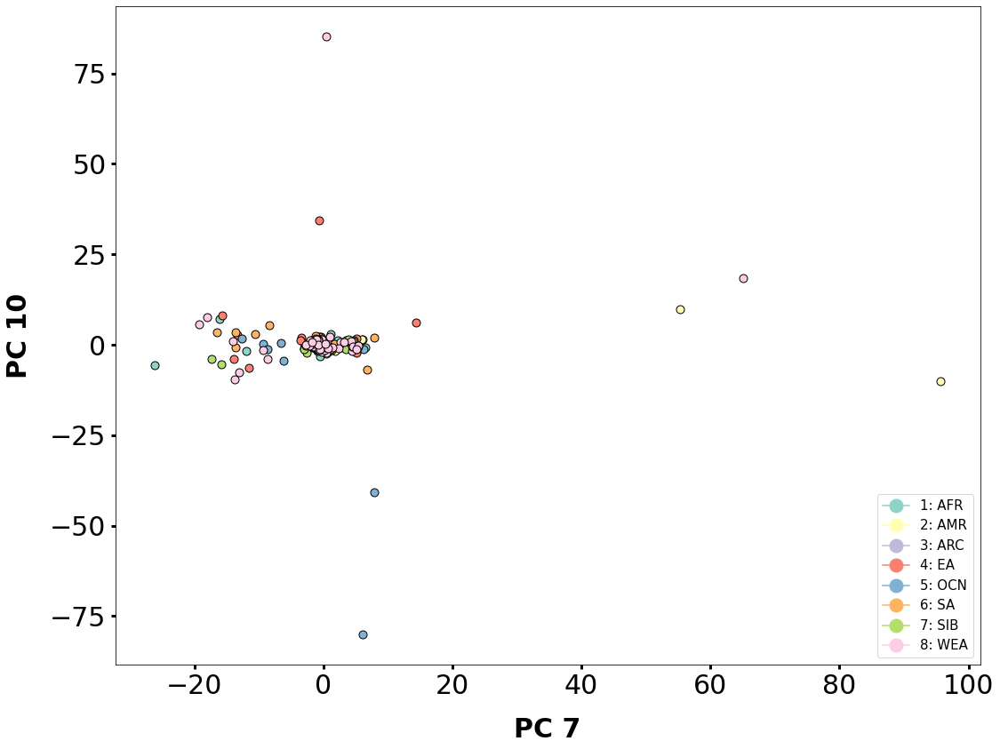

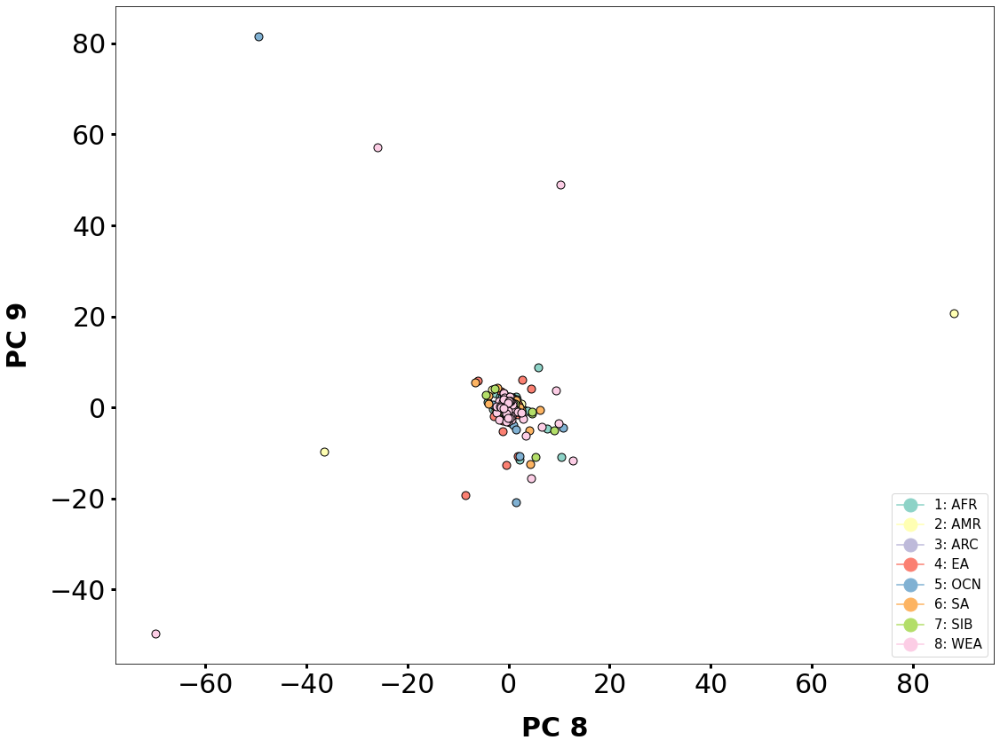

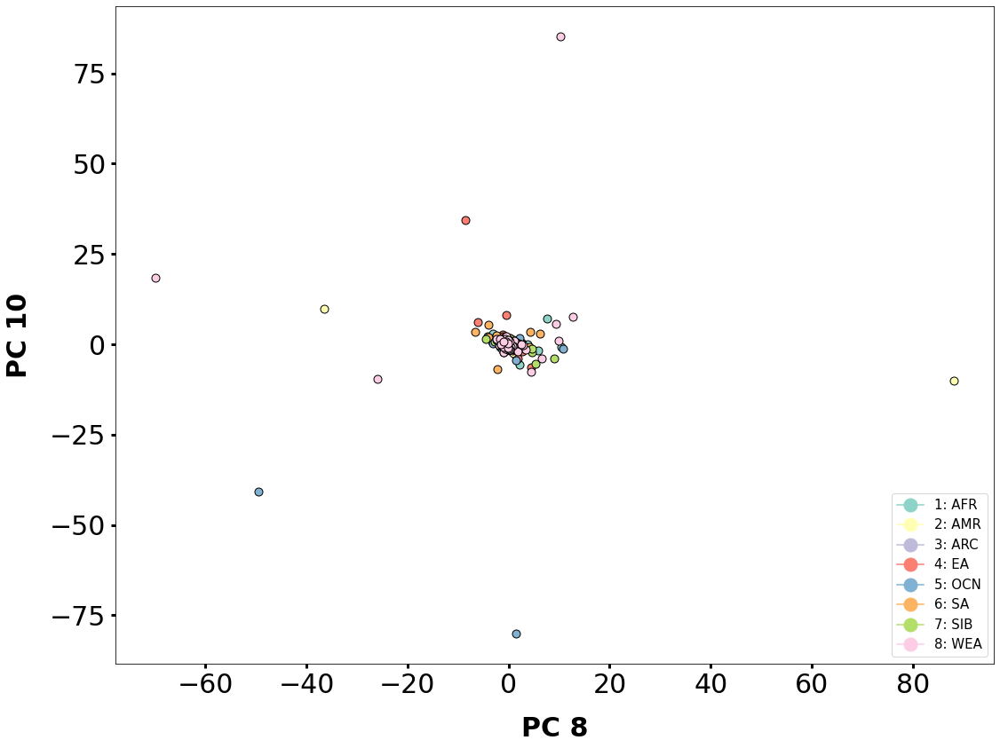

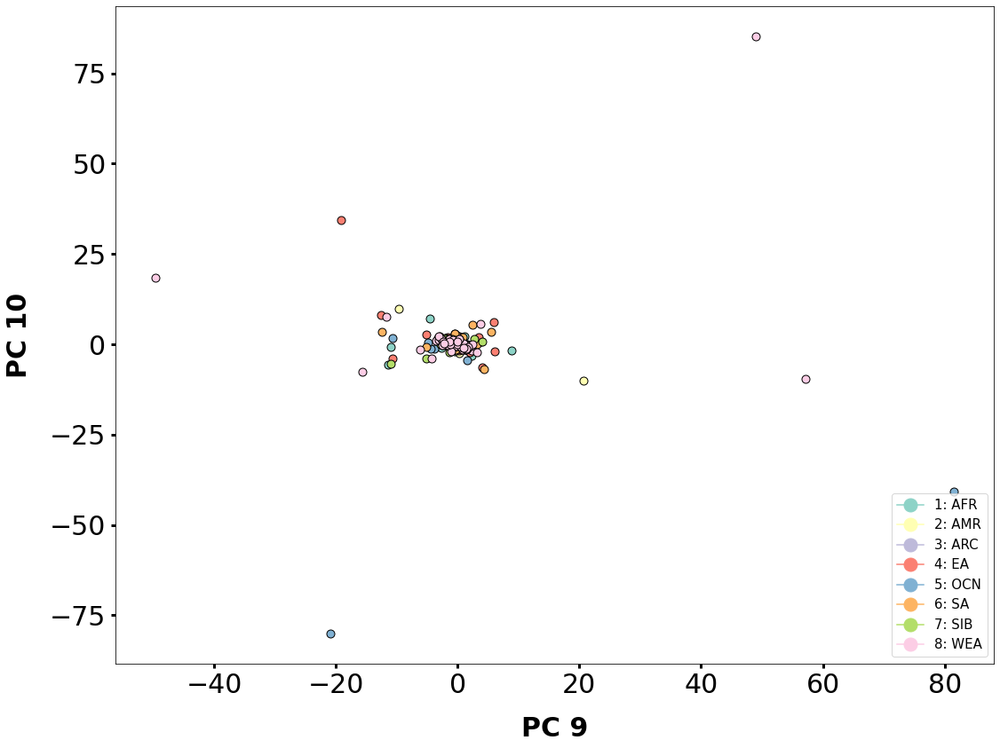

In [75]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [76]:
pca.explained_variance_ratio_

array([0.0387742 , 0.03352161, 0.02491608, 0.02211083, 0.0155481 ,
       0.0140675 , 0.01288101, 0.01052222, 0.01024145, 0.01007717])

In [115]:
hg_anotation = pd.read_csv('/branchinecta/jbazanwilliamson/archaic_cnv_anotation.csv', index_col=2)

anotation_for_hg = pd.read_csv('/branchinecta/jbazanwilliamson/SGDP_anotation.csv', sep=',', encoding='latin-1', index_col=0)
new_anotation = anotation_for_hg.merge(hg_anotation, left_index=True, right_index=True)
#new_anotation = new_anotation.set_index("3-Illumina_ID")
new_anotation = new_anotation.set_index("Sample")

new_anotation = new_anotation.merge(archaic_anotation.set_index("Sample_ID"), left_index=True, right_index=True)
new_anotation = new_anotation.set_index("3-Illumina_ID")
new_anotation


,4-reich_id,5-ena_ftp_bam_ptr,6-Sequencing_Panel,7-Gender,8-Population_ID,9-Contributor,10-Region,11-Country,12-Town,13-Latitude,14-Longitude,15-DNA_Source,16-BioSamples Accession,17-Embargo,Sex_x,Population_code,Region,Country,Sex_y
3-Illumina_ID,,,,,,,,,,,,,,,,,,,
LP6005677-DNA_B01,S_Albanian-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324400/LP6005...,C,F,Albanian,David Comas,WestEurasia,Albania,Tirana,41.30,19.80,Genomic_from_blood,SAMEA3302780,FullyPublic,female,Albanian,EUR,Albanian,NaN
LP6005443-DNA_D05,S_Tlingit-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324311/LP6005...,C,F,Tlingit,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302889,FullyPublic,female,Tlingit,SIB,TlingitNikolskoye,F
LP6005443-DNA_H02,S_Aleut-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324343/LP6005...,C,F,Aleut,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302642,FullyPublic,female,Aleut,SIB,AleutBeringIsland,F
LP6005443-DNA_A03,S_Aleut-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324286/LP6005...,C,M,Aleut,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302773,FullyPublic,male,Aleut,SIB,AleutBeringIsland,M
LP6005443-DNA_E05,S_Tlingit-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324318/LP6005...,C,M,Tlingit,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Petropavlovsk-Kamchatski, Commander Islands",53.00,158.65,Genomic_from_blood,SAMEA3302853,FullyPublic,male,Tlingit,SIB,TlingitPreobrazhenskoye,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005443-DNA_H11,S_Mixtec-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324348/LP6005...,C,F,Mixtec,William Klitz / Cheryl Winkler,America,Mexico,?,17.00,-97.00,Genomic_from_cell_lines,SAMEA3302811,FullyPublic,female,Mixtec,AMR,Mixtec,F
LP6005443-DNA_E11,S_Mixe-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324324/LP6005...,C,F,Mixe,William Klitz / Cheryl Winkler,America,Mexico,"Tmazulapan, Mixe",16.95,-96.58,Genomic_from_cell_lines,SAMEA3302796,FullyPublic,female,Mixe,AMR,Mixe,F
LP6005443-DNA_F11,S_Mixe-3,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324333/LP6005...,C,F,Mixe,William Klitz / Cheryl Winkler,America,Mexico,"Tamazulapan, Mixe",16.95,-96.58,Genomic_from_cell_lines,SAMEA3302723,FullyPublic,female,Mixe,AMR,Mixe,F


In [116]:
samples_with_aberrations = list(new_anotation.index)

only_archaic_samples = qdnaseq_df[qdnaseq_df.Sample_ID.isin(samples_with_aberrations)]

only_archaic_samples



,Sample_ID,Chr,Start,End,SIZE,SCORE,RD,LENGHT
0,LP6005441-DNA_A01,1,228416,267160,3.0,duplication,2.089230,6900.0
1,LP6005441-DNA_A01,1,4120597,4131559,1.0,deletion,0.505571,3500.0
2,LP6005441-DNA_A01,1,13106780,13123007,1.0,deletion,0.096294,79500.0
3,LP6005441-DNA_A01,1,13121719,13124296,1.0,deletion,0.096294,79500.0
4,LP6005441-DNA_A01,1,13103107,13124296,1.0,deletion,0.096294,79500.0
...,...,...,...,...,...,...,...,...
285949,LP6005677-DNA_F01,22,21461146,21797656,3.0,duplication,1.709210,5700.0
285950,LP6005677-DNA_F01,22,21461146,21711330,3.0,duplication,1.709210,5700.0
285951,LP6005677-DNA_F01,22,21461146,21797656,3.0,duplication,1.772650,6000.0
285952,LP6005677-DNA_F01,22,21461146,21711330,3.0,duplication,1.772650,6000.0


In [117]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = only_archaic_samples[only_archaic_samples['SCORE'] == 'deletion'] 
duplications= only_archaic_samples[only_archaic_samples['SCORE'] == 'duplication'] 
duplications

,Sample_ID,Chr,Start,End,SIZE,SCORE,RD,LENGHT
0,LP6005441-DNA_A01,1,228416,267160,3.0,duplication,2.08923,6900.0
6,LP6005441-DNA_A01,1,16890214,17007784,3.0,duplication,3.66919,68800.0
7,LP6005441-DNA_A01,1,16894819,16971661,3.0,duplication,3.66919,68800.0
9,LP6005441-DNA_A01,1,16875428,16971661,3.0,duplication,3.66919,68800.0
11,LP6005441-DNA_A01,1,16971661,17007784,3.0,duplication,3.66919,68800.0
...,...,...,...,...,...,...,...,...
285948,LP6005677-DNA_F01,22,21461146,21711330,3.0,duplication,1.38959,4300.0
285949,LP6005677-DNA_F01,22,21461146,21797656,3.0,duplication,1.70921,5700.0
285950,LP6005677-DNA_F01,22,21461146,21711330,3.0,duplication,1.70921,5700.0
285951,LP6005677-DNA_F01,22,21461146,21797656,3.0,duplication,1.77265,6000.0


In [121]:
#change to df when using telomeres and centromeres filtration
final = only_archaic_samples.pivot_table(index=["Chr", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()

counts = final.iloc[:,3:284]
counts = counts.fillna(2)
#counts = np.log2(counts)
final


Sample_ID,Chr,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,LP6005592-DNA_D03,LP6005592-DNA_D04,LP6005592-DNA_E02,LP6005592-DNA_F03,LP6005592-DNA_G03,LP6005677-DNA_B01,LP6005677-DNA_D01,LP6005677-DNA_D03,LP6005677-DNA_E01,LP6005677-DNA_F01
0,1,228416,267160,2.089230,1.098060,0.011097,1.94512,NaN,1.263408,1.821840,...,1.781380,0.967651,NaN,NaN,NaN,0.031182,2.073090,1.72043,1.075480,NaN
1,1,521526,568203,0.187758,0.328217,0.089448,NaN,NaN,0.001990,0.314463,...,NaN,0.161749,0.220156,NaN,0.393846,NaN,0.087022,NaN,1.647480,NaN
2,1,563872,572534,NaN,NaN,NaN,NaN,NaN,0.646327,0.505381,...,NaN,NaN,0.688131,NaN,0.671011,NaN,NaN,NaN,NaN,NaN
3,1,982375,985198,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.661614,NaN,NaN,NaN
4,1,1009660,1015541,NaN,NaN,NaN,NaN,NaN,0.206298,NaN,...,0.302747,0.390800,NaN,NaN,NaN,NaN,NaN,NaN,0.314478,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3946,9,139710303,139717814,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.435520,NaN,NaN,NaN,NaN,NaN
3947,9,139912014,139914060,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.681583,NaN,NaN,NaN
3948,9,140181532,140191785,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3949,9,140382257,140388334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.375130,NaN,NaN,NaN,NaN,NaN


In [122]:
count = counts.T
features = new_anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country", "Region"]]
features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,Region,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005677-DNA_B01,F,WestEurasia,Albania,EUR,-3.709215,-0.935597,-1.429489,-2.799763,-1.468660,6.206956,-3.289806,1.974244,2.777681,0.132673
LP6005443-DNA_D05,F,CentralAsiaSiberia,Russia,SIB,-3.862632,-0.399006,-0.719015,-0.439623,-0.928286,0.613103,4.307326,-5.226572,-0.165270,2.732391
LP6005443-DNA_H02,F,CentralAsiaSiberia,Russia,SIB,-3.668457,-2.015278,1.906629,2.545695,-1.689486,-16.247040,-1.654068,2.044304,-1.059082,-12.732964
LP6005443-DNA_A03,M,CentralAsiaSiberia,Russia,SIB,-3.783455,-0.453993,-1.833239,-2.196214,0.223898,6.862717,-4.937469,-2.505228,5.729291,-0.253622
LP6005443-DNA_E05,M,CentralAsiaSiberia,Russia,SIB,-1.946471,-1.971455,-2.582256,-1.849127,-0.391155,11.887939,-13.700173,12.542814,-9.841333,-7.829484
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005443-DNA_H11,F,America,Mexico,AMR,-3.498428,-0.171017,-1.791487,-4.141996,-0.863011,8.656376,-3.923743,-1.374961,6.507116,-0.033075
LP6005443-DNA_E11,F,America,Mexico,AMR,-3.015157,-2.191030,-0.649907,-2.927709,-2.525761,-2.830755,5.732988,1.539790,-8.175111,-12.004758
LP6005443-DNA_F11,F,America,Mexico,AMR,-2.965910,2.000374,-2.683992,17.836471,3.600200,9.294373,4.851035,-13.183302,-5.176895,7.845379
LP6005443-DNA_A12,M,America,Mexico,AMR,-3.843463,-1.526848,-0.350831,-2.662805,-2.389453,-5.623593,3.322812,3.812175,-11.496492,-9.458429


       7-Gender           10-Region 11-Country  component_1  component_2  \
Region                                                                     
EUR           F         WestEurasia    Albania    -3.709215    -0.935597   
SIB           F  CentralAsiaSiberia     Russia    -3.862632    -0.399006   
SIB           F  CentralAsiaSiberia     Russia    -3.668457    -2.015278   
SIB           M  CentralAsiaSiberia     Russia    -3.783455    -0.453993   
SIB           M  CentralAsiaSiberia     Russia    -1.946471    -1.971455   
...         ...                 ...        ...          ...          ...   
AMR           F             America     Mexico    -3.498428    -0.171017   
AMR           F             America     Mexico    -3.015157    -2.191030   
AMR           F             America     Mexico    -2.965910     2.000374   
AMR           M             America     Mexico    -3.843463    -1.526848   
AMR           M             America     Mexico    -3.783886    -1.939350   

        com

Count of groups by factor: 8
       7-Gender           10-Region 11-Country  component_1  component_2  \
Region                                                                     
EUR           F         WestEurasia    Albania    -3.709215    -0.935597   
SIB           F  CentralAsiaSiberia     Russia    -3.862632    -0.399006   
SIB           F  CentralAsiaSiberia     Russia    -3.668457    -2.015278   
SIB           M  CentralAsiaSiberia     Russia    -3.783455    -0.453993   
SIB           M  CentralAsiaSiberia     Russia    -1.946471    -1.971455   
...         ...                 ...        ...          ...          ...   
AMR           F             America     Mexico    -3.498428    -0.171017   
AMR           F             America     Mexico    -3.015157    -2.191030   
AMR           F             America     Mexico    -2.965910     2.000374   
AMR           M             America     Mexico    -3.843463    -1.526848   
AMR           M             America     Mexico    -3.783886

       7-Gender           10-Region 11-Country  component_1  component_2  \
Region                                                                     
EUR           F         WestEurasia    Albania    -3.709215    -0.935597   
SIB           F  CentralAsiaSiberia     Russia    -3.862632    -0.399006   
SIB           F  CentralAsiaSiberia     Russia    -3.668457    -2.015278   
SIB           M  CentralAsiaSiberia     Russia    -3.783455    -0.453993   
SIB           M  CentralAsiaSiberia     Russia    -1.946471    -1.971455   
...         ...                 ...        ...          ...          ...   
AMR           F             America     Mexico    -3.498428    -0.171017   
AMR           F             America     Mexico    -3.015157    -2.191030   
AMR           F             America     Mexico    -2.965910     2.000374   
AMR           M             America     Mexico    -3.843463    -1.526848   
AMR           M             America     Mexico    -3.783886    -1.939350   

        com

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


       7-Gender           10-Region 11-Country  component_1  component_2  \
Region                                                                     
EUR           F         WestEurasia    Albania    -3.709215    -0.935597   
SIB           F  CentralAsiaSiberia     Russia    -3.862632    -0.399006   
SIB           F  CentralAsiaSiberia     Russia    -3.668457    -2.015278   
SIB           M  CentralAsiaSiberia     Russia    -3.783455    -0.453993   
SIB           M  CentralAsiaSiberia     Russia    -1.946471    -1.971455   
...         ...                 ...        ...          ...          ...   
AMR           F             America     Mexico    -3.498428    -0.171017   
AMR           F             America     Mexico    -3.015157    -2.191030   
AMR           F             America     Mexico    -2.965910     2.000374   
AMR           M             America     Mexico    -3.843463    -1.526848   
AMR           M             America     Mexico    -3.783886    -1.939350   

        com

       7-Gender           10-Region 11-Country  component_1  component_2  \
Region                                                                     
EUR           F         WestEurasia    Albania    -3.709215    -0.935597   
SIB           F  CentralAsiaSiberia     Russia    -3.862632    -0.399006   
SIB           F  CentralAsiaSiberia     Russia    -3.668457    -2.015278   
SIB           M  CentralAsiaSiberia     Russia    -3.783455    -0.453993   
SIB           M  CentralAsiaSiberia     Russia    -1.946471    -1.971455   
...         ...                 ...        ...          ...          ...   
AMR           F             America     Mexico    -3.498428    -0.171017   
AMR           F             America     Mexico    -3.015157    -2.191030   
AMR           F             America     Mexico    -2.965910     2.000374   
AMR           M             America     Mexico    -3.843463    -1.526848   
AMR           M             America     Mexico    -3.783886    -1.939350   

        com

       7-Gender           10-Region 11-Country  component_1  component_2  \
Region                                                                     
EUR           F         WestEurasia    Albania    -3.709215    -0.935597   
SIB           F  CentralAsiaSiberia     Russia    -3.862632    -0.399006   
SIB           F  CentralAsiaSiberia     Russia    -3.668457    -2.015278   
SIB           M  CentralAsiaSiberia     Russia    -3.783455    -0.453993   
SIB           M  CentralAsiaSiberia     Russia    -1.946471    -1.971455   
...         ...                 ...        ...          ...          ...   
AMR           F             America     Mexico    -3.498428    -0.171017   
AMR           F             America     Mexico    -3.015157    -2.191030   
AMR           F             America     Mexico    -2.965910     2.000374   
AMR           M             America     Mexico    -3.843463    -1.526848   
AMR           M             America     Mexico    -3.783886    -1.939350   

        com

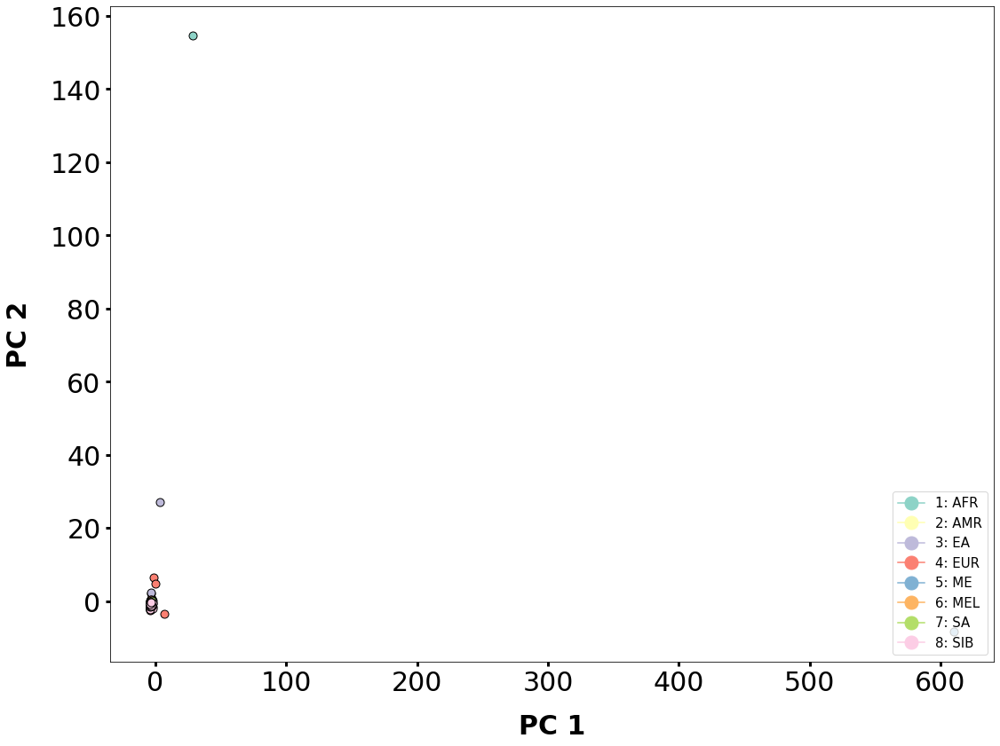

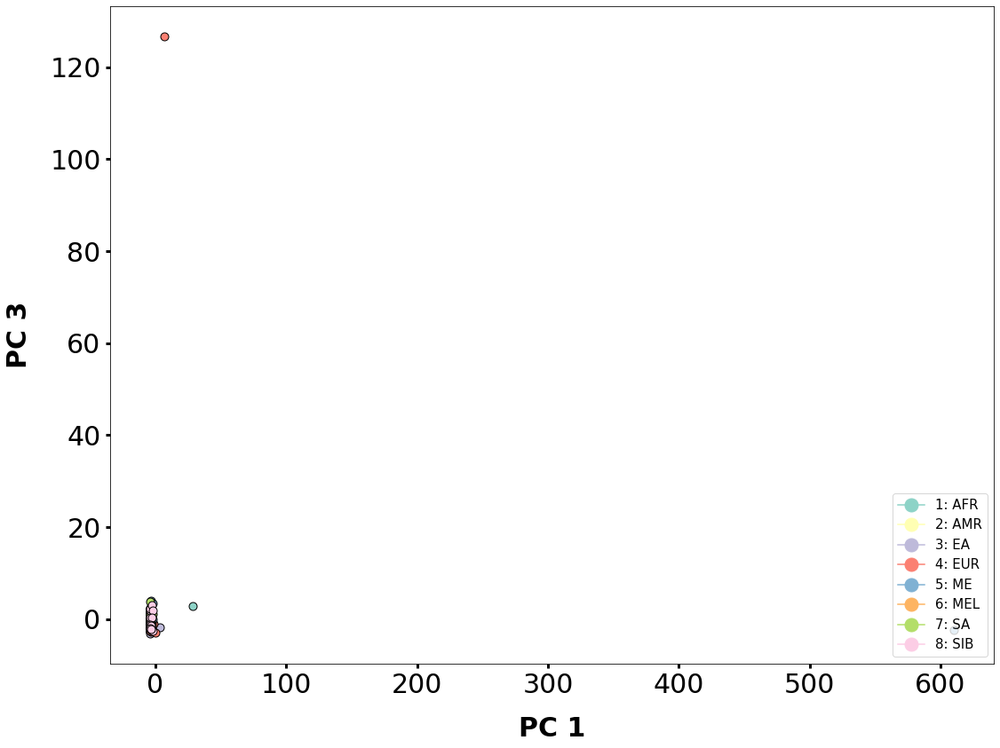

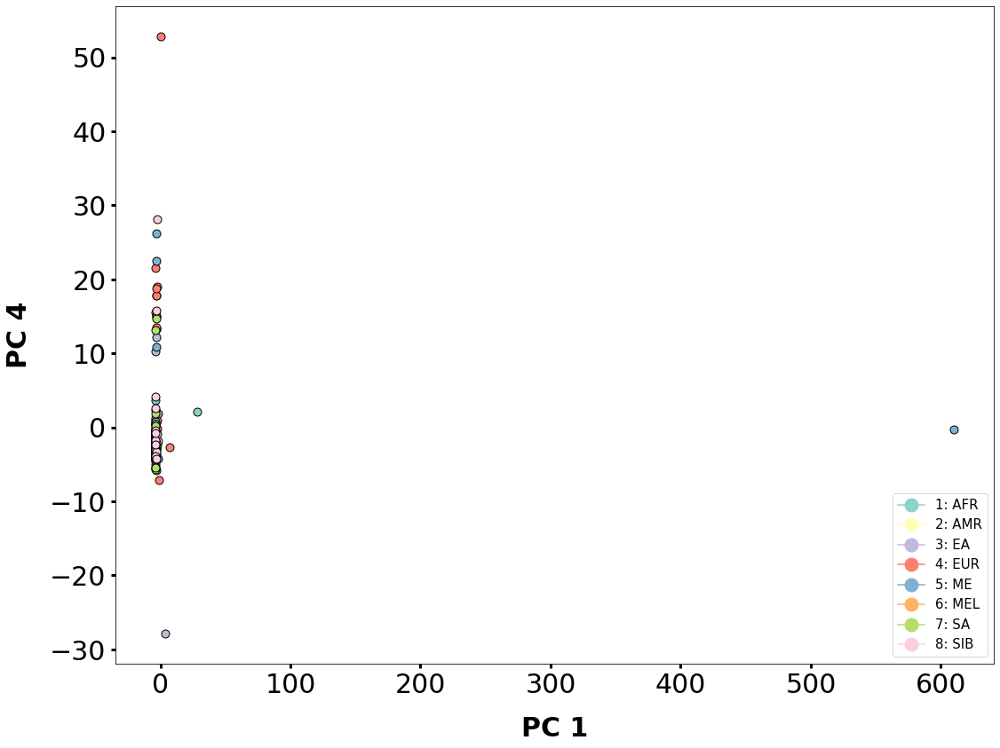

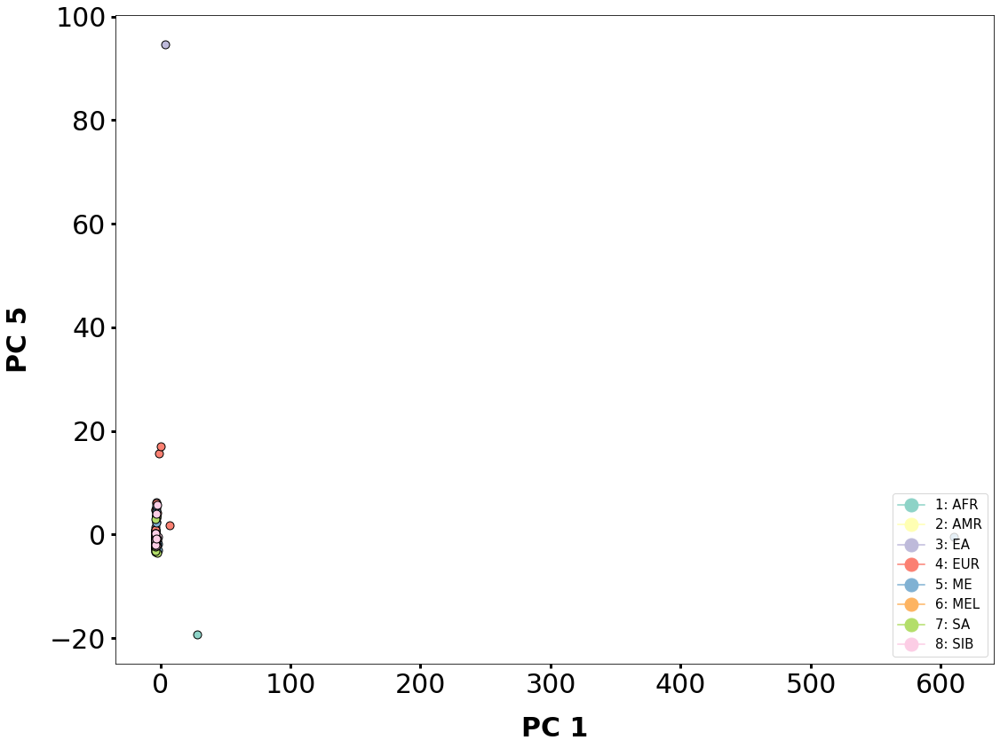

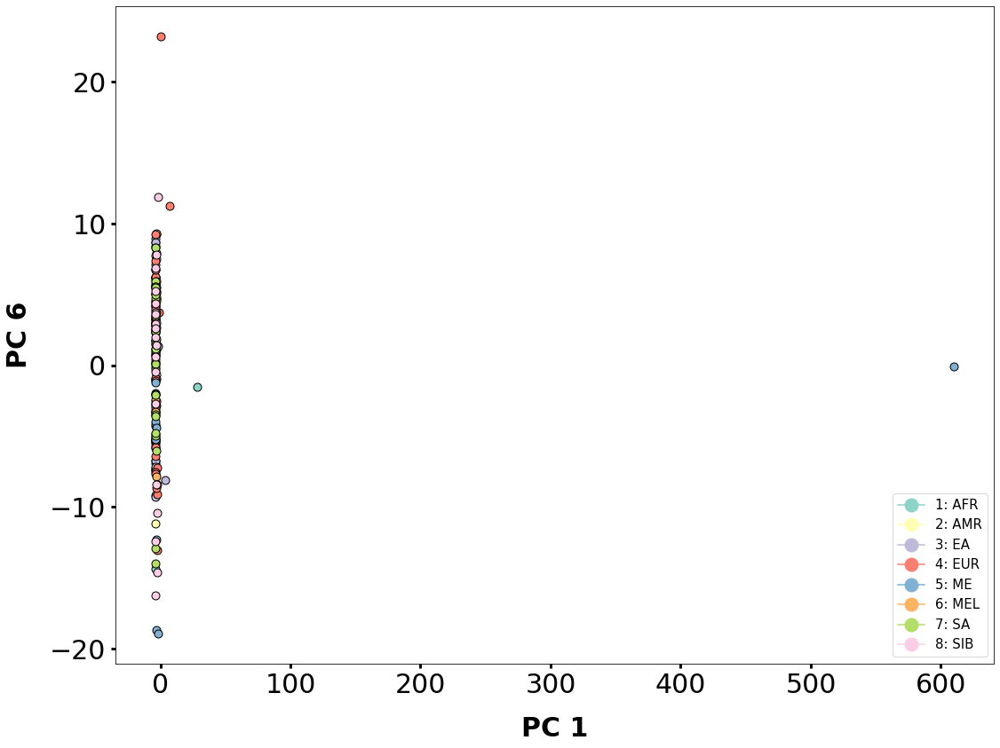

...

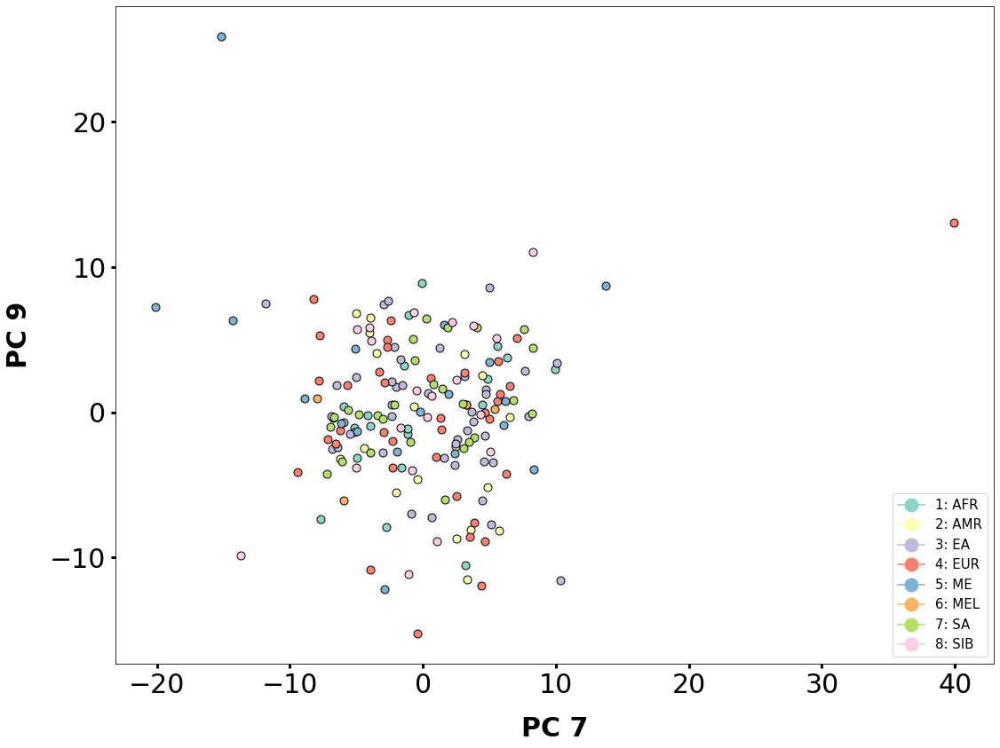

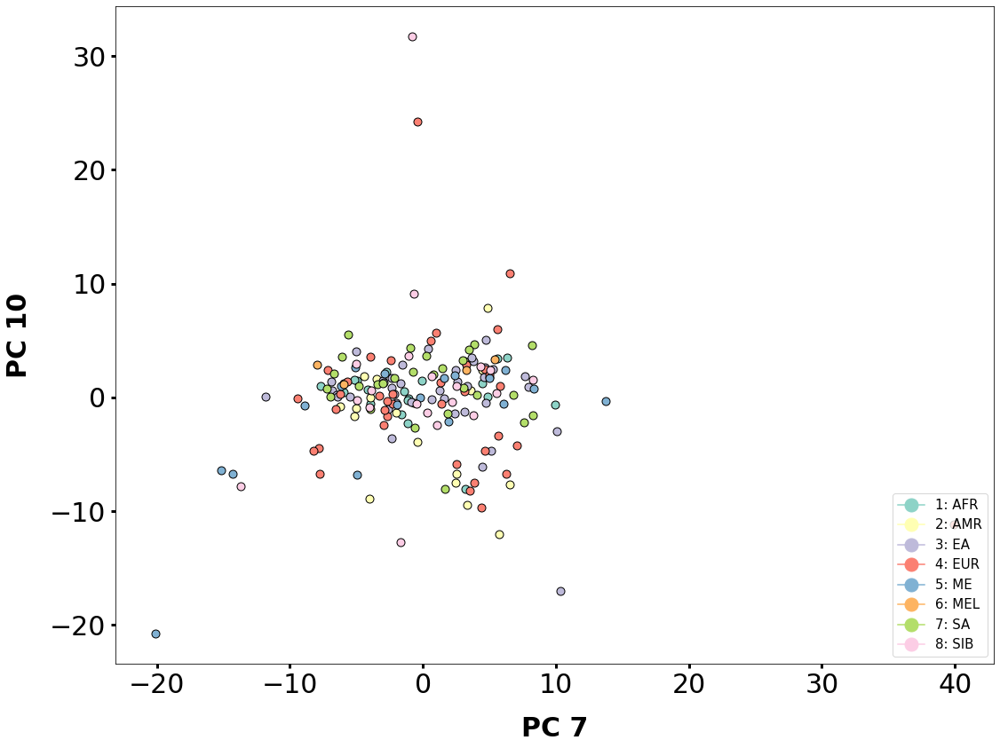

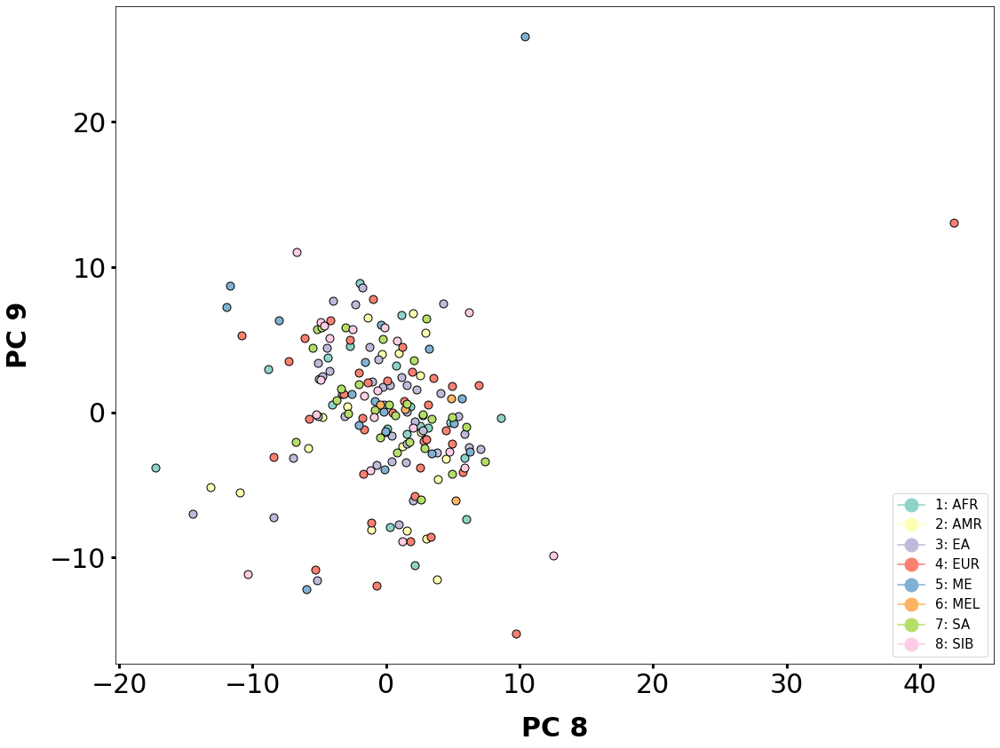

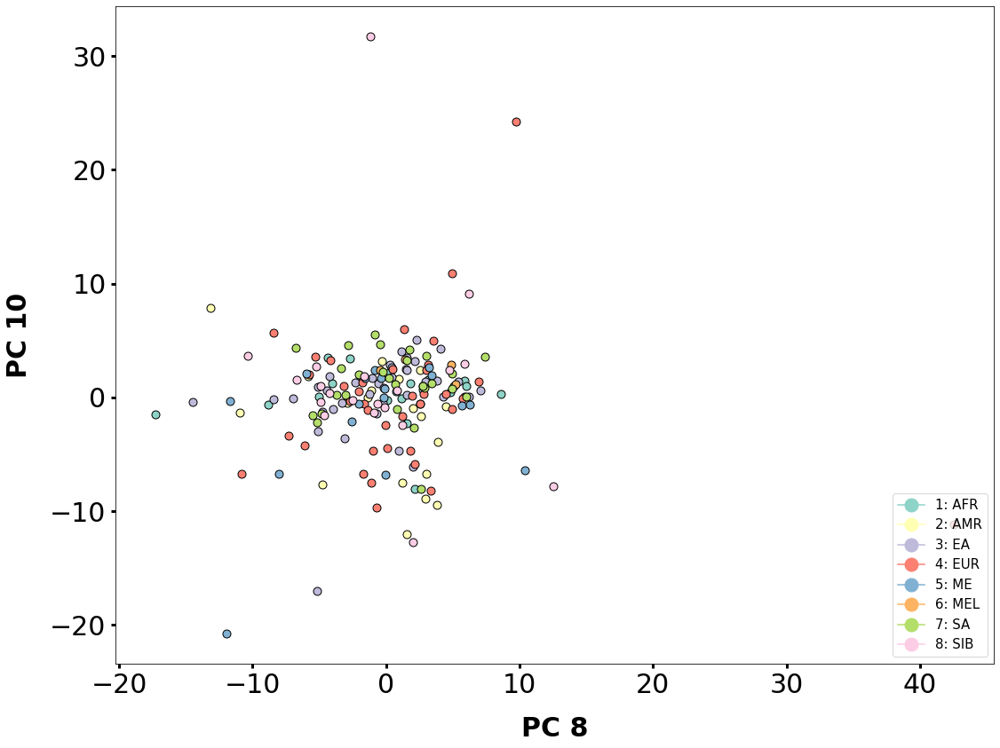

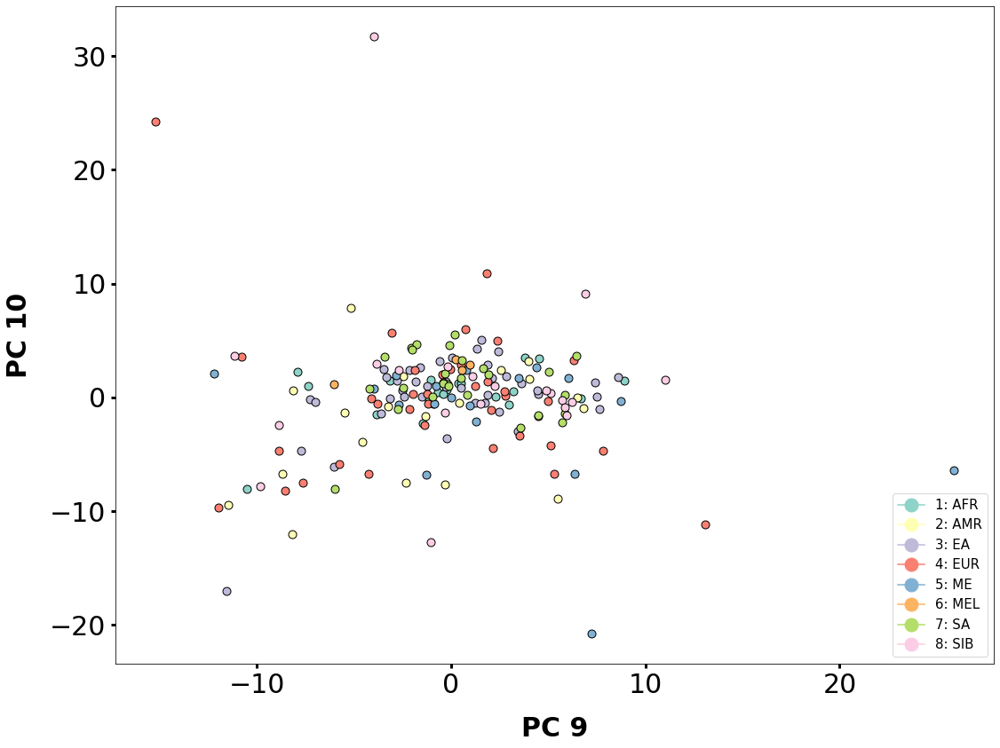

In [123]:

components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [124]:
archaic_anotation

,Region,Country,Sample_ID,Sex
Sample,,,,
AFR_BantuKenya_HGDP01414_F,AFR,BantuKenya,HGDP01414,F
AFR_BantuKenya_HGDP01417_M,AFR,BantuKenya,HGDP01417,M
AFR_BantuSEHerero_HGDP01028_M,AFR,BantuSEHerero,HGDP01028,M
AFR_BantuSEHerero_HGDP01035_M,AFR,BantuSEHerero,HGDP01035,M
AFR_BantuSETswana_HGDP01030_M,AFR,BantuSETswana,HGDP01030,M
...,...,...,...,...
SIB_Tubalar_Tuba9_F,SIB,Tubalar,Tuba9,F
SIB_Ulchi_Ul31_F,SIB,Ulchi,Ul31,F
SIB_Ulchi_Ul5_F,SIB,Ulchi,Ul5,F


In [63]:

def plot_scatter_cluster(
data=None,
abscissa=None,
ordinate=None,
label_horizontal=None,
label_vertical=None,
factor=None,
fonts=None,
colors=None,
legend=None,
):
    """
    Creates a figure of a chart of type histogram to represent the frequency
    distribution of a single series of values.
    arguments:
        data (object): Pandas data frame of groups, series, and values
        abscissa (str): name of data column with independent variable
        ordinate (str): name of data column with dependent variable
        label_horizontal (str): label for horizontal axis
        label_vertical (str): label for vertical axis
        factor (str): name of data column with groups or factors of samples
        fonts (dict<object>): references to definitions of font properties
        colors (dict<tuple>): references to definitions of color properties
        legend (bool): whether to include a legend for series on the chart
    raises:
    returns:
        (object): figure object
    """
##########
# Organize data.
# Separate points by groups.
# Define groups.
    data = data.copy(deep=True)
    data.set_index(
        factor,
append=False,
drop=True,
inplace=True
    )
    print(data)
    groups = data.groupby(level=[factor])
    print("Count of groups by factor: " + str(len(groups)))
    colors_series = list(seaborn.color_palette("Set3", n_colors=len(groups)))
##########
# Create figure.
    figure = matplotlib.pyplot.figure(
    figsize=(15.748, 11.811),
    tight_layout=True
    )
# Create axes.
    axes = matplotlib.pyplot.axes()
    axes.set_xlabel(
    xlabel=label_horizontal,
labelpad=20,
alpha=1.0,
backgroundcolor=colors["white"],
color=colors["black"],
fontproperties=fonts["properties"]["one"]
    )
    axes.set_ylabel(
        ylabel=label_vertical,
        labelpad=20,
        alpha=1.0,
        backgroundcolor=colors["white"],
        color=colors["black"],
        fontproperties=fonts["properties"]["one"]
    )
    axes.tick_params(
        axis="both",
        which="both",
        direction="out",
        length=5.0,
        width=3.0,
        color=colors["black"],
        pad=5,
        labelsize=fonts["values"]["one"]["size"],
        labelcolor=colors["black"]
    )
# Plot points for values from each group.
    index = 0
    for name, group in groups:
        values_x = group[abscissa].to_list()
        values_y = group[ordinate].to_list()
        handle = axes.plot(
            values_x,
            values_y,
linestyle="",
marker="o",
markersize=9,
markeredgecolor=colors["black"],#colors_series[index],
markerfacecolor=colors_series[index]
        )
        index += 1
        pass
# Plot labels for each group.
    labels = []
    index = 0
    for name, group in groups:
        values_x = group[abscissa].to_list()
        mean_x = statistics.median(values_x)
        values_y = group[ordinate].to_list()
        mean_y = statistics.median(values_y)
#        axes.text(
#            mean_x,
#            mean_y,
#str(index+1),
#backgroundcolor=colors["white_faint"],
#color=colors["black"],
#fontproperties=fonts["properties"]["three"],
#horizontalalignment="center",
#verticalalignment="center"
#        )
        label = str(index+1) + ": " + name
        labels.append(label)
        index += 1
        pass
# Create legend.
# Create custome elements for the legend
    elements = create_legend_elements(
colors=colors_series,
labels=labels
    )
    axes.legend(
handles=elements,
loc="lower right",
prop=fonts["properties"]["four"],
    )
    return figure


def define_font_properties():
    """
    Defines font properties.
    arguments:
    raises:
    returns:
        (dict<object>): references to definitions of font properties
    """
# Define font values.
    values_one = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 1000,
"weight": 1000,
"size": 30
    }
    values_two = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 500,
"weight": 1000,
"size": 25
    }
    values_three = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 500,
"weight": 1000,
"size": 20
    }
    values_four = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 500,
"weight": 500,
"size": 15
    }
# Define font properties.
    properties_one = matplotlib.font_manager.FontProperties(
family=values_one["family"],
style=values_one["style"],
variant=values_one["variant"],
stretch=values_one["stretch"],
weight=values_one["weight"],
size=values_one["size"]
    )
    properties_two = matplotlib.font_manager.FontProperties(
family=values_two["family"],
style=values_two["style"],
variant=values_two["variant"],
stretch=values_two["stretch"],
weight=values_two["weight"],
size=values_two["size"]
    )
    properties_three = matplotlib.font_manager.FontProperties(
family=values_three["family"],
style=values_three["style"],
variant=values_three["variant"],
stretch=values_three["stretch"],
weight=values_three["weight"],
size=values_three["size"]
    )
    properties_four = matplotlib.font_manager.FontProperties(
family=values_four["family"],
style=values_four["style"],
variant=values_four["variant"],
stretch=values_four["stretch"],
weight=values_four["weight"],
size=values_four["size"]
    )
# Compile and return references.
    return {
"values": {
"one": values_one,
"two": values_two,
"three": values_three,
"four": values_four
        },
"properties": {
"one": properties_one,
"two": properties_two,
"three": properties_three,
"four": properties_four
        }
    }



def define_color_properties():
    """
    Defines color properties.
    arguments:
    raises:
    returns:
        (dict<tuple>): references to definitions of color properties
    """
# Black.
    black = (0.0, 0.0, 0.0, 1.0)
# White.
    white = (1.0, 1.0, 1.0, 1.0)
    white_faint = (1.0, 1.0, 1.0, 0.75)
# Blue.
    blue = (0.0, 0.2, 0.5, 1.0)
    blue_faint = (0.0, 0.2, 0.5, 0.75)
# Orange.
    orange = (1.0, 0.6, 0.2, 1.0)
    orange_faint = (1.0, 0.6, 0.2, 0.75)
# Compile and return references.
    return {
"black": black,
"white": white,
"white_faint": white_faint,
"blue": blue,
"blue_faint": blue_faint,
"orange": orange,
"orange_faint": orange_faint
    }


def create_legend_elements(
colors=None,
labels=None,
):
    """
    Creates custom elements for legend.
    arguments:
        colors (list<dict>): colors
        labels (str): name of data column with independent variable
    raises:
    returns:
        (list<object>): elements for legend
    """
    elements = []
    for index in range(len(labels)):
        element = matplotlib.lines.Line2D(
            [0],
            [0],
            marker="o",
            color=colors[index],
            label=labels[index],
            markerfacecolor=colors[index],
            markersize=15,
        )
        elements.append(element)
    return elements






